# PREDICTING THE SUITABLE CROP BY USING MACHINE LEARNING ALGORITHMS

## IMPORTING NECESSARY LIBRARIES

In [1]:
import numpy as np 
import pandas as pd
# Set Pandas display options
#pd.set_option('display.max_rows', None) //Makes the entire dataset visible in case of large dataset
#pd.set_option('display.max_columns', None)
# For Visualization
import seaborn as sns
import matplotlib.pyplot as plt

import warnings
def warns(*args,**kwargs): pass
warnings.warn=warns

## READING THE DATASET FROM A COMMA SEPARATED VALUES FILE


In [2]:
df = pd.read_csv('Crop_recommendation.csv')
print('Data Shape: ', df.shape)
df.sample(10)

Data Shape:  (2200, 8)


,N,P,K,temperature,humidity,ph,rainfall,label
447,28,59,22,30.906078,52.799130,7.051816,170.991983,pigeonpeas
1437,120,8,46,29.556575,90.709373,6.732834,28.365356,muskmelon
1938,111,53,19,23.964360,78.027631,6.419537,84.631489,cotton
100,71,54,16,22.613600,63.690706,5.749914,87.759539,maize
1713,56,57,48,31.562138,93.048486,6.506121,63.622508,papaya
1900,133,47,24,24.402289,79.197320,7.231325,90.802236,cotton
736,21,78,19,27.161591,66.760172,6.920090,69.851123,blackgram
1667,36,29,13,20.681852,90.915105,7.829507,109.751393,orange
1790,51,57,55,24.705284,90.147322,6.676407,108.410316,papaya
1177,40,16,35,31.893563,49.024501,6.484152,89.593715,mango


## DATATYPES OF ALL THE COLUMNS

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2200 entries, 0 to 2199
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   N            2200 non-null   int64  
 1   P            2200 non-null   int64  
 2   K            2200 non-null   int64  
 3   temperature  2200 non-null   float64
 4   humidity     2200 non-null   float64
 5   ph           2200 non-null   float64
 6   rainfall     2200 non-null   float64
 7   label        2200 non-null   object 
dtypes: float64(4), int64(3), object(1)
memory usage: 137.6+ KB


## CHECKING FOR MISSING (NaN) VALUES IN THE DATASET

In [4]:
df.isnull().sum()

N              0
P              0
K              0
temperature    0
humidity       0
ph             0
rainfall       0
label          0
dtype: int64

## SUMMARY OF STATISTICS

In [5]:
df.describe()

,N,P,K,temperature,humidity,ph,rainfall
count,2200.000000,2200.000000,2200.000000,2200.000000,2200.000000,2200.000000,2200.000000
mean,50.551818,53.362727,48.149091,25.616244,71.481779,6.469480,103.463655
std,36.917334,32.985883,50.647931,5.063749,22.263812,0.773938,54.958389
min,0.000000,5.000000,5.000000,8.825675,14.258040,3.504752,20.211267
25%,21.000000,28.000000,20.000000,22.769375,60.261953,5.971693,64.551686
50%,37.000000,51.000000,32.000000,25.598693,80.473146,6.425045,94.867624
75%,84.250000,68.000000,49.000000,28.561654,89.948771,6.923643,124.267508
max,140.000000,145.000000,205.000000,43.675493,99.981876,9.935091,298.560117


## CHECKING FOR DUPLICATE VALUES

In [6]:
df.duplicated().sum()

0

## UNIQUE CROP LABELS

In [7]:
crops = df['label'].unique()
crops.sort()
num_indices = range(1, len(crops) + 1)  # Create a range of numbers from 1 to the number of unique crops

print("Total Number of Crops:", len(crops))
print("\n", "-"*20, " List of Crops ", "-"*20)

# Iterate through the crops and their numerical indices
for i, crop in zip(num_indices, crops):
    print(f"{i}. {crop}")


Total Number of Crops: 22

 --------------------  List of Crops  --------------------
1. apple
2. banana
3. blackgram
4. chickpea
5. coconut
6. coffee
7. cotton
8. grapes
9. jute
10. kidneybeans
11. lentil
12. maize
13. mango
14. mothbeans
15. mungbean
16. muskmelon
17. orange
18. papaya
19. pigeonpeas
20. pomegranate
21. rice
22. watermelon


## NUMBER OF ROWS AGAINST EACH CROP

In [8]:
print("Number of Records Against Eash Crop")
print("-"*35)
print(df['label'].value_counts() )

Number of Records Against Eash Crop
-----------------------------------
label
rice           100
maize          100
jute           100
cotton         100
coconut        100
papaya         100
orange         100
apple          100
muskmelon      100
watermelon     100
grapes         100
mango          100
banana         100
pomegranate    100
lentil         100
blackgram      100
mungbean       100
mothbeans      100
pigeonpeas     100
kidneybeans    100
chickpea       100
coffee         100
Name: count, dtype: int64


## COLUMN NAMES

In [9]:
print(df.columns)

Index(['N', 'P', 'K', 'temperature', 'humidity', 'ph', 'rainfall', 'label'], dtype='object')


## FEATURES SELECTION

In [3]:
selected_features = ['N', 'P', 'K', 'temperature', 'humidity', 'ph', 'rainfall']
selected_features

['N', 'P', 'K', 'temperature', 'humidity', 'ph', 'rainfall']

## CORRELATION MATRICES

In [11]:
numeric_columns = df.select_dtypes(include=[np.number])
# Rank the data
ranked_data = numeric_columns.rank()
# Calculate Spearman's correlation
corr_spearman = ranked_data.corr(method='spearman')
# Calculate Pearson correlation
corr_pearson = numeric_columns.corr(method='pearson')
# Calculate Kendall's Tau correlation
corr_kendall = ranked_data.corr(method='kendall')

### NUMERIC COLUMNS

In [12]:
numeric_columns

,N,P,K,temperature,humidity,ph,rainfall
0,90,42,43,20.879744,82.002744,6.502985,202.935536
1,85,58,41,21.770462,80.319644,7.038096,226.655537
2,60,55,44,23.004459,82.320763,7.840207,263.964248
3,74,35,40,26.491096,80.158363,6.980401,242.864034
4,78,42,42,20.130175,81.604873,7.628473,262.717340
...,...,...,...,...,...,...,...
2195,107,34,32,26.774637,66.413269,6.780064,177.774507
2196,99,15,27,27.417112,56.636362,6.086922,127.924610
2197,118,33,30,24.131797,67.225123,6.362608,173.322839
2198,117,32,34,26.272418,52.127394,6.758793,127.175293


### RANKED DATA

In [13]:
ranked_data

,N,P,K,temperature,humidity,ph,rainfall
0,1739.0,879.5,1434.0,362.0,1235.0,1212.0,2075.0
1,1658.0,1337.5,1377.0,438.0,1086.0,1754.0,2129.0
2,1383.0,1203.5,1463.0,584.0,1263.0,2118.0,2175.0
3,1511.5,667.0,1349.5,1280.0,1068.0,1711.0,2154.0
4,1552.5,879.5,1404.5,308.0,1202.0,2056.0,2172.0
...,...,...,...,...,...,...,...
2195,1985.0,646.0,1104.0,1329.0,764.0,1524.0,1921.0
2196,1875.0,205.0,967.5,1443.0,484.0,667.0,1667.0
2197,2126.0,638.0,1041.5,790.0,794.0,1013.0,1896.0
2198,2109.0,631.0,1157.5,1238.0,388.0,1494.0,1664.0


### PEARSON CORRELATION MATRIX

In [14]:
corr_pearson

,N,P,K,temperature,humidity,ph,rainfall
N,1.000000,-0.231460,-0.140512,0.026504,0.190688,0.096683,0.059020
P,-0.231460,1.000000,0.736232,-0.127541,-0.118734,-0.138019,-0.063839
K,-0.140512,0.736232,1.000000,-0.160387,0.190859,-0.169503,-0.053461
temperature,0.026504,-0.127541,-0.160387,1.000000,0.205320,-0.017795,-0.030084
humidity,0.190688,-0.118734,0.190859,0.205320,1.000000,-0.008483,0.094423
ph,0.096683,-0.138019,-0.169503,-0.017795,-0.008483,1.000000,-0.109069
rainfall,0.059020,-0.063839,-0.053461,-0.030084,0.094423,-0.109069,1.000000


### SPEARMAN'S CORRELATION MATRIX

In [15]:
corr_spearman

,N,P,K,temperature,humidity,ph,rainfall
N,1.000000,-0.162625,0.208248,0.022390,0.061113,0.141879,0.011411
P,-0.162625,1.000000,0.195161,-0.137618,-0.309246,-0.119063,-0.032457
K,0.208248,0.195161,1.000000,-0.081082,0.279493,-0.155351,0.069903
temperature,0.022390,-0.137618,-0.081082,1.000000,0.124172,0.027754,-0.152028
humidity,0.061113,-0.309246,0.279493,0.124172,1.000000,-0.007281,0.100731
ph,0.141879,-0.119063,-0.155351,0.027754,-0.007281,1.000000,-0.151280
rainfall,0.011411,-0.032457,0.069903,-0.152028,0.100731,-0.151280,1.000000


### KENDALL'S TAU CORRELATION MATRIX

In [16]:
corr_kendall

,N,P,K,temperature,humidity,ph,rainfall
N,1.000000,-0.126438,0.134273,0.018003,0.043503,0.089981,0.010675
P,-0.126438,1.000000,0.112858,-0.093892,-0.209444,-0.069890,-0.018331
K,0.134273,0.112858,1.000000,-0.055338,0.190514,-0.106470,0.054646
temperature,0.018003,-0.093892,-0.055338,1.000000,0.078116,0.020666,-0.089448
humidity,0.043503,-0.209444,0.190514,0.078116,1.000000,-0.013975,0.062094
ph,0.089981,-0.069890,-0.106470,0.020666,-0.013975,1.000000,-0.096859
rainfall,0.010675,-0.018331,0.054646,-0.089448,0.062094,-0.096859,1.000000


## HEATMAPS

### FOR PEARSON CORRELATION MATRIX

<Axes: title={'center': 'Features Correlation using Pearson Correlation Matrix'}>

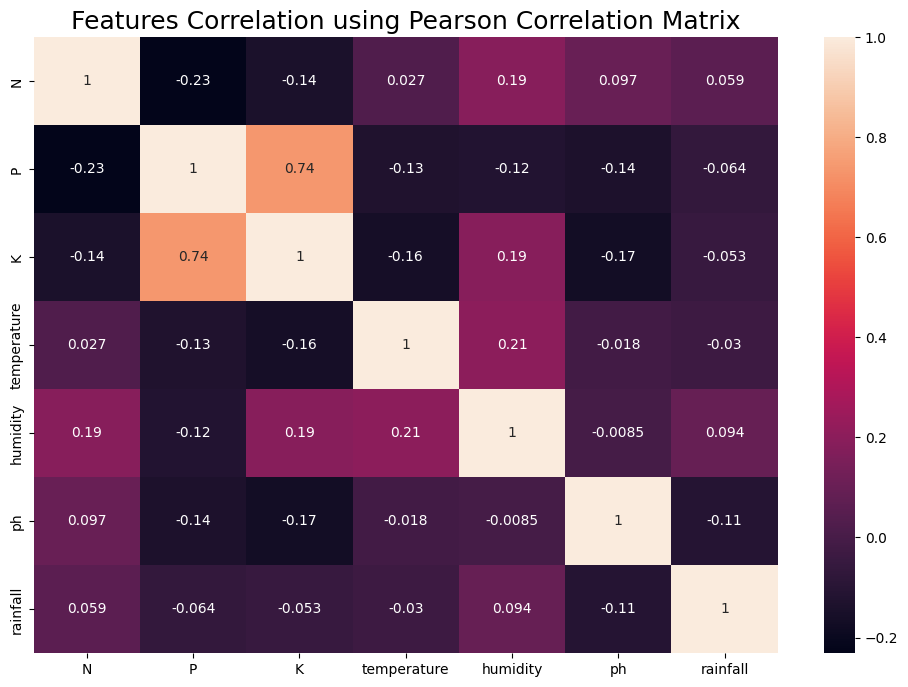

In [17]:
plt.figure(figsize=(12,8))
plt.title("Features Correlation using Pearson Correlation Matrix", fontsize=18)
sns.heatmap(corr_pearson, annot=True)

### FOR SPEARMAN'S CORRELATION MATRIX

<Axes: title={'center': "Features Correlation using Spearman's Correlation Matrix"}>

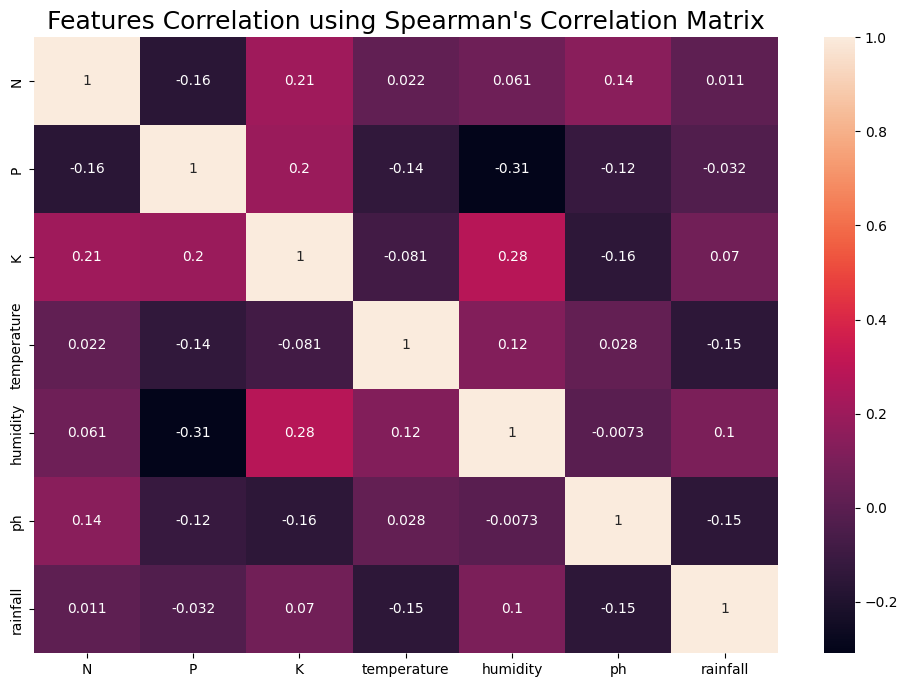

In [18]:
plt.figure(figsize=(12,8))
plt.title("Features Correlation using Spearman's Correlation Matrix", fontsize=18)
sns.heatmap(corr_spearman, annot=True)

### FOR KENDALL'S TAU CORRELATION MATRIX

<Axes: title={'center': "Features Correlation using Kendall's Tau Correlation Matrix"}>

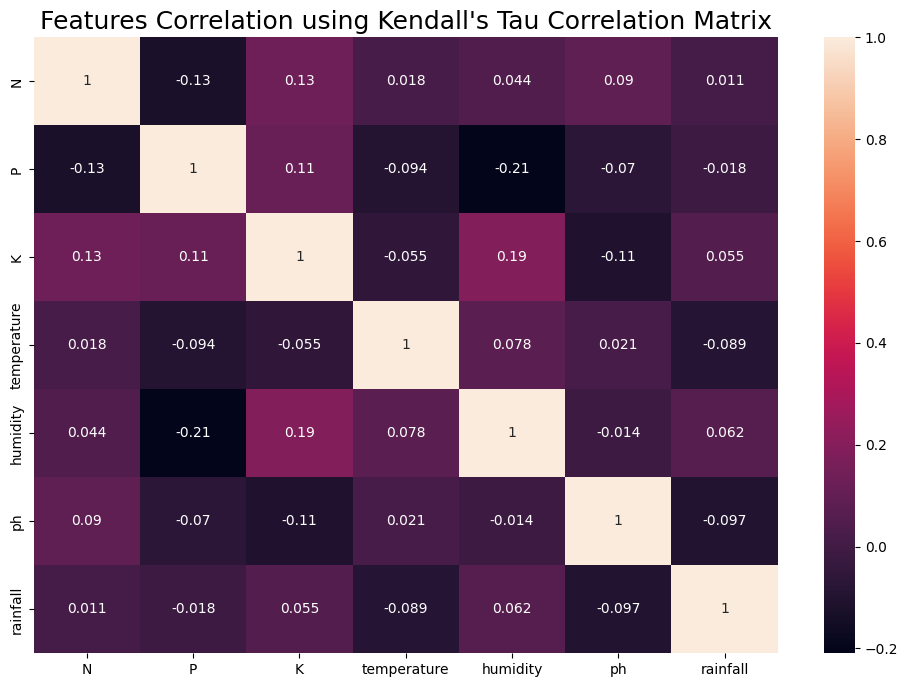

In [19]:
plt.figure(figsize=(12,8))
plt.title("Features Correlation using Kendall's Tau Correlation Matrix", fontsize=18)
sns.heatmap(corr_kendall, annot=True)

## HISTOGRAM FOR UNIVARIATE ANALYSIS

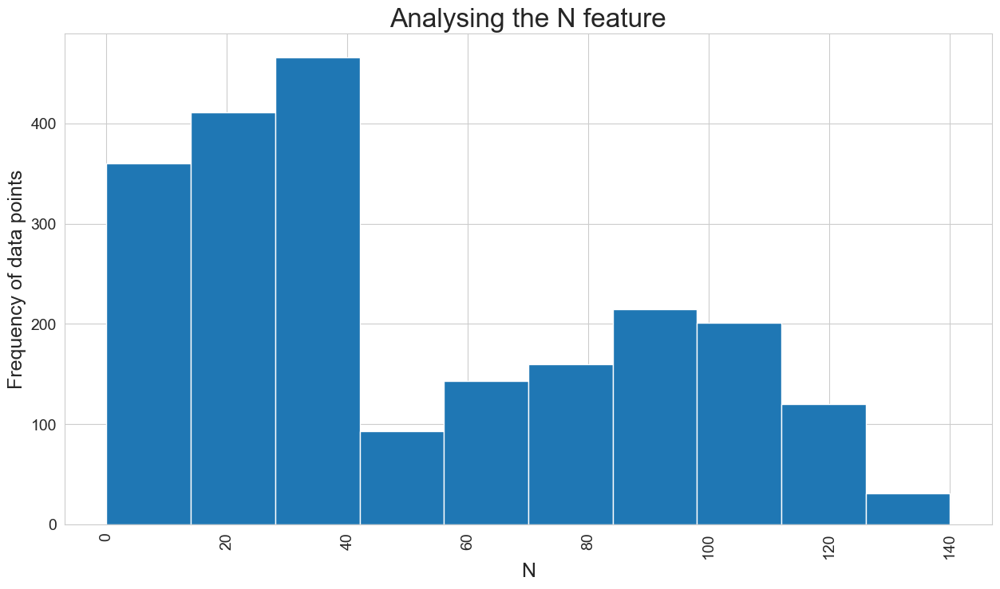

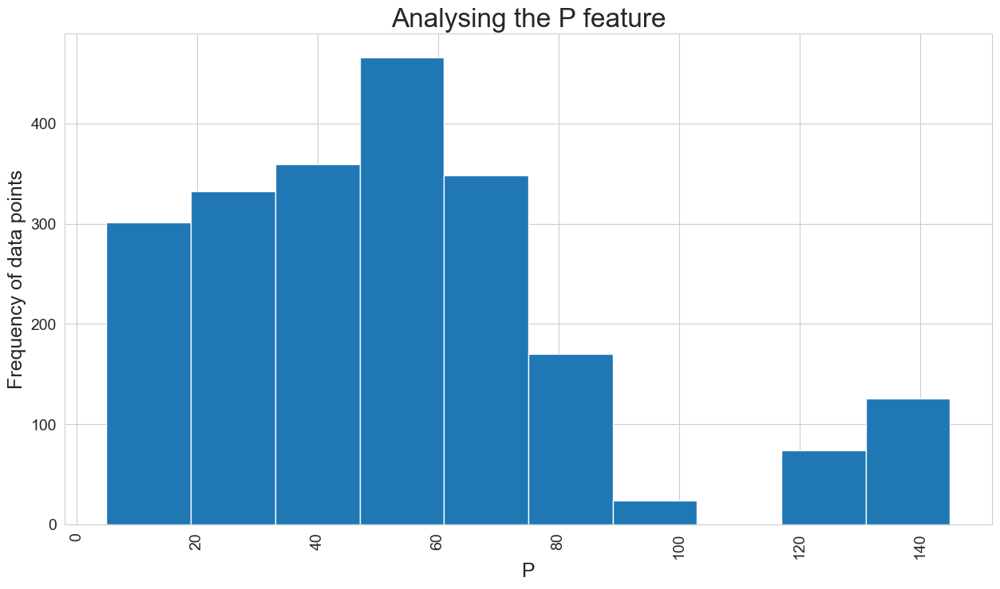

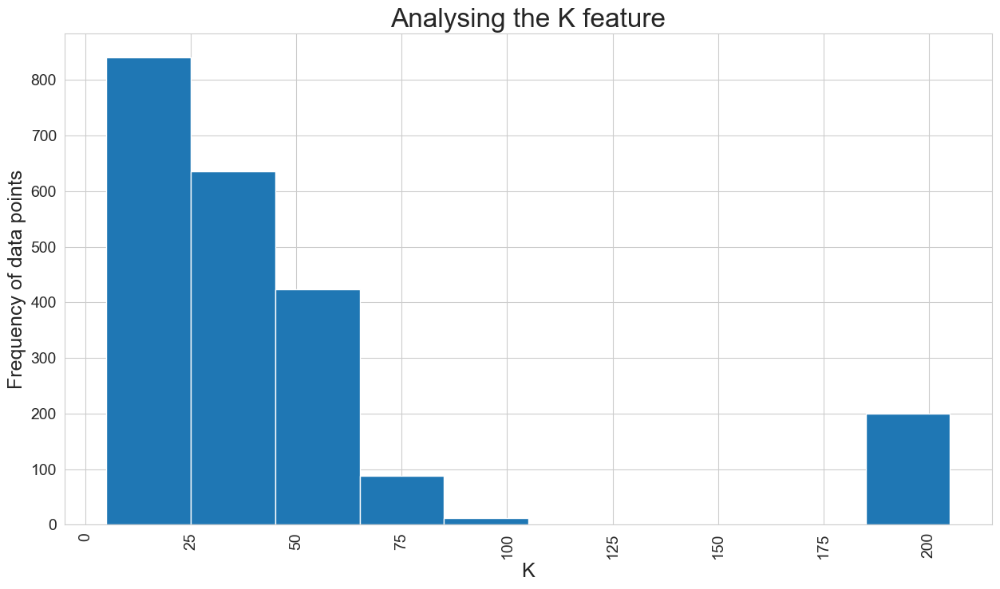

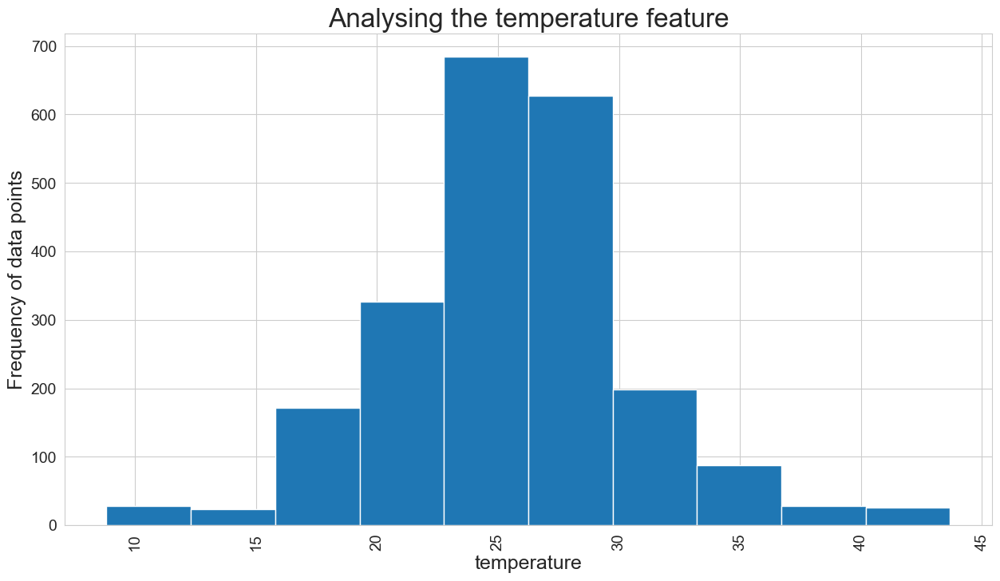

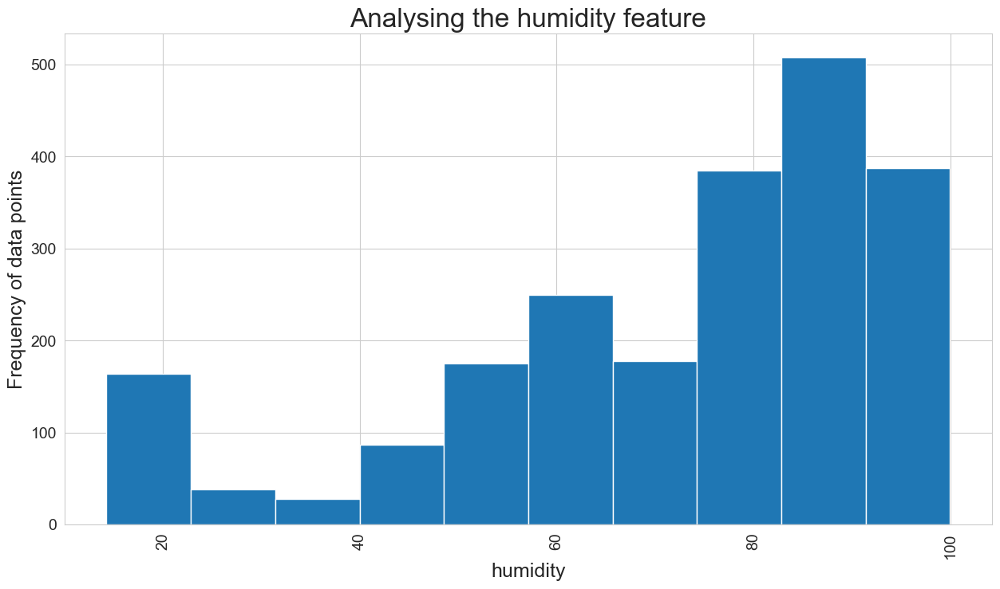

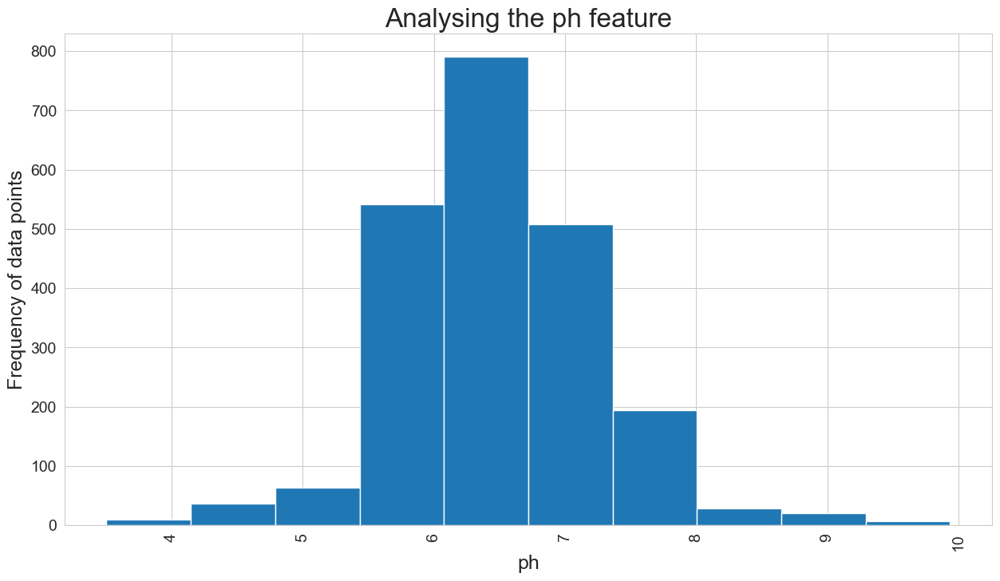

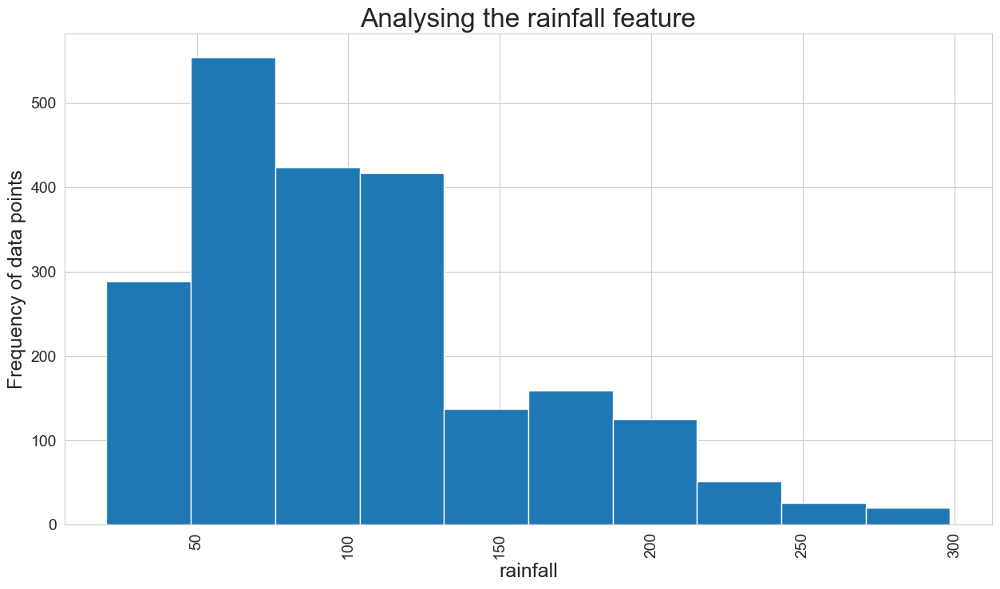

In [20]:
for x in selected_features:
    ax = sns.set_style('whitegrid')
    plt.subplots(figsize=(15,8))
    plt.hist(df[x])
    plt.xticks(rotation=90, fontsize=14)
    plt.yticks(rotation=0, fontsize=14)
    plt.title("Analysing the " + str(x) + " feature" ,fontsize = 24)
    plt.xlabel(str(x), fontsize = 18)
    plt.ylabel("Frequency of data points", fontsize = 18)

## DISTPLOT FOR UNIVARIATE ANALYSIS

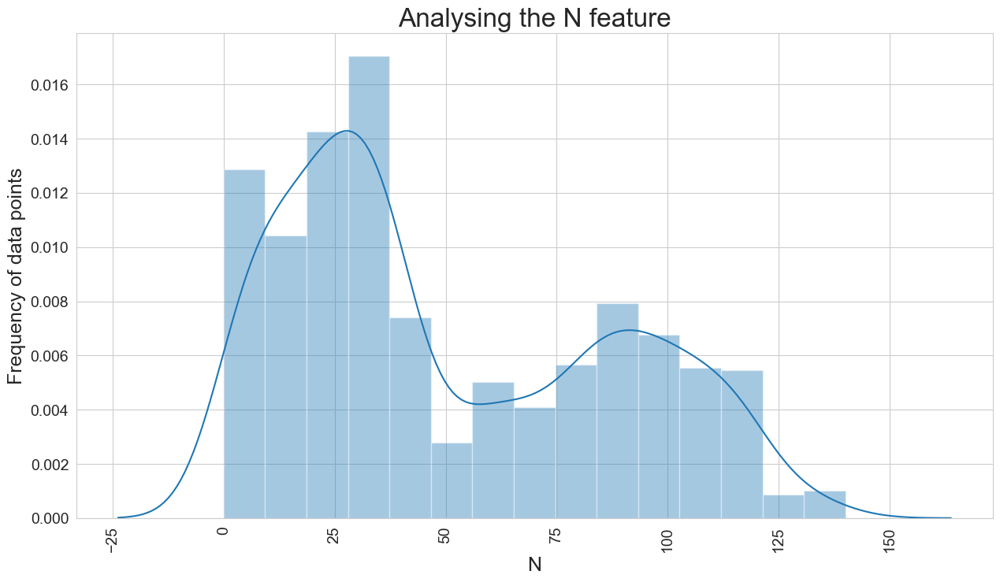

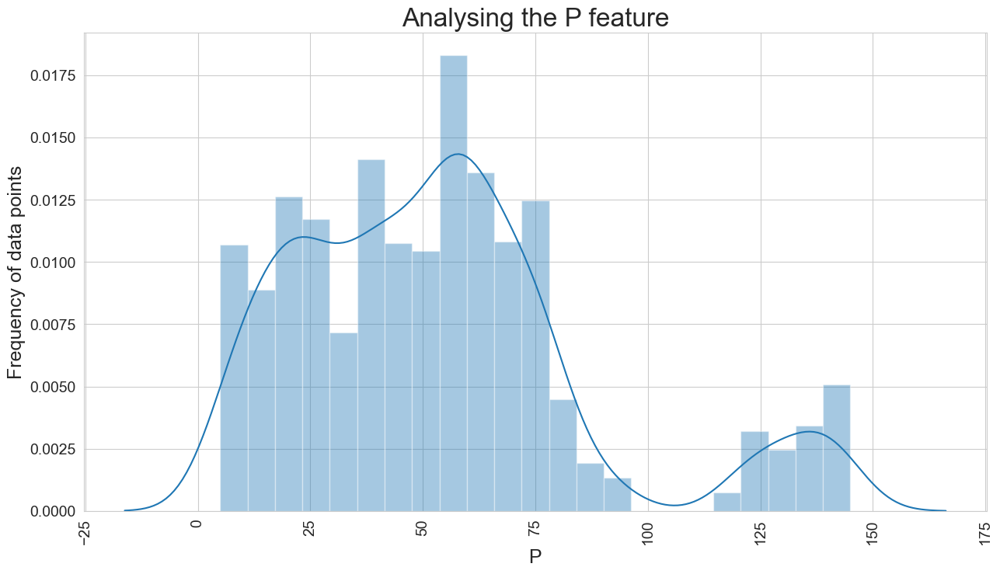

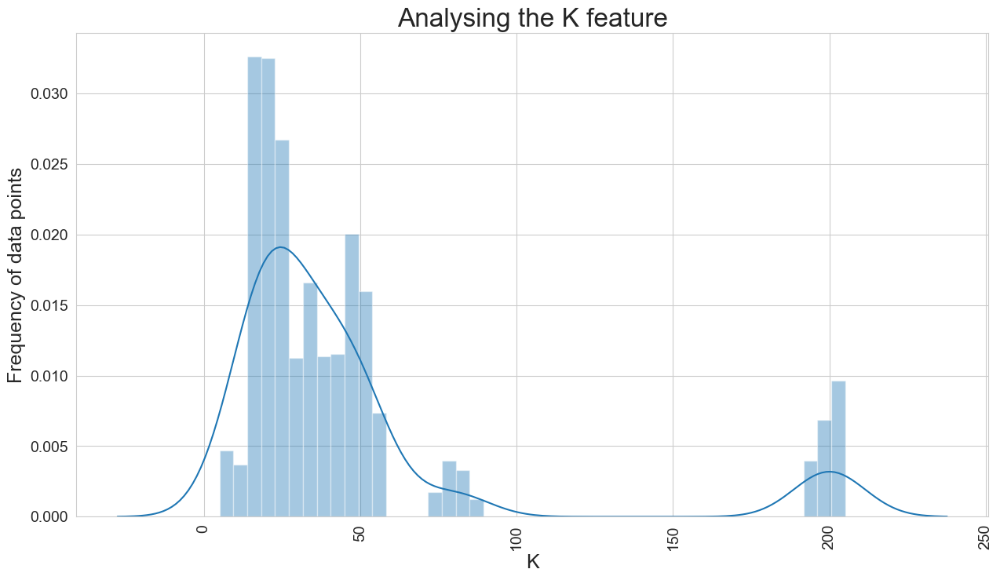

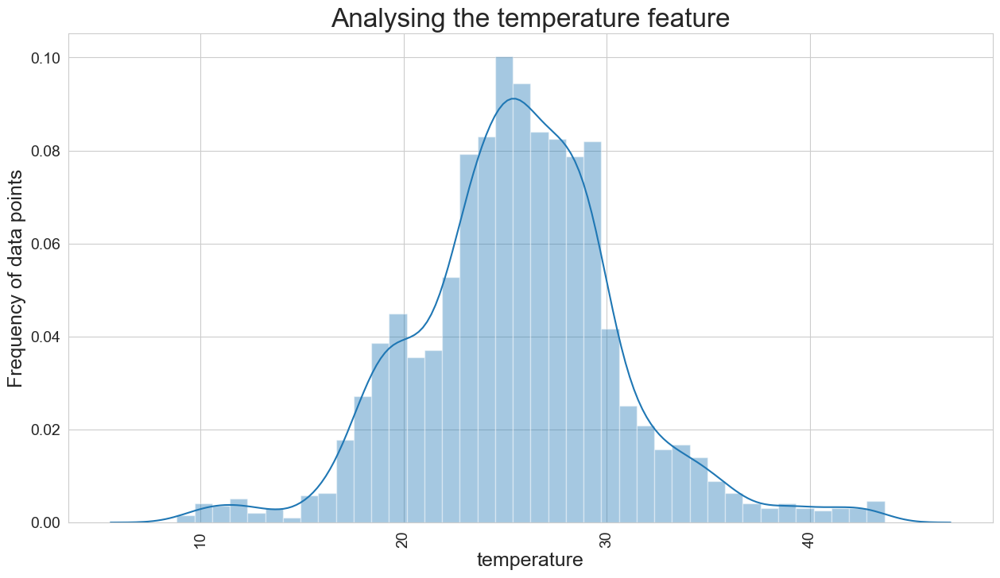

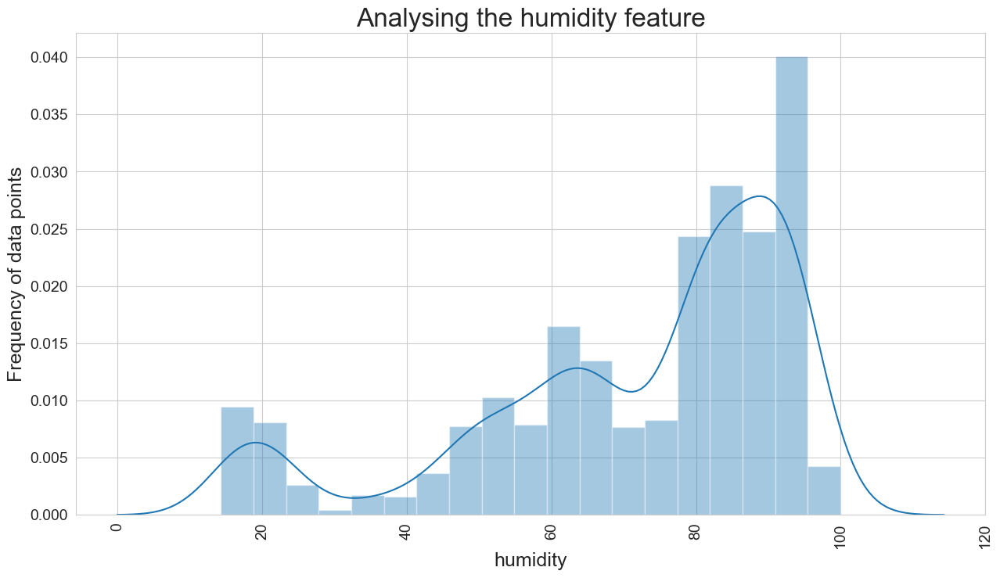

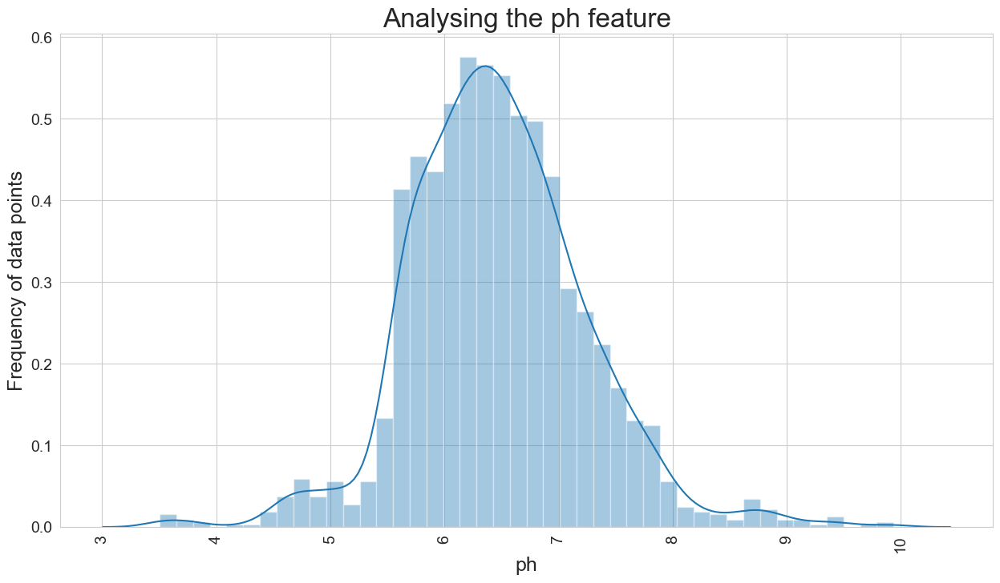

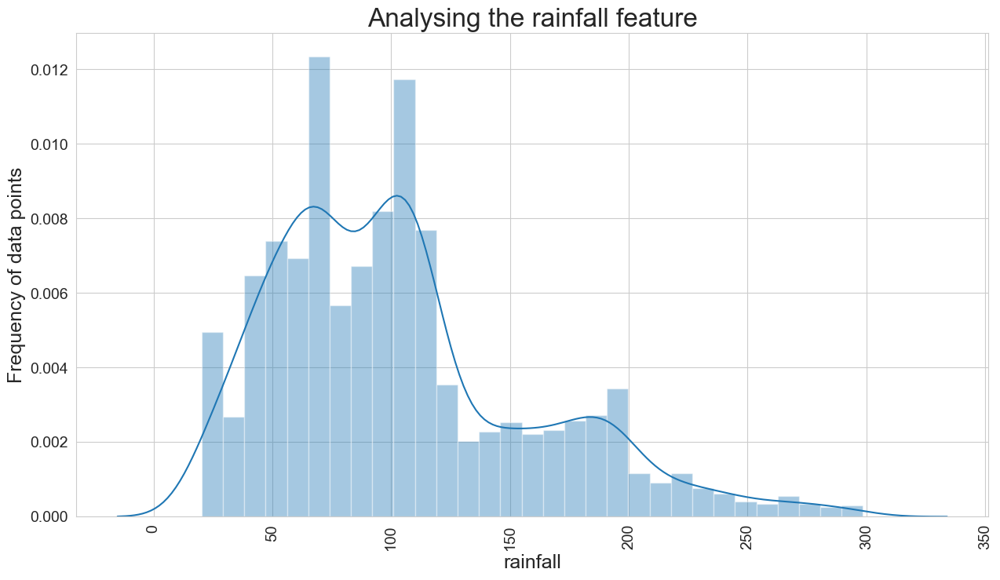

In [21]:
for x in selected_features:
    ax = sns.set_style('whitegrid')
    plt.subplots(figsize=(15,8))
    sns.distplot(df[x])
    plt.xticks(rotation=90, fontsize=14)
    plt.yticks(rotation=0, fontsize=14)
    plt.title("Analysing the " + str(x) + " feature" ,fontsize = 24)
    plt.xlabel(str(x), fontsize = 18)
    plt.ylabel("Frequency of data points", fontsize = 18)

## BARGRAPH FOR BIVARIATE ANALYSIS

In [22]:
def crops_bargraph(yfeature):
    ax = sns.set_style('whitegrid')
    plt.subplots(figsize=(15,8))

    ax = sns.barplot(x="label", y=yfeature, data=df, ci=None)
    ax.bar_label(ax.containers[0], fontsize=12)

    plt.xticks(rotation=90, fontsize=14)
    plt.yticks(rotation=0, fontsize=14)
    plt.title("Crops Relation with " + str(yfeature), fontsize = 24)
    plt.xlabel("Crops Names", fontsize = 18)
    plt.ylabel("values of " + str(yfeature), fontsize = 18)

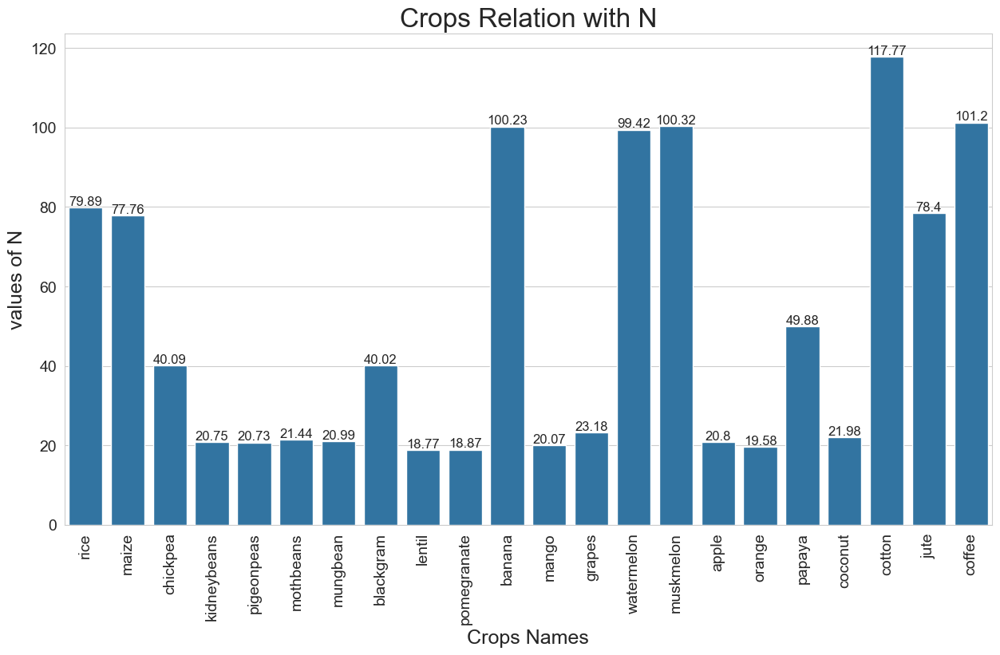

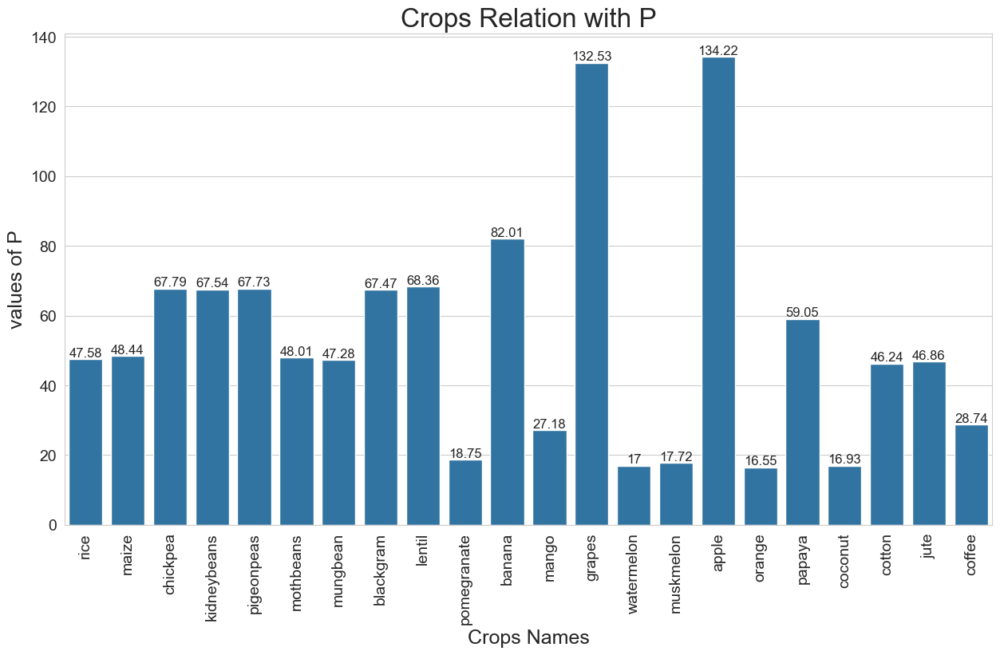

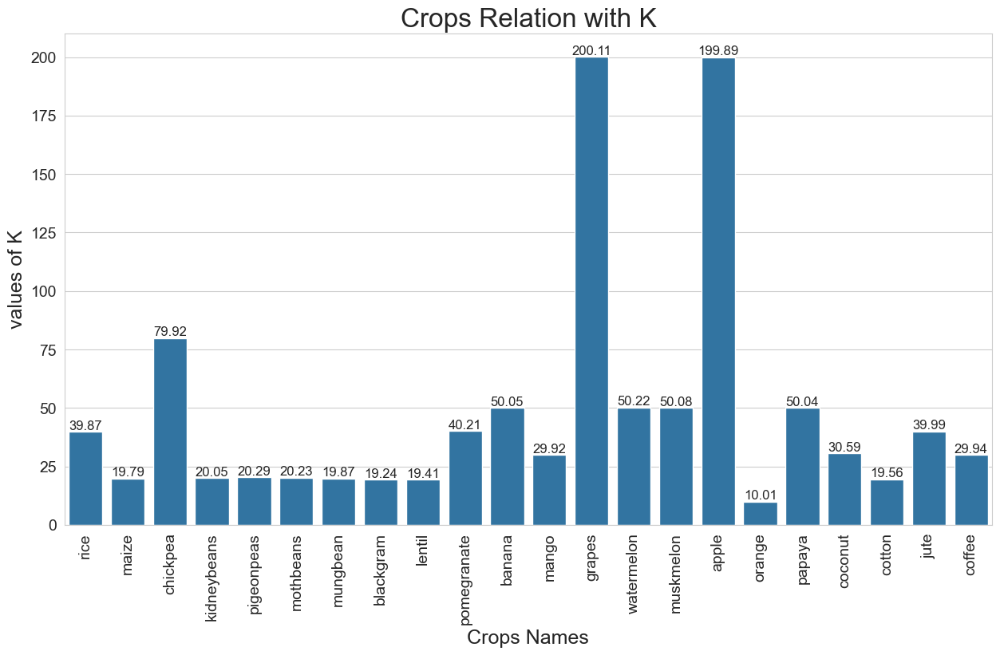

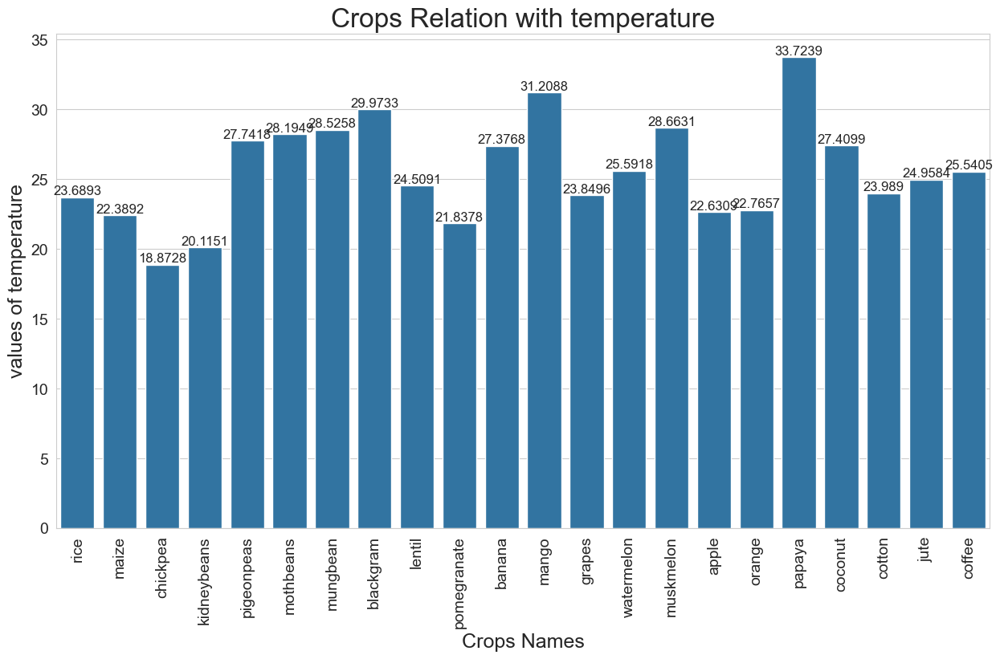

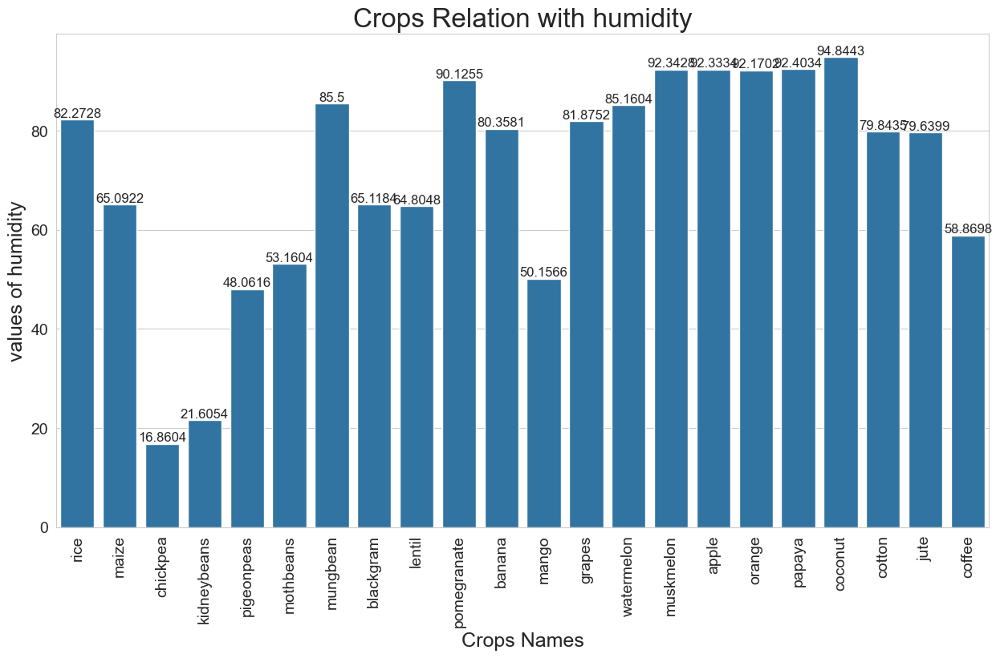

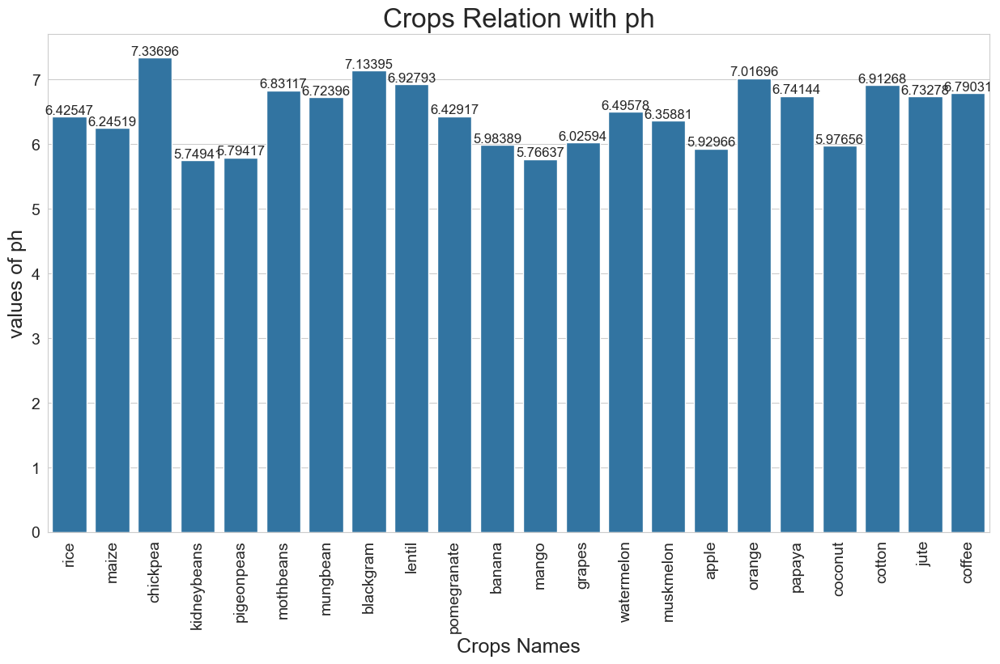

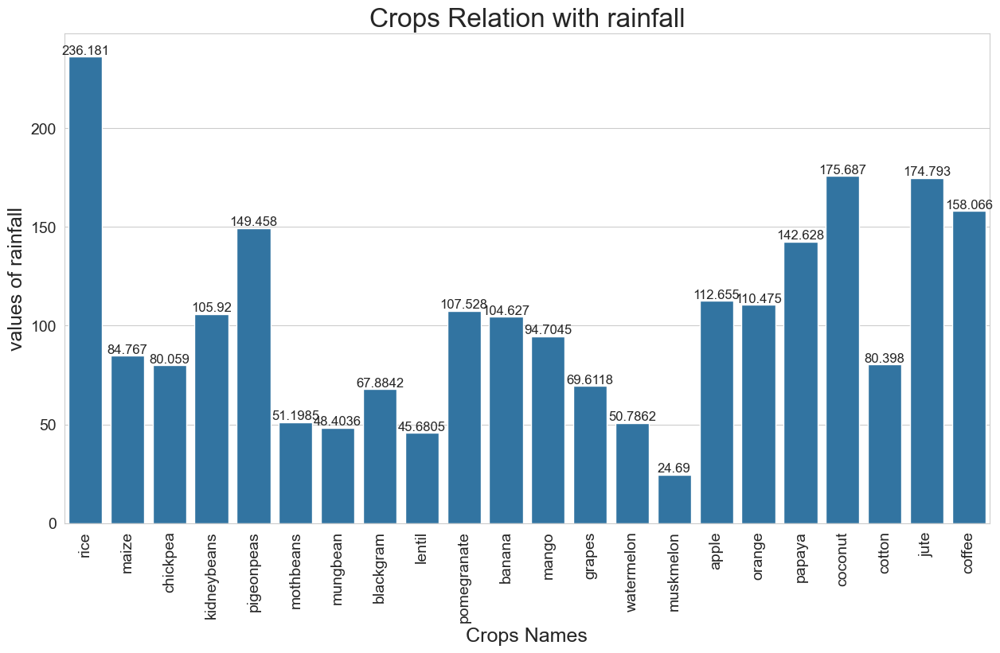

In [23]:
for x in selected_features:
    crops_bargraph(x)

## BOXPLOT FOR STATISTIC VISUALISATION OF EACH FEATURES

In [24]:
def crop_boxplot(yfeature):
    ax = sns.set_style('whitegrid')
    plt.subplots(figsize=(15,8))
    sns.boxplot(x=yfeature, y="label", data=df)

    plt.title("Crops Relation with " + str(yfeature), fontsize = 24)
    plt.xlabel("values of " + str(yfeature), fontsize = 18)
    plt.ylabel("Crops Names", fontsize = 18)

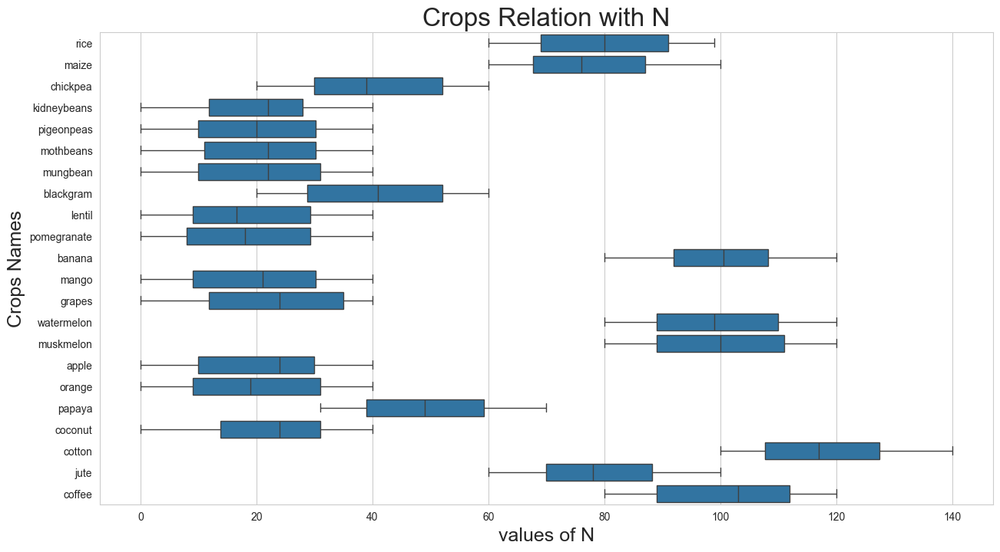

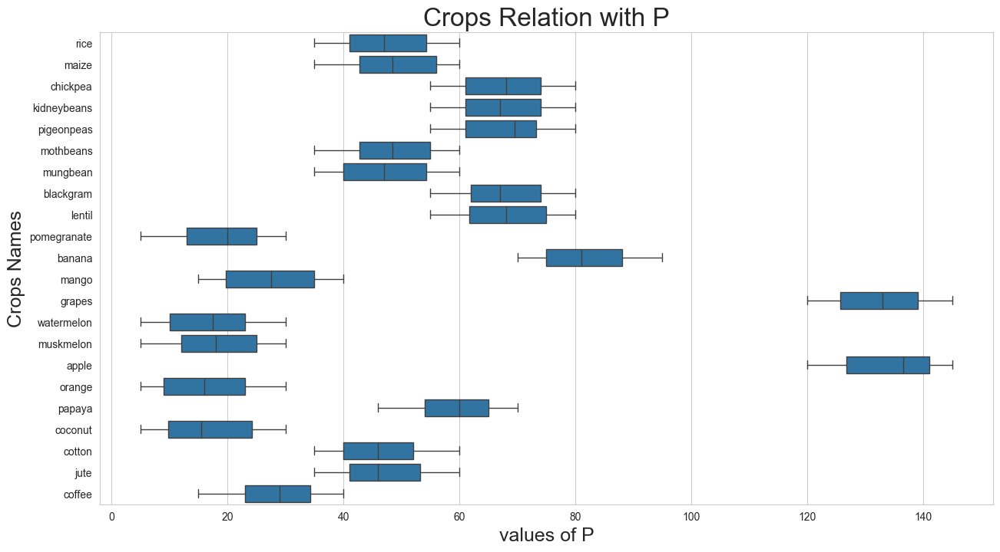

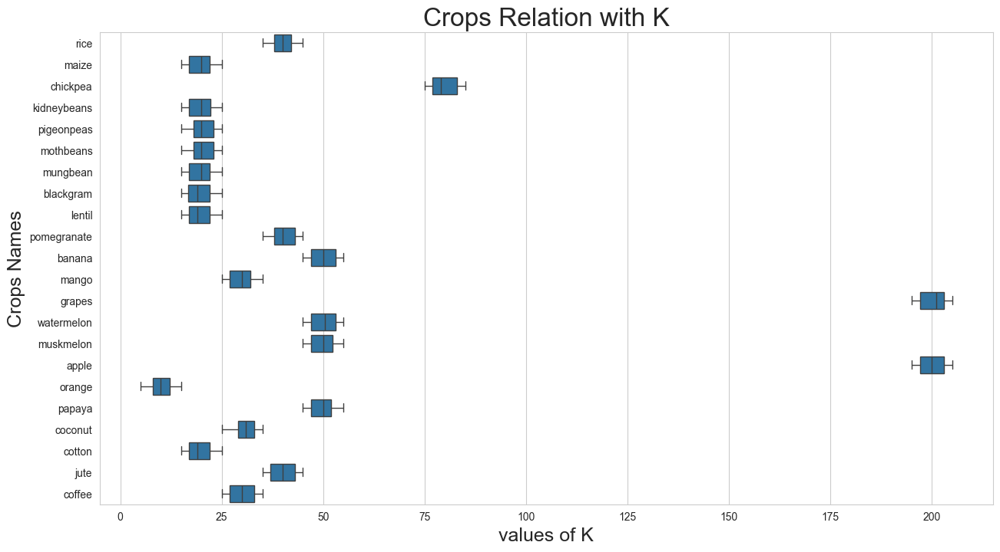

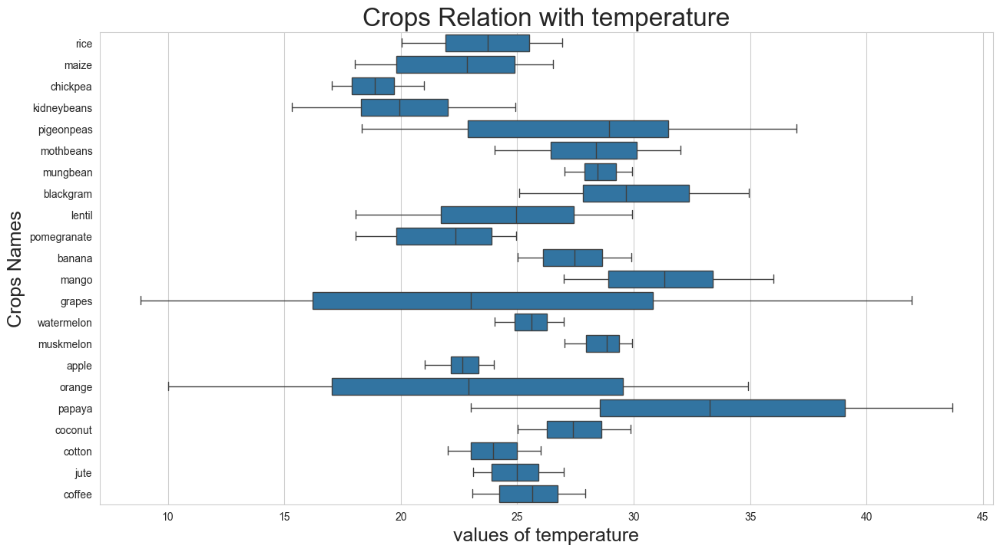

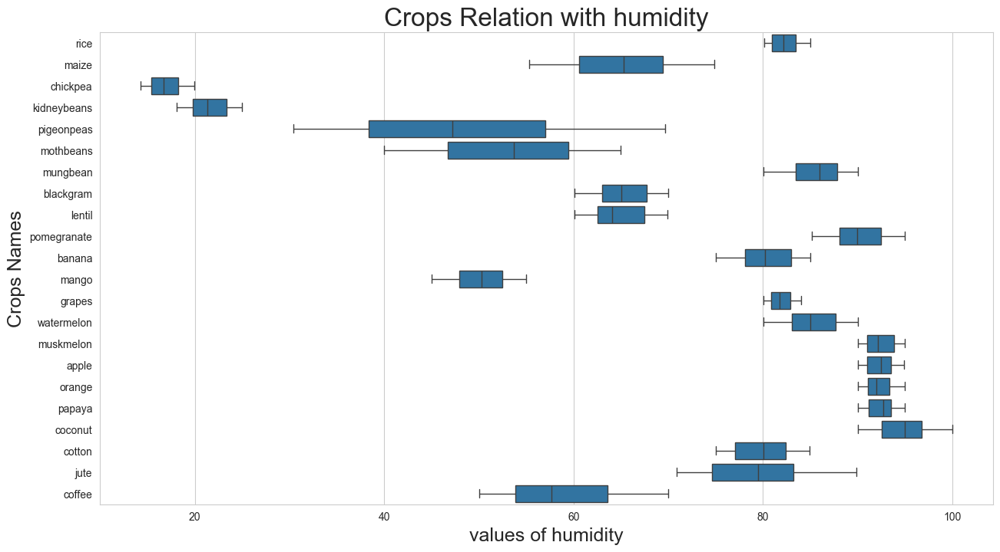

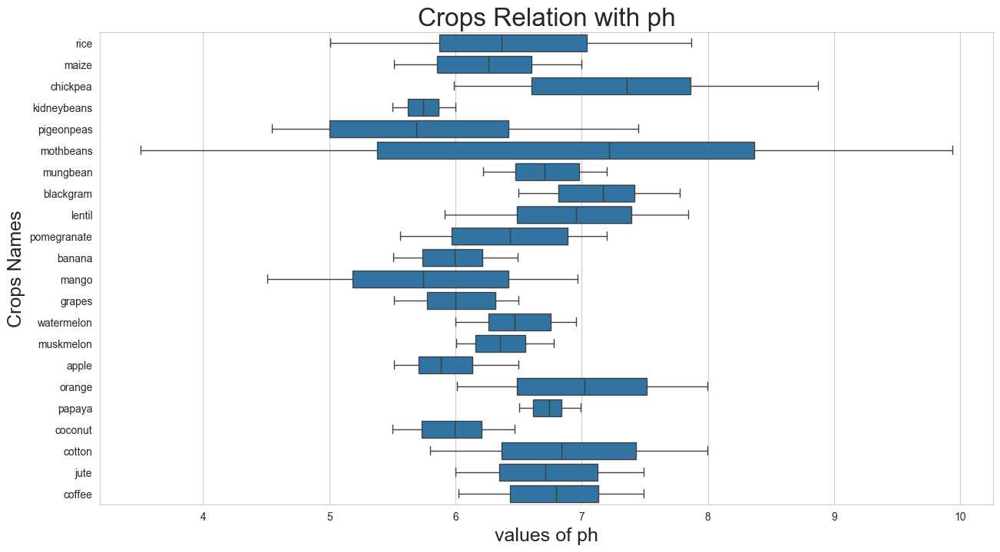

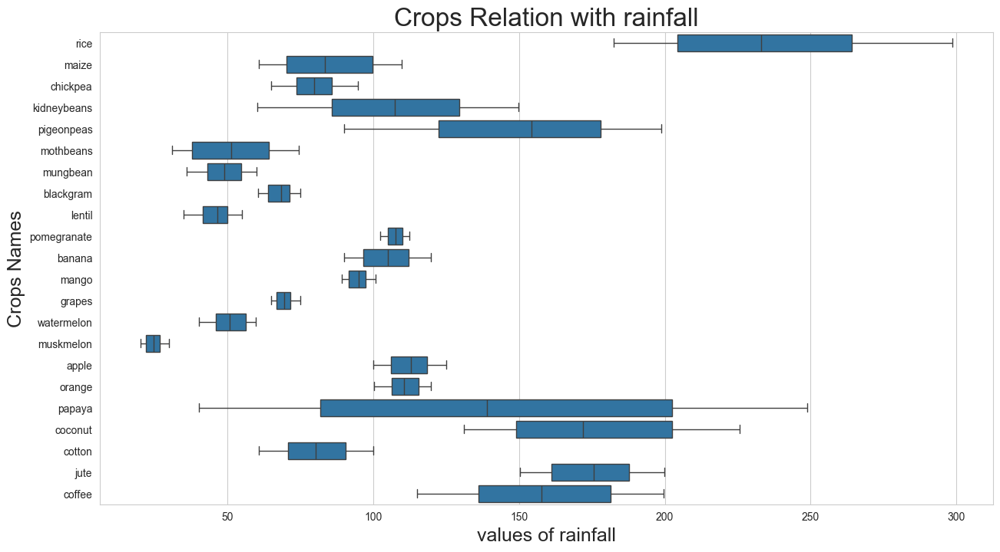

In [25]:
for x in selected_features:
    crop_boxplot(x)

## LINE PLOT FOR BIVARIATE ANALYSIS

In [26]:
def crops_lineplot(yfeature):
    ax = sns.set_style('whitegrid')
    plt.subplots(figsize=(14, 8))
    
    sns.lineplot(x=yfeature, y="label", data=df, ci=None)

    plt.xticks(rotation=90, fontsize=14)
    plt.yticks(rotation=0, fontsize=14)
    plt.title("Crops Relation with " + str(yfeature), fontsize = 24)
    plt.xlabel("values of " + str(yfeature), fontsize = 18)
    plt.ylabel("Crops Name", fontsize = 18)

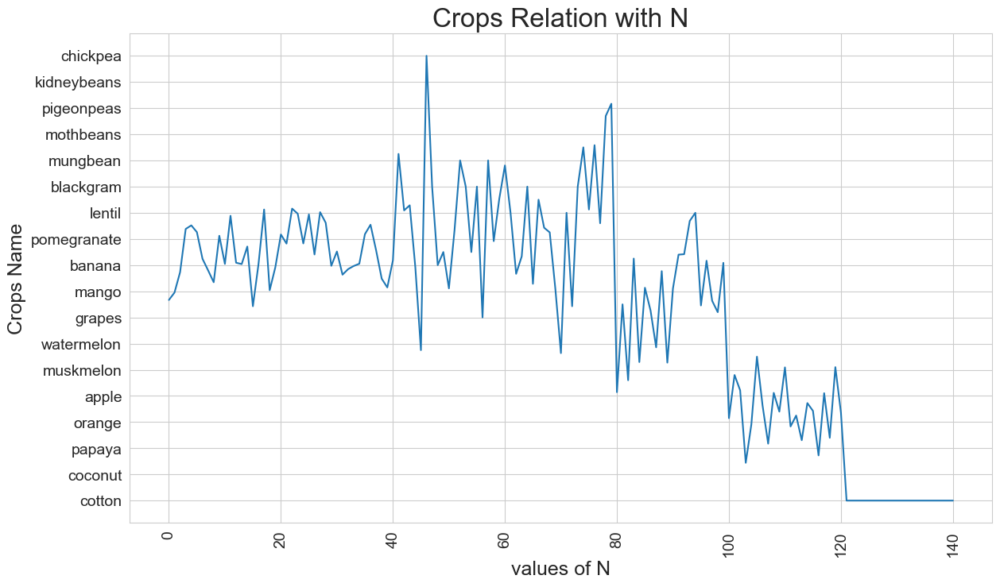

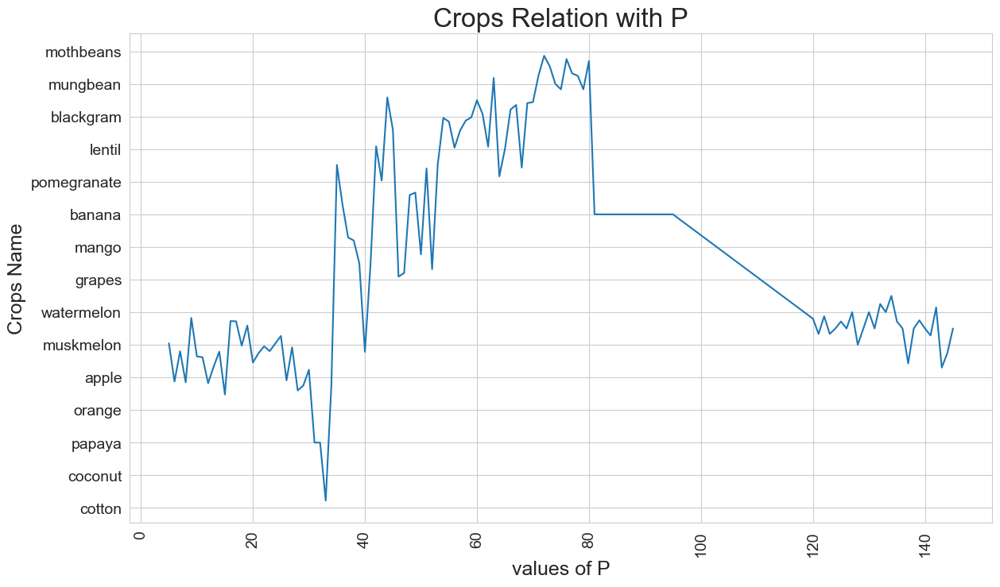

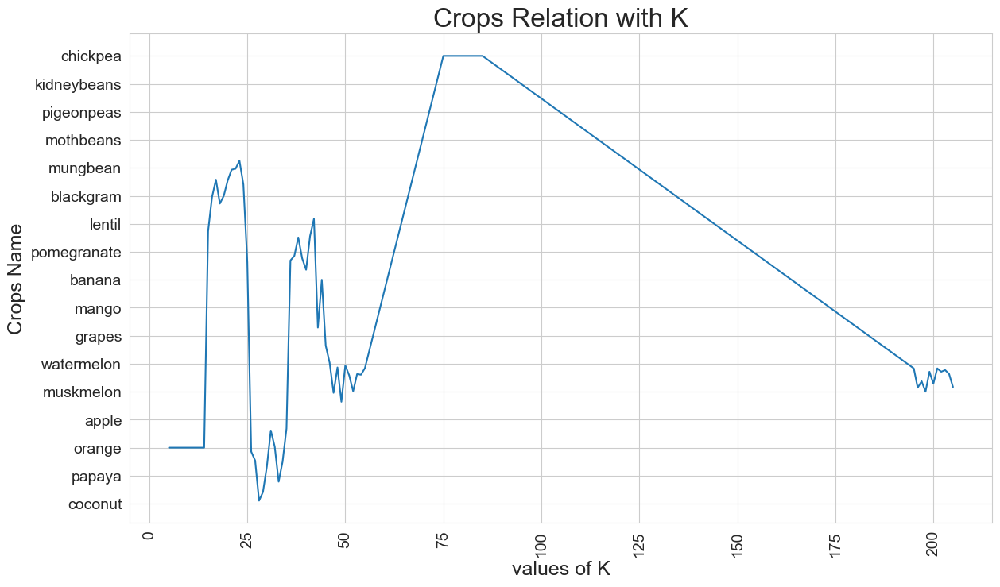

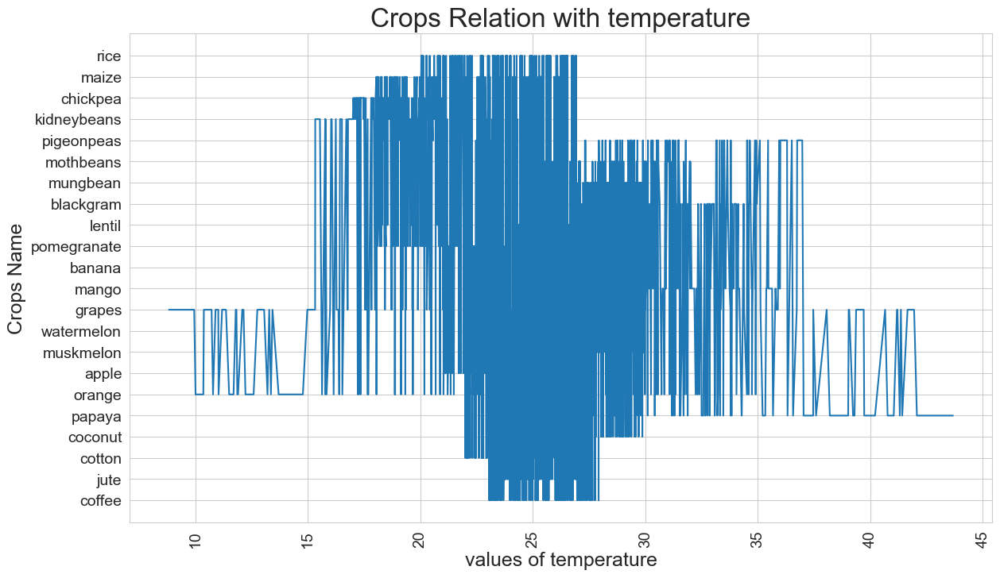

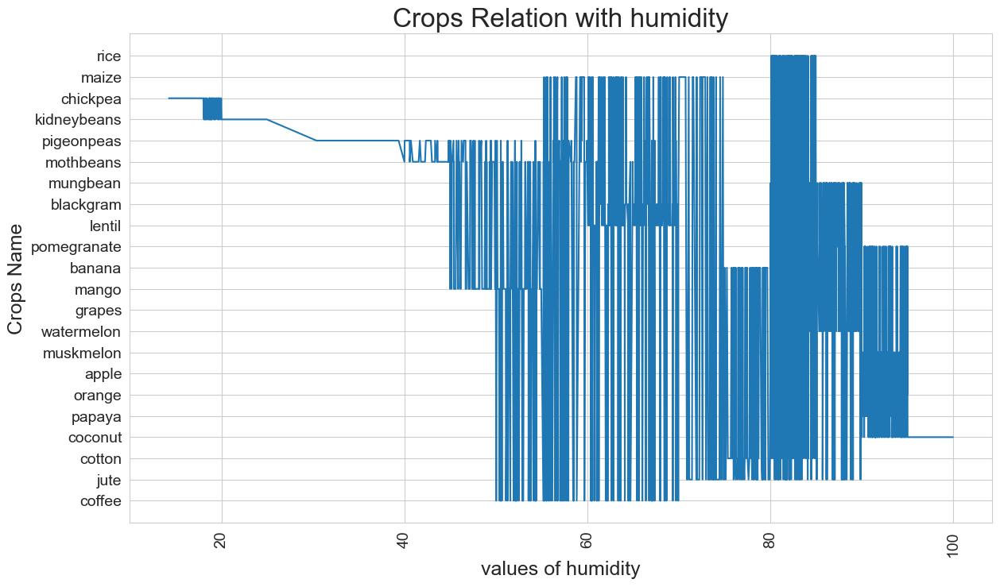

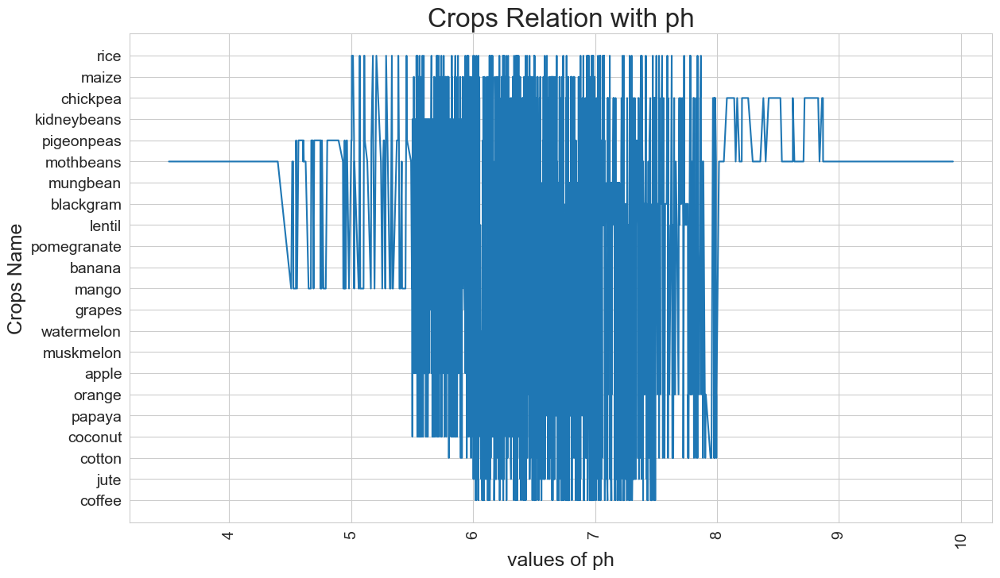

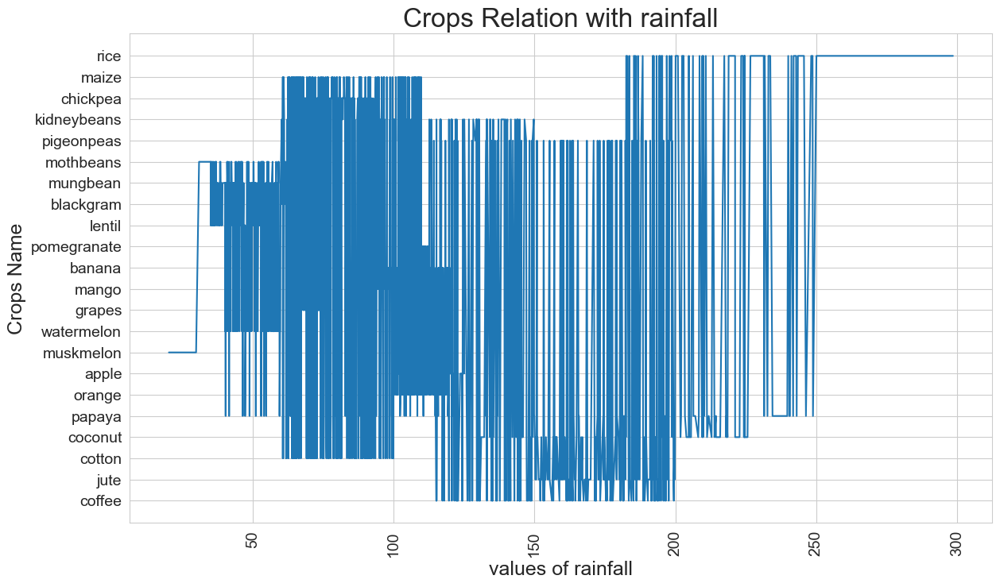

In [27]:
for x in selected_features:
    crops_lineplot(x)

## MULTIVARIATE ANALYSIS USING SCATTERPLOTS

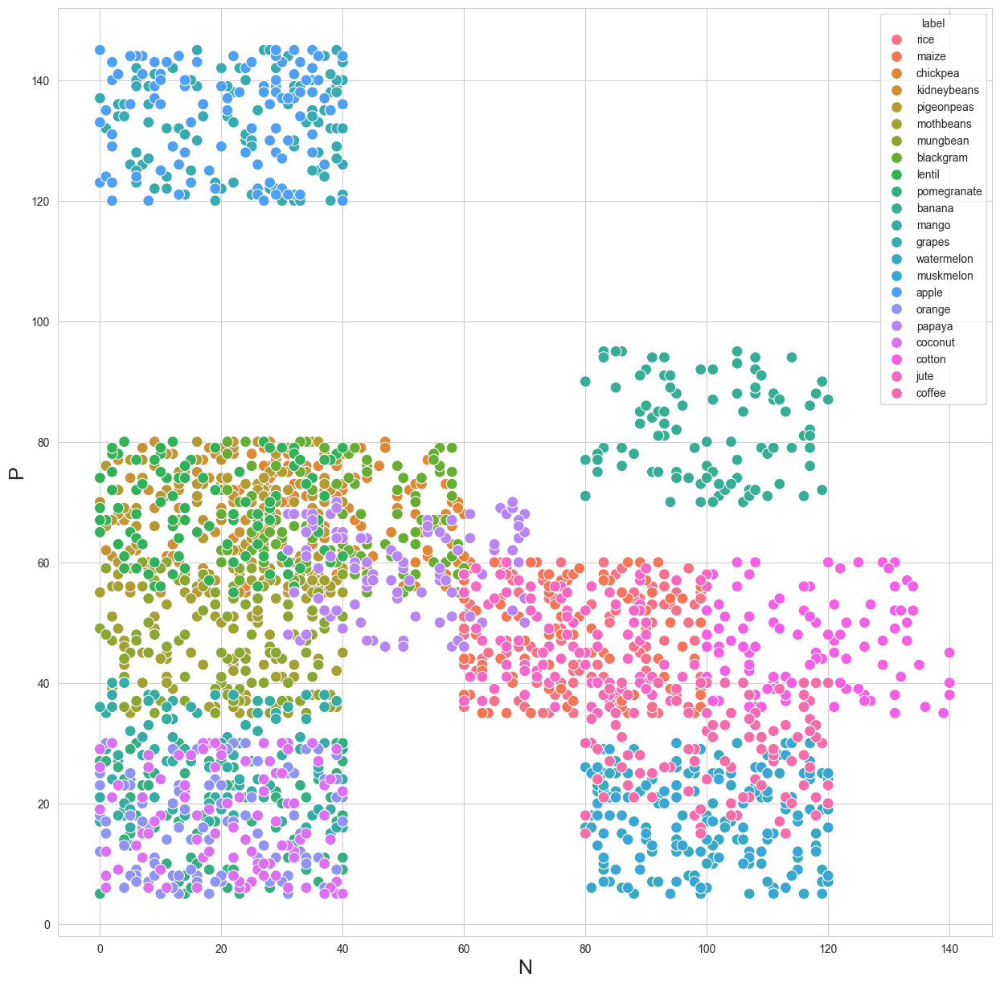

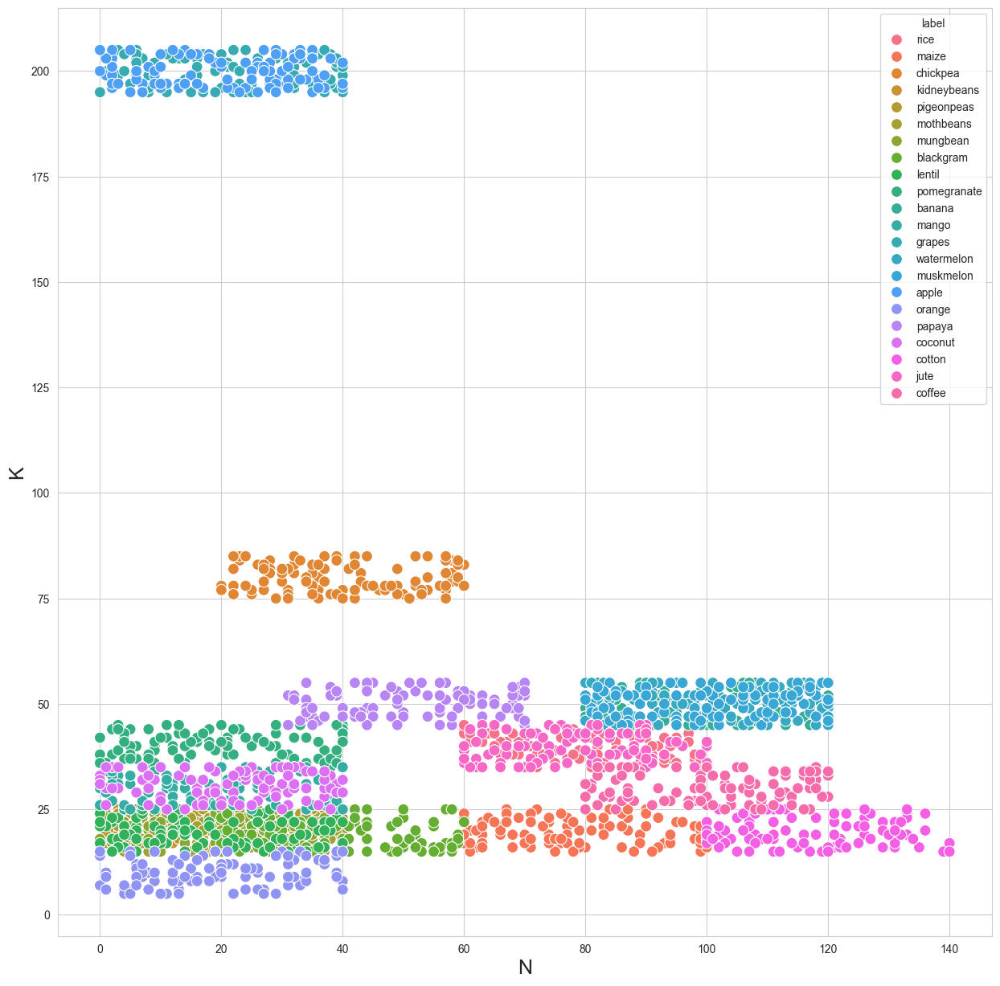

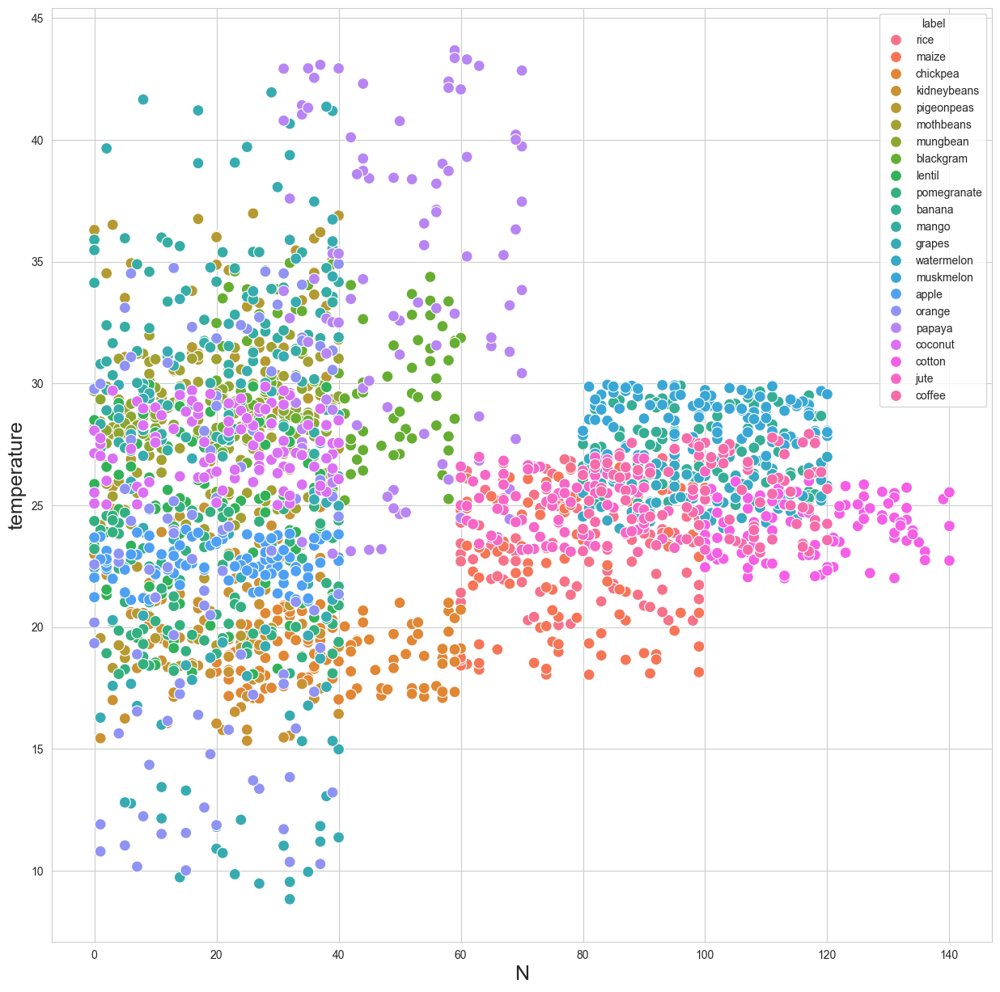

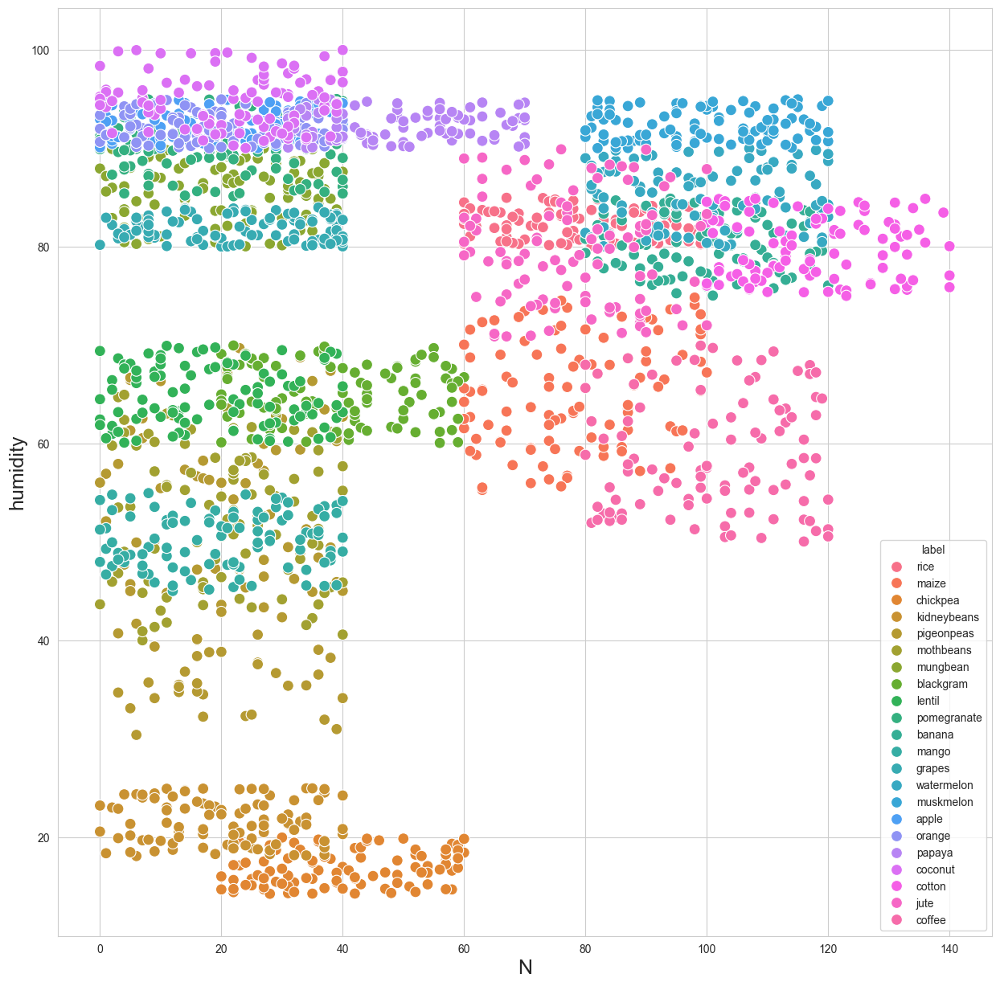

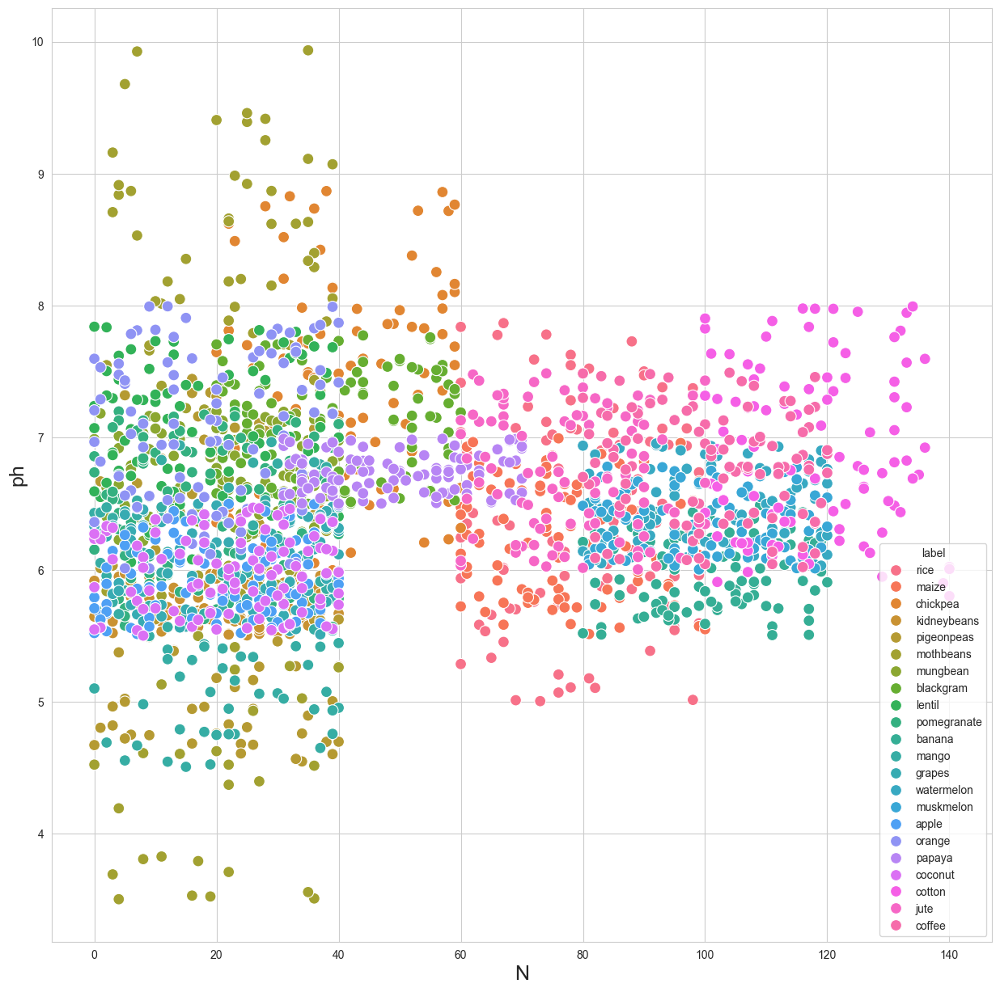

...

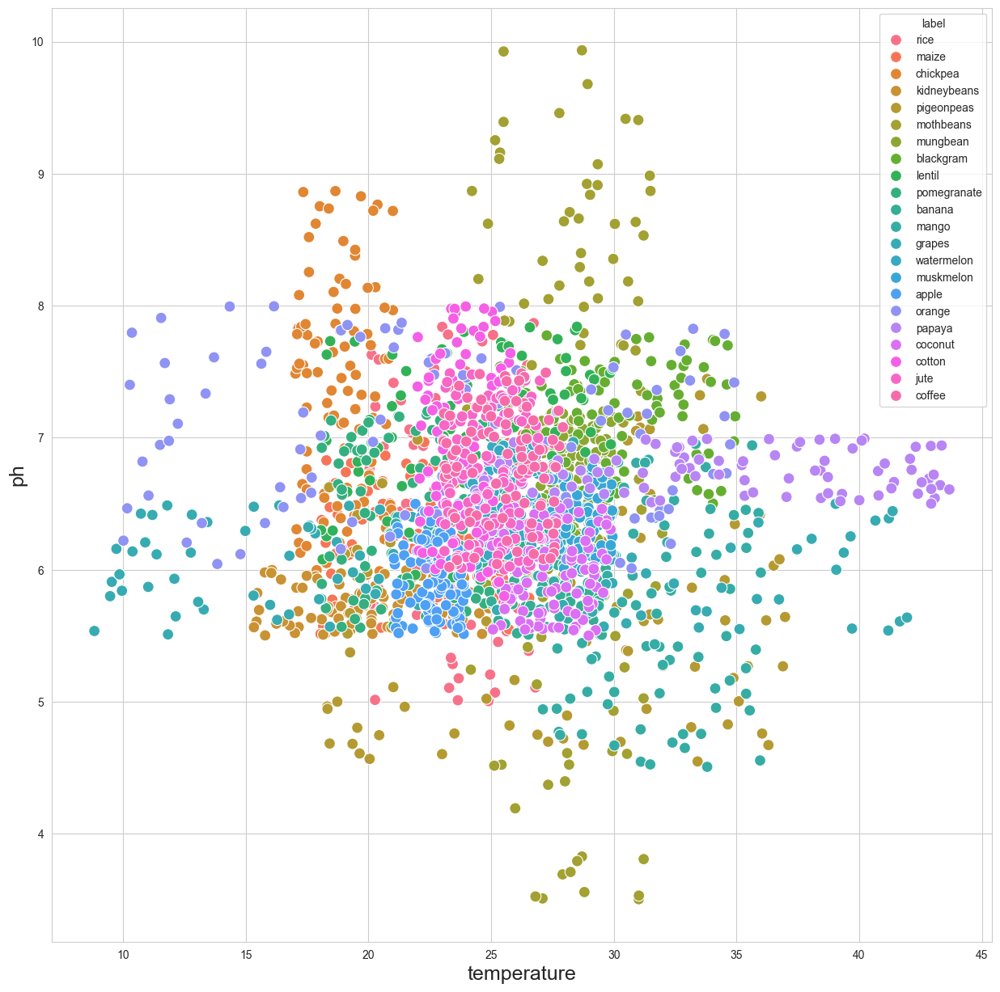

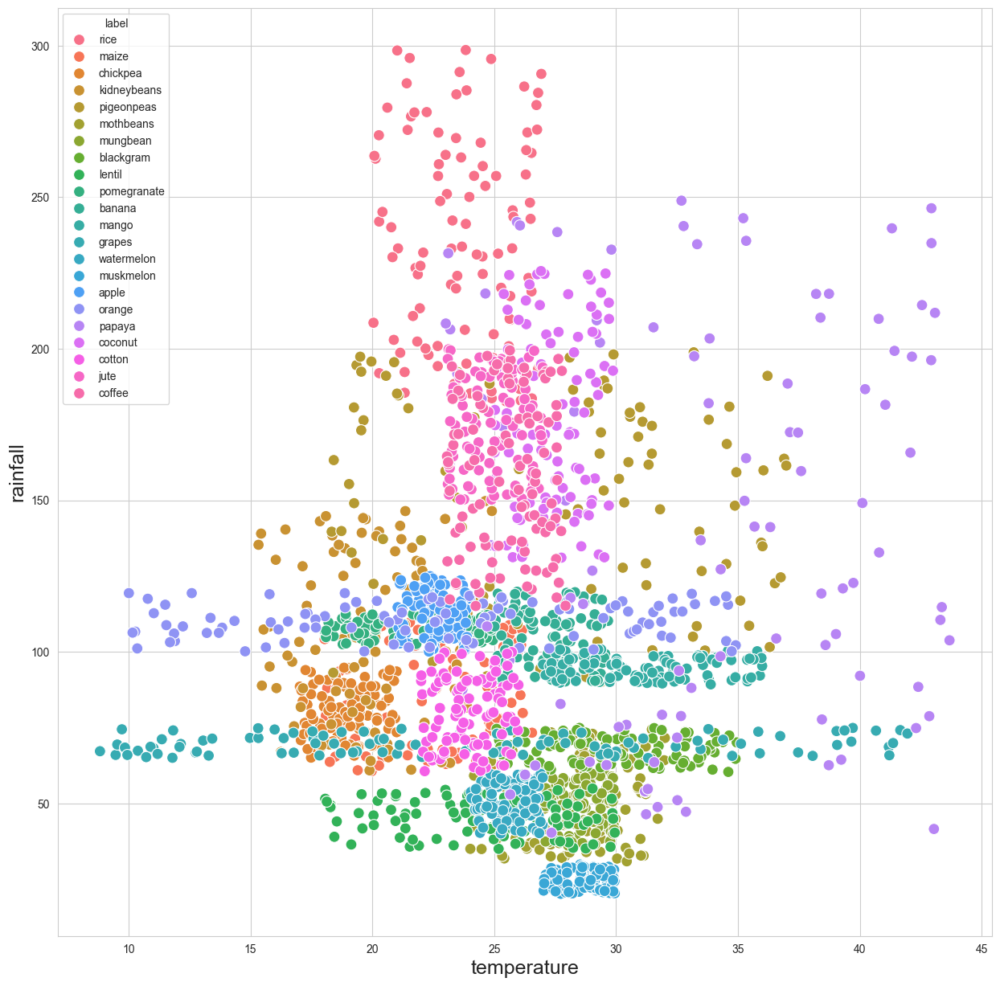

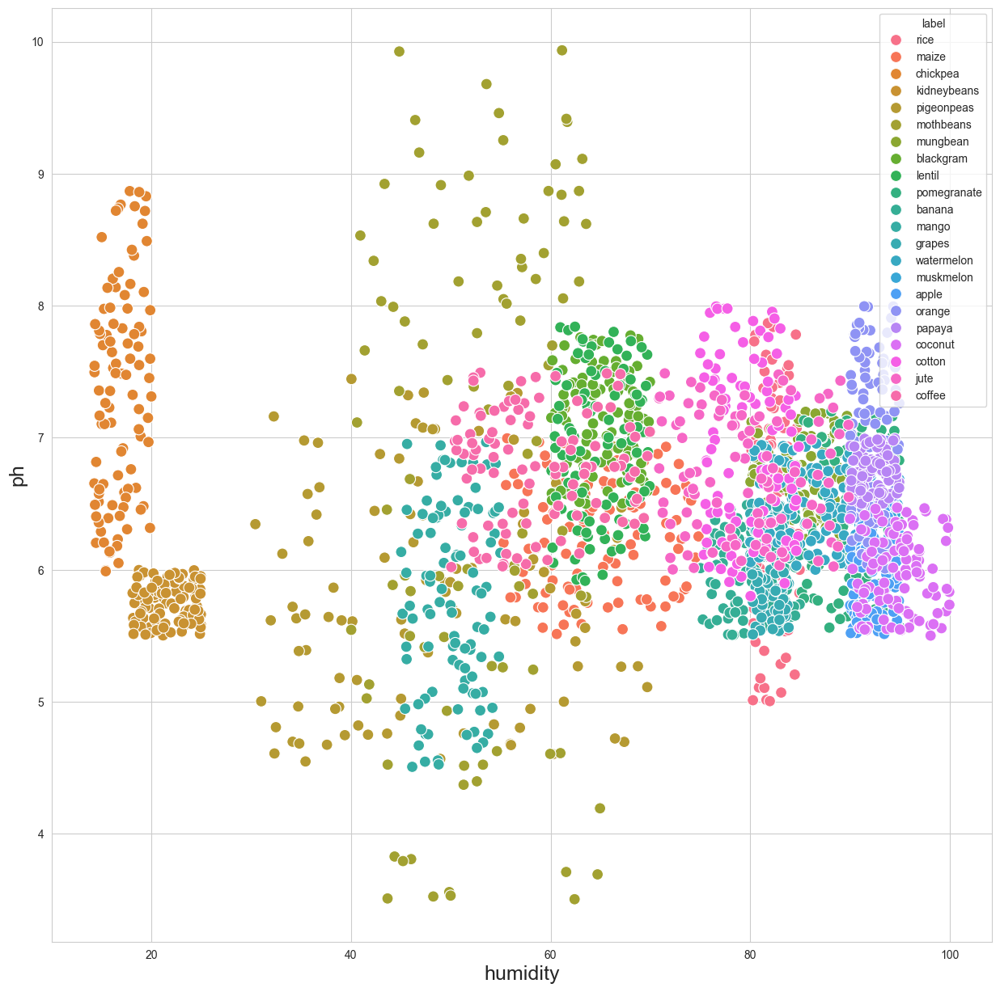

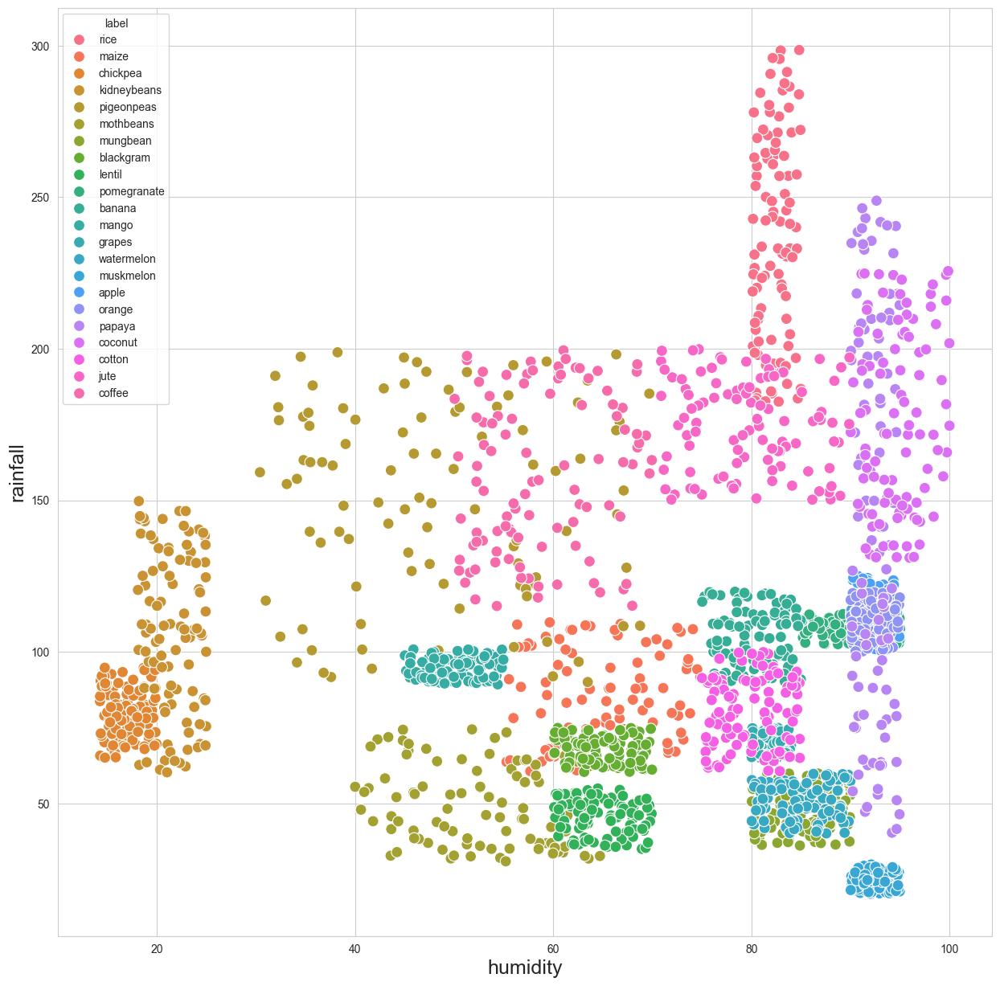

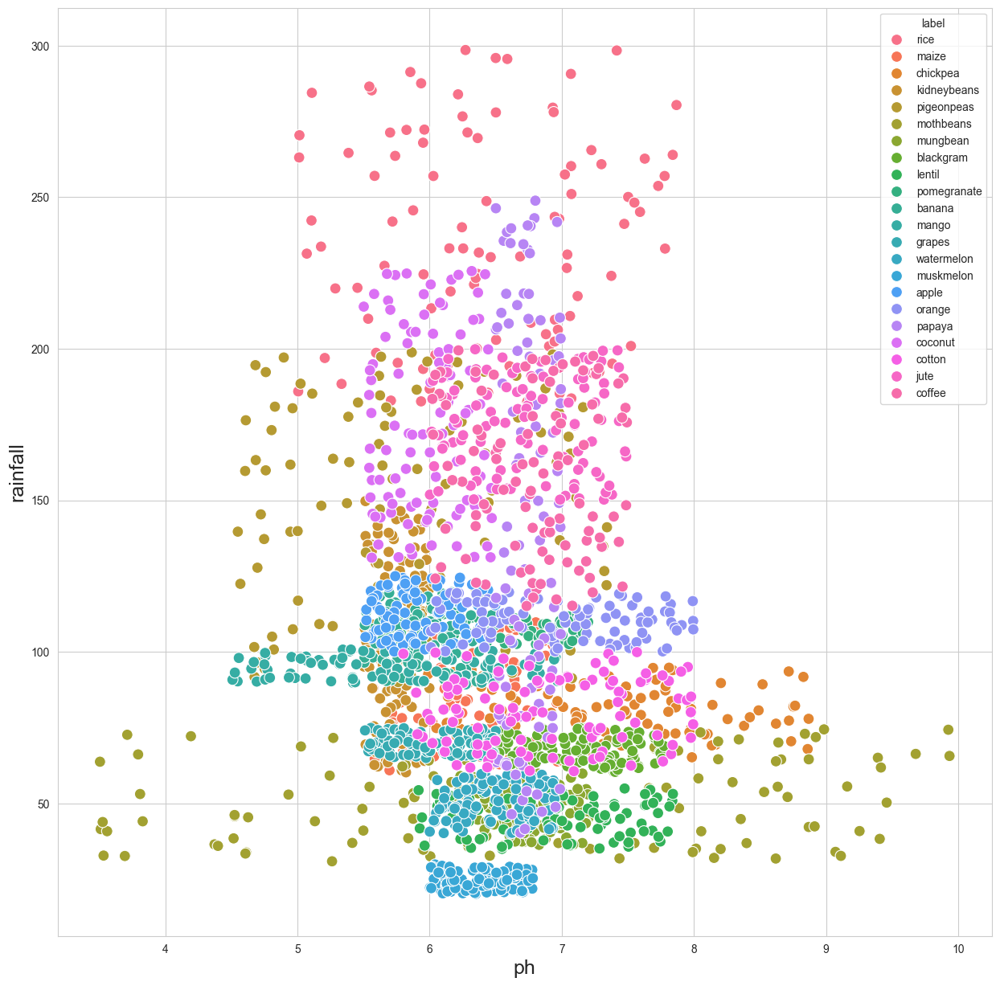

In [28]:
for i in range(0,len(selected_features)):
    for j in range(i+1,len(selected_features)):
        if selected_features[i] != selected_features[j]:
            plt.subplots(figsize=(15, 15))
            sns.scatterplot(x=df[selected_features[i]],y=df[selected_features[j]],hue=df['label'],s=100)
            plt.xlabel(selected_features[i],fontsize = 18)
            plt.ylabel(selected_features[j],fontsize = 18)

## CREATING A COPY OF ORIGINAL DATASET

In [4]:
copied_df = df.copy()
copied_df

,N,P,K,temperature,humidity,ph,rainfall,label
0,90,42,43,20.879744,82.002744,6.502985,202.935536,rice
1,85,58,41,21.770462,80.319644,7.038096,226.655537,rice
2,60,55,44,23.004459,82.320763,7.840207,263.964248,rice
3,74,35,40,26.491096,80.158363,6.980401,242.864034,rice
4,78,42,42,20.130175,81.604873,7.628473,262.717340,rice
...,...,...,...,...,...,...,...,...
2195,107,34,32,26.774637,66.413269,6.780064,177.774507,coffee
2196,99,15,27,27.417112,56.636362,6.086922,127.924610,coffee
2197,118,33,30,24.131797,67.225123,6.362608,173.322839,coffee
2198,117,32,34,26.272418,52.127394,6.758793,127.175293,coffee


## NUMERICALLY ENCODING CATEGORICAL LABELS

In [5]:
from sklearn.preprocessing import LabelEncoder 
labelencoder= LabelEncoder() # initializing an object of class LabelEncoder

#Fit and Transforming the label column.
copied_df['label_codes'] = labelencoder.fit_transform(copied_df['label']) 
copied_df

,N,P,K,temperature,humidity,ph,rainfall,label,label_codes
0,90,42,43,20.879744,82.002744,6.502985,202.935536,rice,20
1,85,58,41,21.770462,80.319644,7.038096,226.655537,rice,20
2,60,55,44,23.004459,82.320763,7.840207,263.964248,rice,20
3,74,35,40,26.491096,80.158363,6.980401,242.864034,rice,20
4,78,42,42,20.130175,81.604873,7.628473,262.717340,rice,20
...,...,...,...,...,...,...,...,...,...
2195,107,34,32,26.774637,66.413269,6.780064,177.774507,coffee,5
2196,99,15,27,27.417112,56.636362,6.086922,127.924610,coffee,5
2197,118,33,30,24.131797,67.225123,6.362608,173.322839,coffee,5
2198,117,32,34,26.272418,52.127394,6.758793,127.175293,coffee,5


## SELECTING TARGET LABELS AND INPUT FEATURES

In [6]:
y = copied_df['label_codes']  # Targeted Values 
X = copied_df[selected_features]  # Input Features
X

,N,P,K,temperature,humidity,ph,rainfall
0,90,42,43,20.879744,82.002744,6.502985,202.935536
1,85,58,41,21.770462,80.319644,7.038096,226.655537
2,60,55,44,23.004459,82.320763,7.840207,263.964248
3,74,35,40,26.491096,80.158363,6.980401,242.864034
4,78,42,42,20.130175,81.604873,7.628473,262.717340
...,...,...,...,...,...,...,...
2195,107,34,32,26.774637,66.413269,6.780064,177.774507
2196,99,15,27,27.417112,56.636362,6.086922,127.924610
2197,118,33,30,24.131797,67.225123,6.362608,173.322839
2198,117,32,34,26.272418,52.127394,6.758793,127.175293


In [7]:
y

0       20
1       20
2       20
3       20
4       20
        ..
2195     5
2196     5
2197     5
2198     5
2199     5
Name: label_codes, Length: 2200, dtype: int32

## DATA SPLITTING

In [72]:
from sklearn.metrics import accuracy_score, precision_score, recall_score,f1_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)

## IMPLEMENTING VARIOUS MACHINE LEARNING ALGORITHMS

### 1. DECISION TREE CLASSIFIER

In [31]:
# Import Library for Decision Tree Model
from sklearn.tree import DecisionTreeClassifier
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler

In [80]:
dt_pipeline = make_pipeline( StandardScaler(), DecisionTreeClassifier( criterion = "entropy", random_state = 2, max_depth = 5) )
dt_pipeline.fit(X_train, y_train) # Fit Dataset in Model

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('decisiontreeclassifier',
                 DecisionTreeClassifier(criterion='entropy', max_depth=5,
                                        random_state=2))])

Accuracy on Training Data: 93.52%
Precision on Training Data (Macro average): 95.21%
Recall on Training Data (Macro average): 93.21%
F1 score on Training Data (Macro average): 92.83%


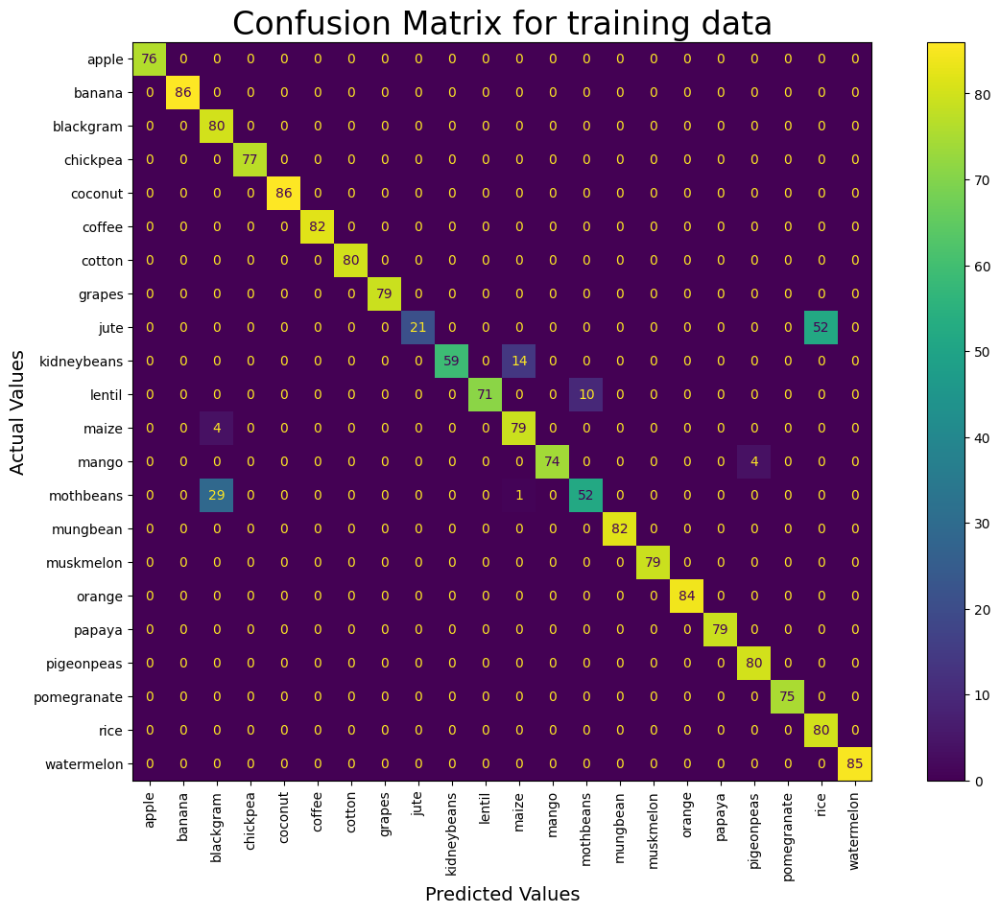

In [81]:
# Accuray On Training Data
decision_predict_train = dt_pipeline.predict(X_train)
decision_accuracy_train = accuracy_score(y_train, decision_predict_train)
print(f"Accuracy on Training Data: {decision_accuracy_train * 100:.2f}%")
# Precision on Training Data
print(f"Precision on Training Data (Macro average): {precision_score(y_train, decision_predict_train, average='macro') * 100:.2f}%")
#Recall on training data
print(f"Recall on Training Data (Macro average): {recall_score( y_train, decision_predict_train, average = 'macro') * 100:.2f}%")
# F1 score on training data
print(f"F1 score on Training Data (Macro average): {f1_score( y_train, decision_predict_train, average = 'macro') * 100:.2f}%")

# View Confusion Matrix
cm = confusion_matrix(y_train, decision_predict_train)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in dt_pipeline.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for training data", fontsize=24)
plt.xlabel("Predicted Values", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

Accuracy on Test Data: 91.82%
Precision on Test Data (Macro Average): 94.29 %
Recall on Test Data (Macro Average): 93.16 %
F1 score on Test Data (Macro Average): 91.93 %


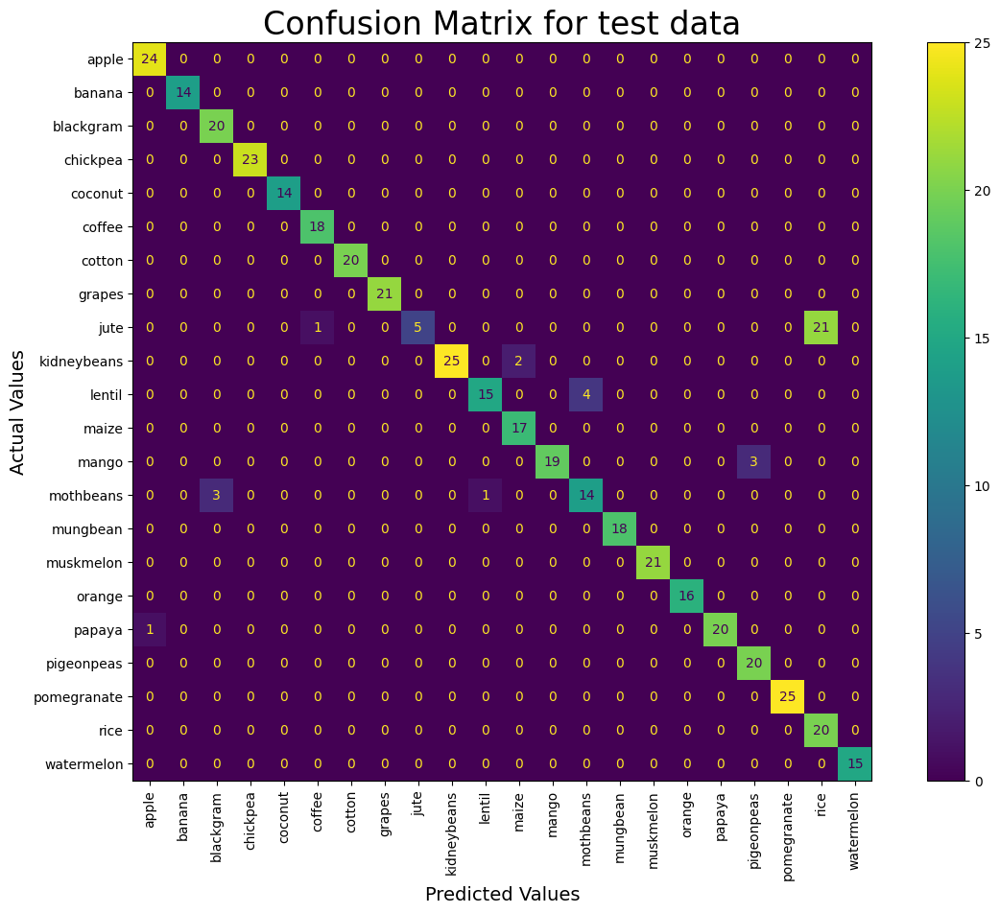

In [82]:
# Accuray On Test Data
decision_predict_test = dt_pipeline.predict(X_test)
decision_accuracy_test = accuracy_score(y_test, decision_predict_test)
print(f"Accuracy on Test Data: {decision_accuracy_test * 100:.2f}%")

# Precision on Test Data
decision_precision = precision_score(y_test, decision_predict_test, average="macro")
print("Precision on Test Data (Macro Average): {:.2f} %".format(decision_precision * 100))

# Recall on Test data
decision_recall = recall_score(y_test, decision_predict_test, average="macro")
print("Recall on Test Data (Macro Average): {:.2f} %".format(decision_recall * 100))

# F1 score on Test data
decision_f1 = f1_score(y_test, decision_predict_test, average='macro')
print("F1 score on Test Data (Macro Average): {:.2f} %".format(decision_f1 * 100))

# View Confusion Matrix
cm = confusion_matrix(y_test, decision_predict_test)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in dt_pipeline.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for test data", fontsize=24)
plt.xlabel("Predicted Values", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

In [36]:
# Get the unique classes from the 'label' column and convert them into a list
unique_classes = copied_df['label'].unique().tolist()

# Print the list of unique classes
print(unique_classes)


['rice', 'maize', 'chickpea', 'kidneybeans', 'pigeonpeas', 'mothbeans', 'mungbean', 'blackgram', 'lentil', 'pomegranate', 'banana', 'mango', 'grapes', 'watermelon', 'muskmelon', 'apple', 'orange', 'papaya', 'coconut', 'cotton', 'jute', 'coffee']


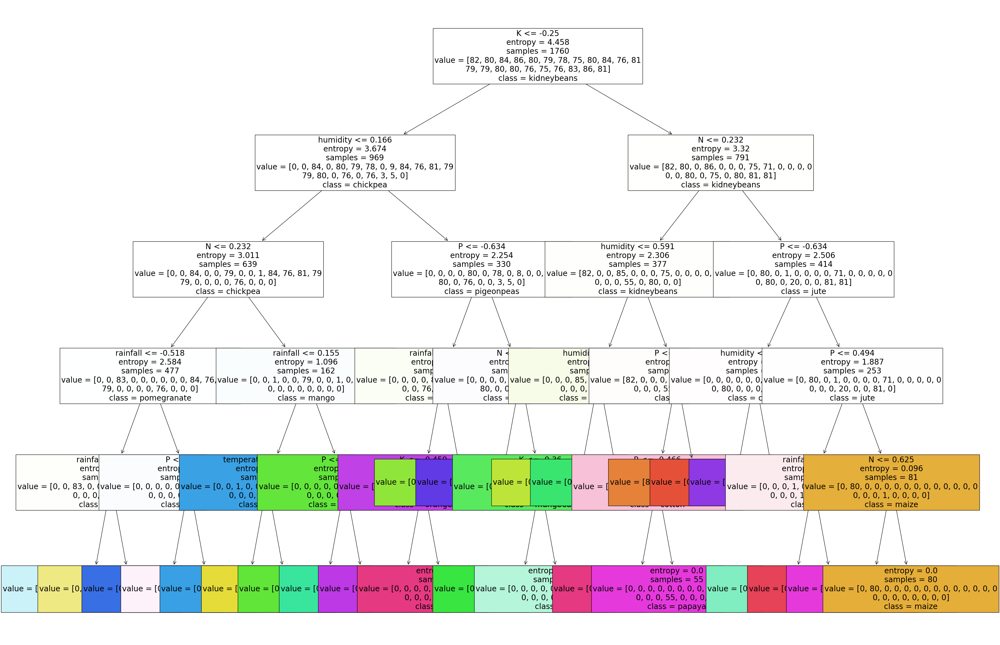

In [37]:
# VISUALIZING THE CLASSIFIER
from sklearn.tree import plot_tree

# Access the DecisionTreeClassifier within the pipeline
dt_classifier = dt_pipeline.named_steps['decisiontreeclassifier']

# Display the decision tree
plt.figure(figsize=(40, 30))
plot_tree(dt_classifier, filled=True, feature_names=selected_features, class_names=unique_classes,fontsize=20)
plt.show()


### 2. RANDOM FOREST CLASSIFIER

In [68]:
from sklearn.ensemble import RandomForestClassifier

In [73]:
rf = RandomForestClassifier(n_estimators=15, random_state=0 )

# Fit Dataset in Model
rf.fit(X_train, y_train)

RandomForestClassifier(n_estimators=15, random_state=0)

In [74]:
# Prediction of Train and Test Dataset
random_predict_train = rf.predict(X_train)
random_predict_test = rf.predict(X_test)

Accuracy on Training Data : 99.87 %
Precision on Training Data (Macro average): 99.88 %
Recall on Training Data (Macro average): 99.86 %
F1 score on Training Data (Macro average): 99.87%


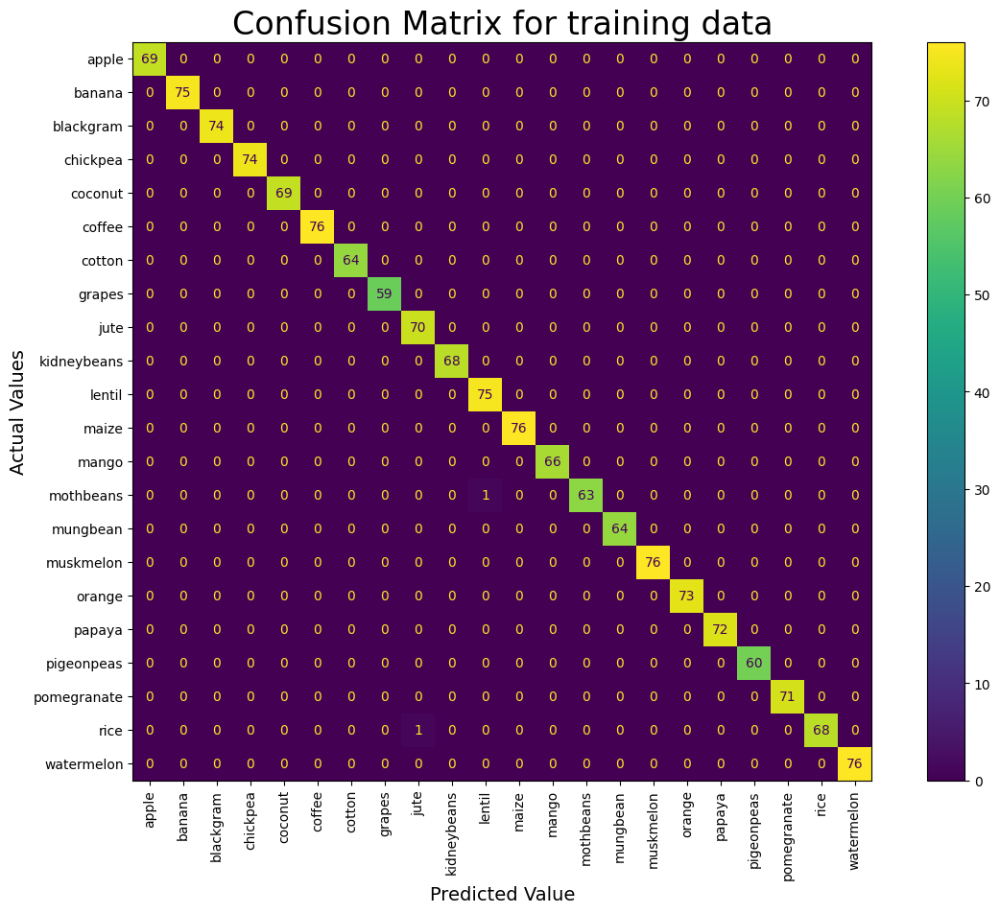

In [30]:
# Accuracy of Training Data
print("Accuracy on Training Data : {:.2f} %".format(accuracy_score( y_train, random_predict_train) * 100) )
print("Precision on Training Data (Macro average): {:.2f} %".format(precision_score( y_train, random_predict_train, average = "macro") * 100) )
print("Recall on Training Data (Macro average): {:.2f} %".format(recall_score( y_train, random_predict_train, average = "macro") * 100) )
print(f"F1 score on Training Data (Macro average): {f1_score( y_train, random_predict_train, average = 'macro') * 100:.2f}%")
# Visualising Confusion Matrix
cm = confusion_matrix(y_train, random_predict_train)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in rf.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for training data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()


Accuracy on Test Data: 99.39 %
Precision on Test Data (Macro Average): 99.30 %
Recall on Test Data (Macro Average): 99.36 %
F1 score on Test Data (Macro Average): 99.32 %


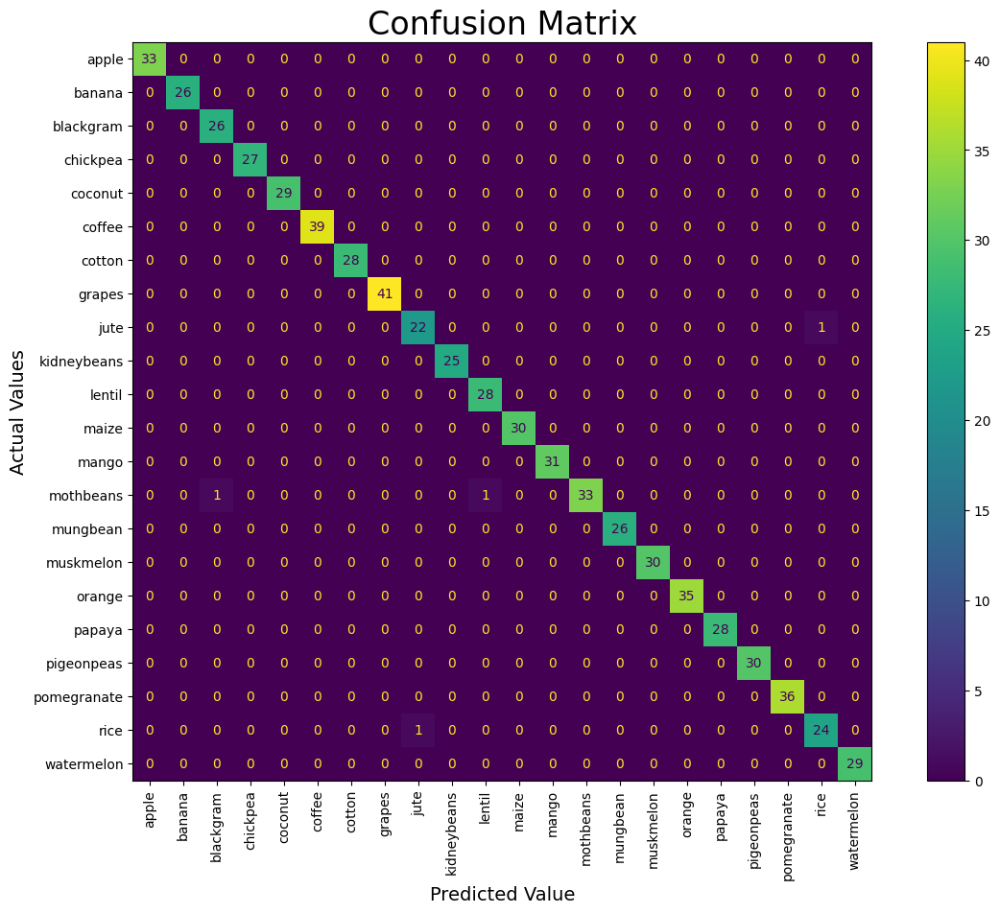

In [75]:
# Accuracy of Testing Dataset
random_accuracy = accuracy_score(y_test, random_predict_test)
print("Accuracy on Test Data: {:.2f} %".format(random_accuracy * 100))

# Precision on Testing Dataset
random_precision = precision_score(y_test, random_predict_test, average="macro")
print("Precision on Test Data (Macro Average): {:.2f} %".format(random_precision * 100))

# Recall on Testing Dataset
random_recall = recall_score(y_test, random_predict_test, average="macro")
print("Recall on Test Data (Macro Average): {:.2f} %".format(random_recall * 100))

# F1 score
random_f1 = f1_score(y_test, random_predict_test, average="macro")
print("F1 score on Test Data (Macro Average): {:.2f} %".format(random_f1 * 100))


# Confusion Matrix
cm = confusion_matrix(y_test,random_predict_test)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in rf.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

In [14]:
from sklearn.ensemble import VotingClassifier

n = 5

# Creating a list to hold the Random Forest classifiers
random_forest_classifiers = []

# Creating 'n' different Random Forest classifiers
for i in range(n):
    random_forest = RandomForestClassifier(n_estimators=100, random_state=i, max_depth = None)  
    random_forest_classifiers.append(('rf{}'.format(i), random_forest))

# Create a Voting Classifier with 'hard' voting (majority rule)
vc = VotingClassifier(estimators=random_forest_classifiers, voting='soft')

vc.fit(X_train,y_train)

VotingClassifier(estimators=[('rf0', RandomForestClassifier(random_state=0)),
                             ('rf1', RandomForestClassifier(random_state=1)),
                             ('rf2', RandomForestClassifier(random_state=2)),
                             ('rf3', RandomForestClassifier(random_state=3)),
                             ('rf4', RandomForestClassifier(random_state=4))],
                 voting='soft')

In [15]:
vc_train = vc.predict(X_train)
vc_test = vc.predict(X_test)

Accuracy on Training Data : 100.00 %
Precision on Training Data (Macro average): 100.00 %
Recall on Training Data (Macro average): 100.00 %
F1 score on Training Data (Macro average): 100.00 %


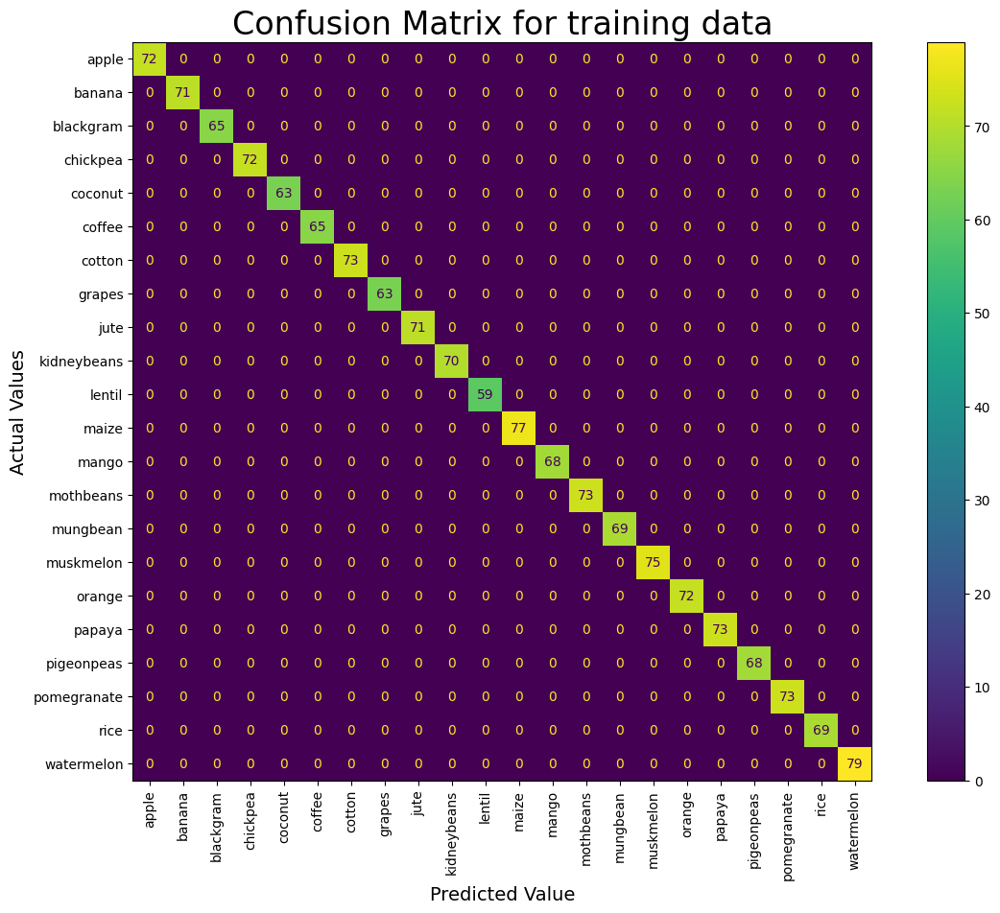

In [16]:
# Accuracy of Training Data
print("Accuracy on Training Data : {:.2f} %".format(accuracy_score( y_train, vc_train) * 100) )
print("Precision on Training Data (Macro average): {:.2f} %".format(precision_score( y_train, vc_train, average = "macro") * 100) )
print("Recall on Training Data (Macro average): {:.2f} %".format(recall_score( y_train, vc_train, average = "macro") * 100) )
print("F1 score on Training Data (Macro average): {:.2f} %".format(f1_score(y_train,vc_train, average = "macro")*100))
# Visualising Confusion Matrix
cm = confusion_matrix(y_train, vc_train)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in vc.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for training data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

Accuracy on Test Data: 99.55 %
Precision on Test Data (Macro Average): 99.57 %
Recall on Test Data (Macro Average): 99.56 %
F1 score on Test Data (Macro Average): 99.55 %


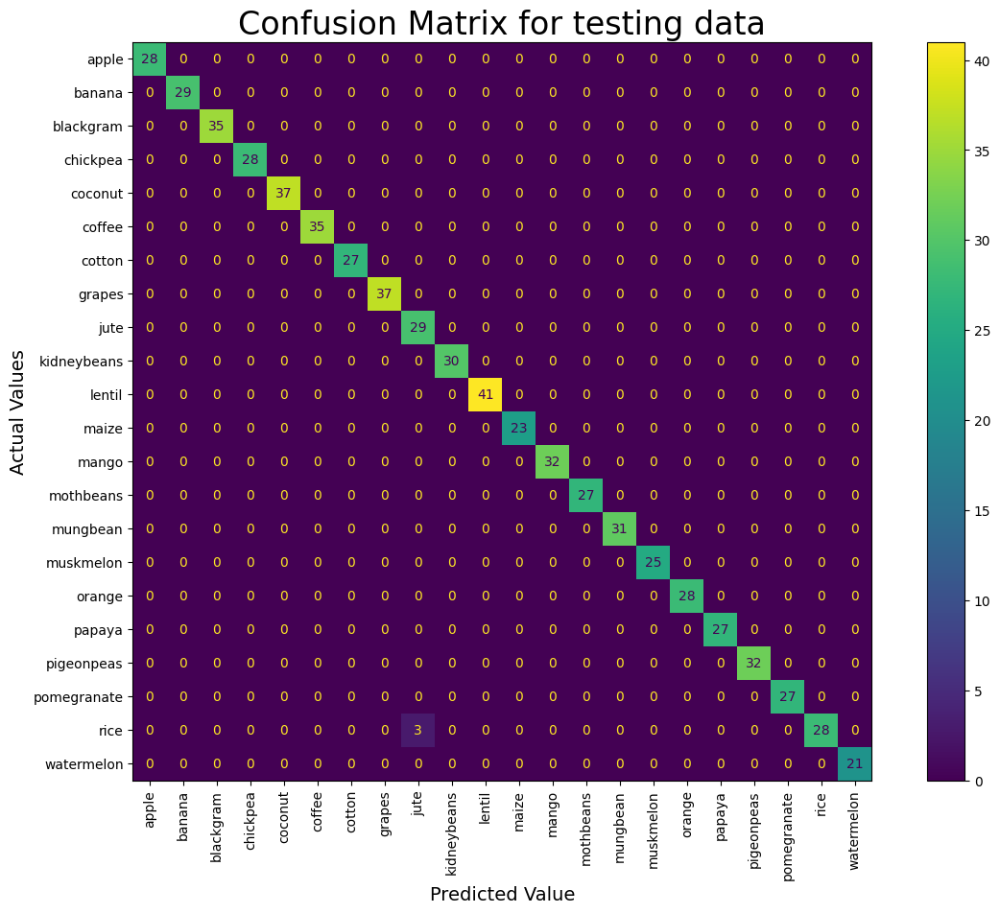

In [17]:
# Accuracy on Test Data
vc_accuracy = accuracy_score(y_test, vc_test)
print("Accuracy on Test Data: {:.2f} %".format(vc_accuracy * 100))

# Precision on Testing Dataset
vc_precision = precision_score(y_test, vc_test, average="macro")
print("Precision on Test Data (Macro Average): {:.2f} %".format(vc_precision * 100))

# Recall on Testing Dataset
vc_recall = recall_score(y_test, vc_test, average="macro")
print("Recall on Test Data (Macro Average): {:.2f} %".format(vc_recall * 100))

# F1 score
vc_f1 = f1_score(y_test, vc_test, average="macro")
print("F1 score on Test Data (Macro Average): {:.2f} %".format(vc_f1 * 100))


# Confusion Matrix
cm = confusion_matrix(y_test, vc_test)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in vc.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for testing data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

In [18]:
from sklearn.ensemble import StackingClassifier

# Creating a list to hold the Random Forest classifiers
random_forest_classifiers = []
n = 5
# Creating 'n' different Random Forest classifiers
for i in range(n):
    random_forest = RandomForestClassifier(n_estimators=15*(i+1), random_state=i, max_depth = None)  
    random_forest_classifiers.append(('rf{}'.format(i), rf))

# Creating a StackingClassifier
stack = StackingClassifier(
    estimators=random_forest_classifiers, 
    final_estimator=vc,
    cv=10,
    passthrough=True
)

stack.fit(X_train, y_train)

StackingClassifier(cv=10,
                   estimators=[('rf0',
                                RandomForestClassifier(n_estimators=15,
                                                       random_state=0)),
                               ('rf1',
                                RandomForestClassifier(n_estimators=15,
                                                       random_state=0)),
                               ('rf2',
                                RandomForestClassifier(n_estimators=15,
                                                       random_state=0)),
                               ('rf3',
                                RandomForestClassifier(n_estimators=15,
                                                       random_state=0)),
                               ('rf4',
                                RandomForestClassifier(n_estimators=15,
                                                       random_state=0))],
                   final_estimator=VotingClassifier(estimators=[('rf0',
                                                                 RandomForestClassifier(random_state=0)),
                                                                ('rf1',
                                                                 RandomForestClassifier(random_state=1)),
                                                                ('rf2',
                                                                 RandomForestClassifier(random_state=2)),
                                                                ('rf3',
                                                                 RandomForestClassifier(random_state=3)),
                                                                ('rf4',
                                                                 RandomForestClassifier(random_state=4))],
                                                    voting='soft'),
                   passthrough=True)

In [19]:
stack_train = stack.predict(X_train)
stack_test = stack.predict(X_test)

Accuracy on Training Data : 100.00 %
Precision on Training Data (Macro average): 100.00 %
Recall on Training Data (Macro average): 100.00 %
F1 score on Training Data (Macro average): 100.00 %


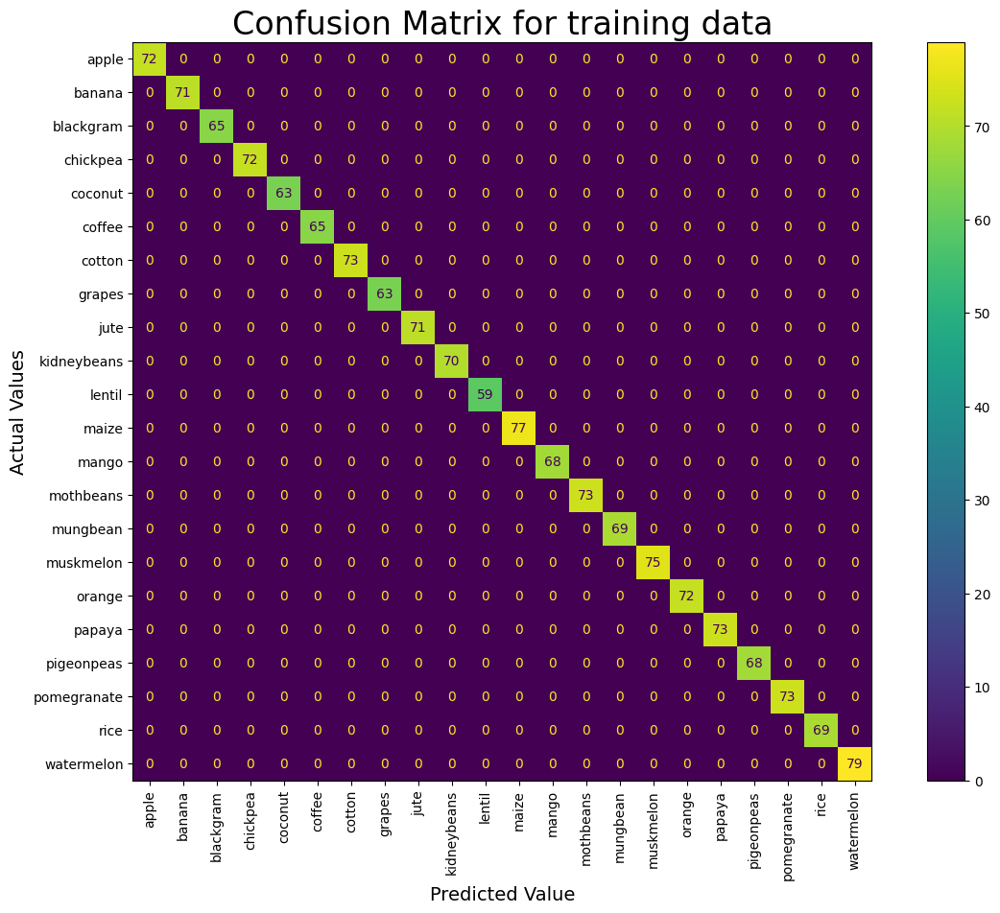

In [20]:
# Accuracy of Training Data
print("Accuracy on Training Data : {:.2f} %".format(accuracy_score( y_train, stack_train) * 100) )
print("Precision on Training Data (Macro average): {:.2f} %".format(precision_score( y_train, stack_train, average = "macro") * 100) )
print("Recall on Training Data (Macro average): {:.2f} %".format(recall_score( y_train, stack_train, average = "macro") * 100) )
print("F1 score on Training Data (Macro average): {:.2f} %".format(f1_score(y_train,stack_train, average = "macro")*100))
# Visualising Confusion Matrix
cm = confusion_matrix(y_train, stack_train)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in stack.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for training data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

Accuracy on Test Data: 99.39 %
Precision on Test Data (Macro Average): 99.45 %
Recall on Test Data (Macro Average): 99.41 %
F1 score on Test Data (Macro Average): 99.39 %


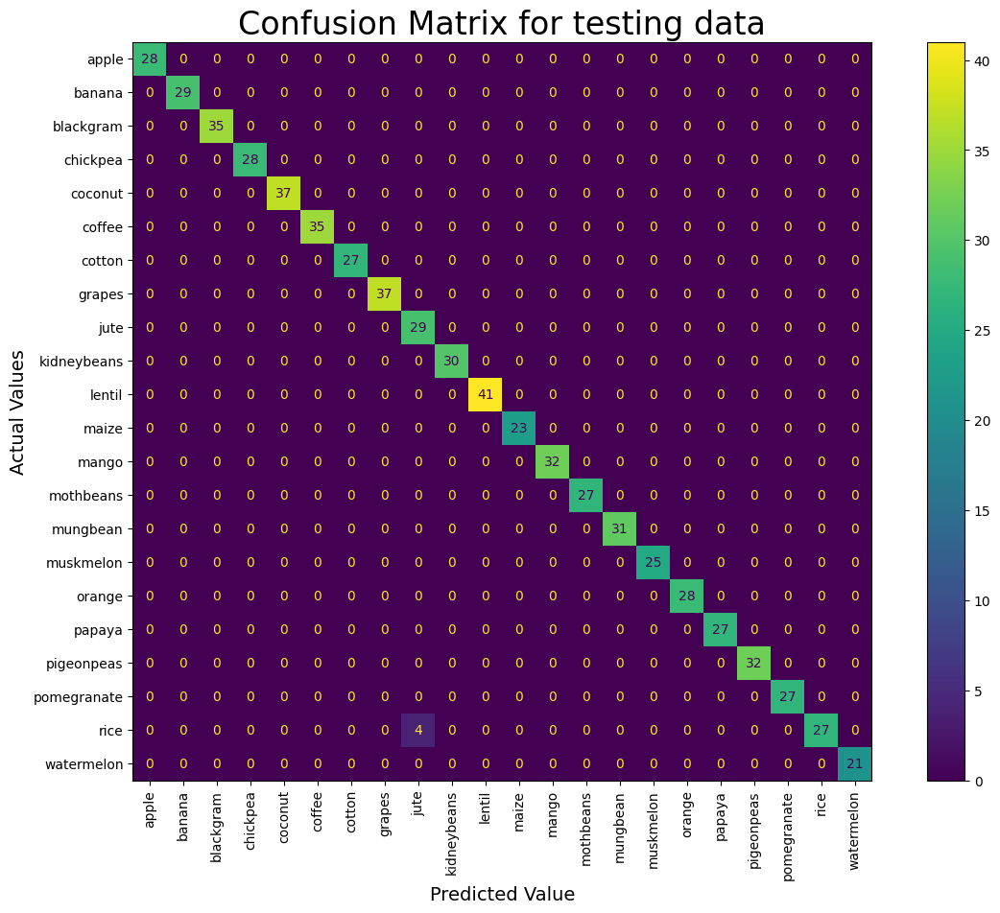

In [21]:
# Accuracy on Test Data
stack_accuracy = accuracy_score(y_test, stack_test)
print("Accuracy on Test Data: {:.2f} %".format(stack_accuracy * 100))

# Precision on Testing Dataset
stack_precision = precision_score(y_test, stack_test, average="macro")
print("Precision on Test Data (Macro Average): {:.2f} %".format(stack_precision * 100))

# Recall on Testing Dataset
stack_recall = recall_score(y_test, stack_test, average="macro")
print("Recall on Test Data (Macro Average): {:.2f} %".format(stack_recall * 100))

# F1 score
stack_f1 = f1_score(y_test, stack_test, average="macro")
print("F1 score on Test Data (Macro Average): {:.2f} %".format(stack_f1 * 100))


# Confusion Matrix
cm = confusion_matrix(y_test, stack_test)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in stack.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for testing data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

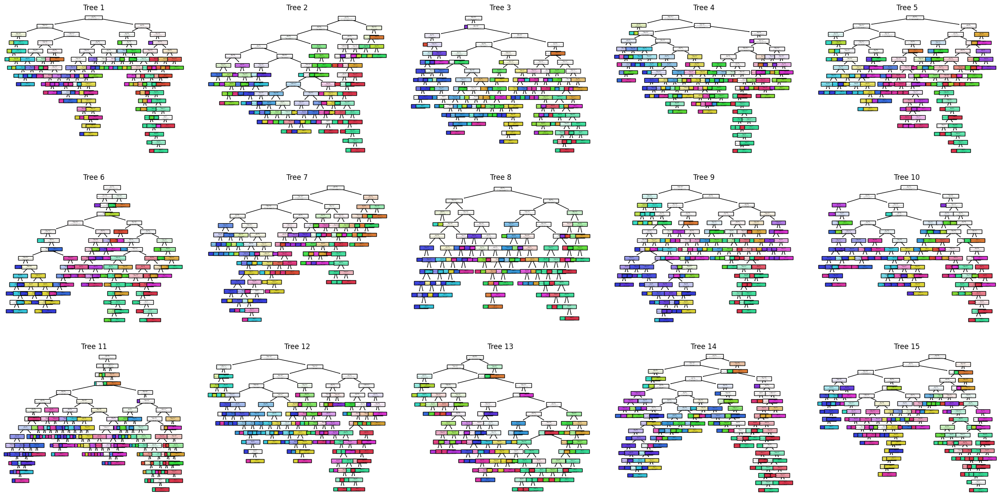

In [43]:
# VISUALIZING THE CLASSIFIER
from sklearn.tree import plot_tree
# Accessing individual trees using 'estimators_' attribute
n_estimators = len(rf.estimators_)

# Specify a larger figure size for the plot
plt.figure(figsize=(30, 20))

# Adjust the subplot layout based on the number of trees
num_rows = int(n_estimators / 5) + 1
num_cols = 5

# Loop through each estimator (tree) and plot it
for i in range(n_estimators):
    plt.subplot(num_rows, num_cols, i + 1)  # Adjust the subplot layout as needed
    plot_tree(rf.estimators_[i], filled=True, feature_names=selected_features, class_names=unique_classes)
    plt.title(f'Tree {i+1}')

plt.show()

In [44]:
# TO STUDY ONE SINGLE TREE AT A TIME

# Taking user input as the tree number
tree_num = int(input("ENTER THE TREE NUMBER FROM 1 TO " + str(len(rf.estimators_)) + " THAT YOU WANT TO VISUALIZE:"))

# VISUALIZE THE INDIVIDUAL TREE THAT THE USER WANTS TO SEE
plt.figure(figsize=(90,90))  # Adjust the figure size as needed
plot_tree(rf.estimators_[tree_num-1], filled=True, feature_names=selected_features, class_names=unique_classes, fontsize = 35)
plt.title(f'Tree {tree_num}', fontsize=16)
plt.show()


ENTER THE TREE NUMBER FROM 1 TO 15 THAT YOU WANT TO VISUALIZE: 13


### 3. MULTINOMIAL LOGISTIC REGRESSION

In [83]:
from sklearn.linear_model import LogisticRegression
clf = LogisticRegression(multi_class='multinomial')
clf.fit(X_train,y_train) #Fit the dataset into the model for training

LogisticRegression(multi_class='multinomial')

In [84]:
logistic_predict_train = clf.predict(X_train)
logistic_predict_test = clf.predict(X_test)

Accuracy on Training Data : 97.10 %
Precision on Training Data (Macro average): 97.10 %
Recall on Training Data (Macro average): 97.09 %
F1 score on Training Data (Macro average): 97.08 %


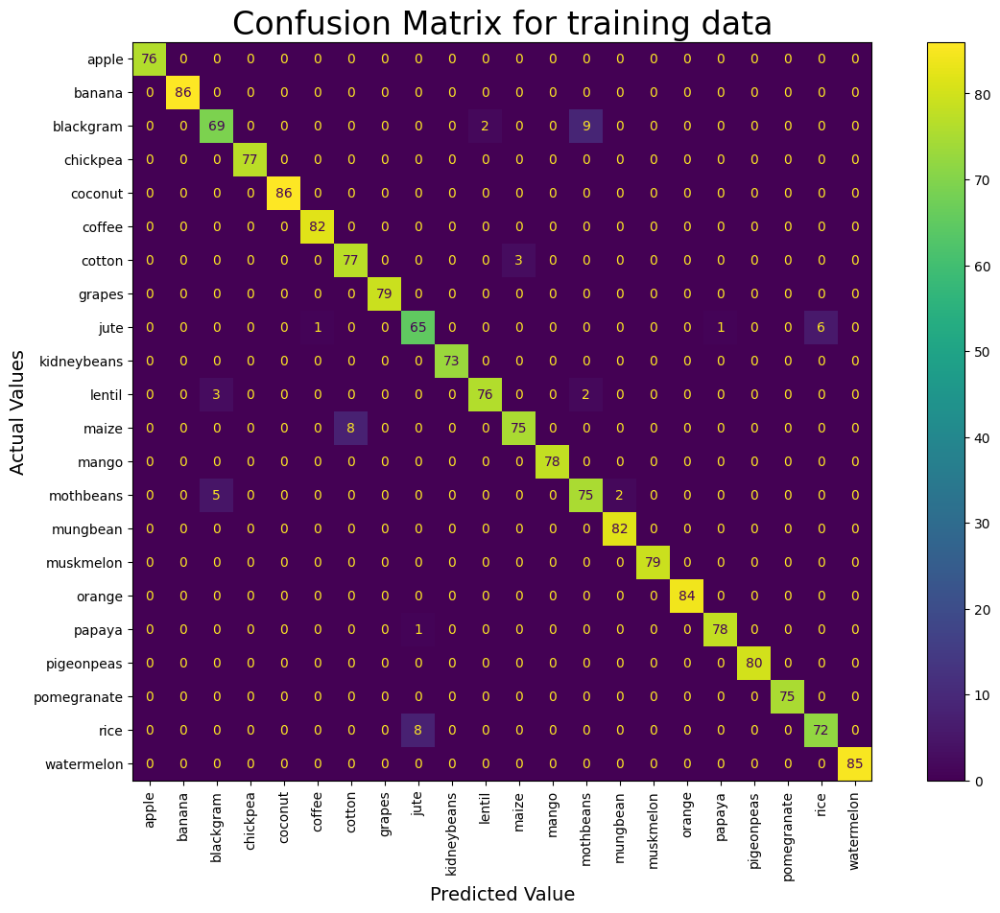

In [85]:
# Accuracy of Training Data
print("Accuracy on Training Data : {:.2f} %".format(accuracy_score( y_train, logistic_predict_train) * 100) )
print("Precision on Training Data (Macro average): {:.2f} %".format(precision_score( y_train, logistic_predict_train, average = "macro") * 100) )
print("Recall on Training Data (Macro average): {:.2f} %".format(recall_score( y_train, logistic_predict_train, average = "macro") * 100))
print("F1 score on Training Data (Macro average): {:.2f} %".format(f1_score(y_train,logistic_predict_train,average = "macro")*100))
# Visualising Confusion Matrix
cm = confusion_matrix(y_train, logistic_predict_train)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in clf.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for training data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()


Accuracy on Test Data: 95.23 %
Precision on Test Data (Macro Average): 95.56 %
Recall on Test Data (Macro Average): 95.32 %
F1 score on Test Data (Macro Average): 95.40 %


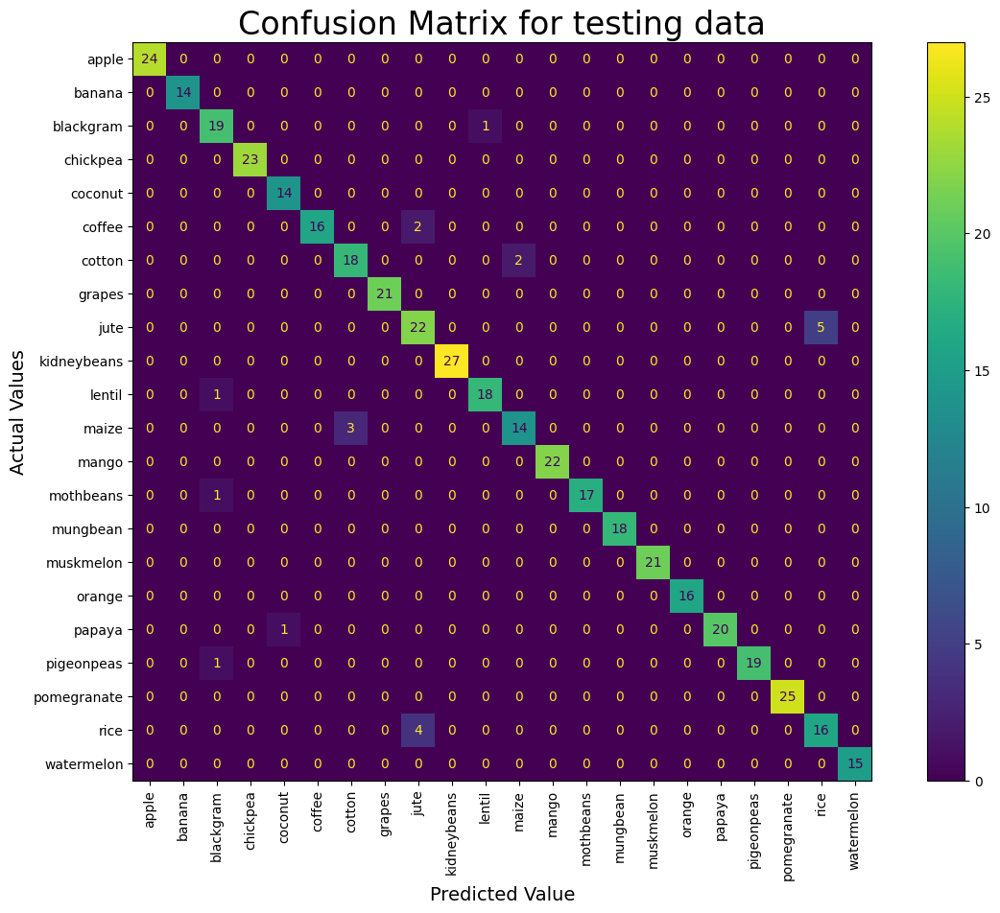

In [86]:
# Accuracy of Testing Dataset
softmax_accuracy = accuracy_score(y_test, logistic_predict_test)
print("Accuracy on Test Data: {:.2f} %".format(softmax_accuracy * 100))

# Precision on Testing Dataset
softmax_precision = precision_score(y_test, logistic_predict_test, average="macro")
print("Precision on Test Data (Macro Average): {:.2f} %".format(softmax_precision * 100))

# Recall on Testing Dataset
softmax_recall = recall_score(y_test, logistic_predict_test, average="macro")
print("Recall on Test Data (Macro Average): {:.2f} %".format(softmax_recall * 100))

# F1 score
softmax_f1 = f1_score(y_test, logistic_predict_test, average="macro")
print("F1 score on Test Data (Macro Average): {:.2f} %".format(softmax_f1 * 100))


# Confusion Matrix
cm = confusion_matrix(y_test, logistic_predict_test)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in clf.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for testing data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

### 4. SUPPORT VECTOR MACHINES

In [49]:
from sklearn.svm import SVC

#### FOR LINEAR KERNEL

In [50]:
support_vector_classifier = SVC(kernel="linear")
support_vector_classifier.fit(X_train, y_train.ravel())

SVC(kernel='linear')

In [51]:
svm_predict_train = support_vector_classifier.predict(X_train)
svm_predict_test = support_vector_classifier.predict(X_test)

Accuracy on Training Data : 99.43 %
Precision on Training Data (Macro average): 99.45 %
Recall on Training Data (Macro average): 99.46 %
F1 score on Training Data (Macro average): 99.45 %


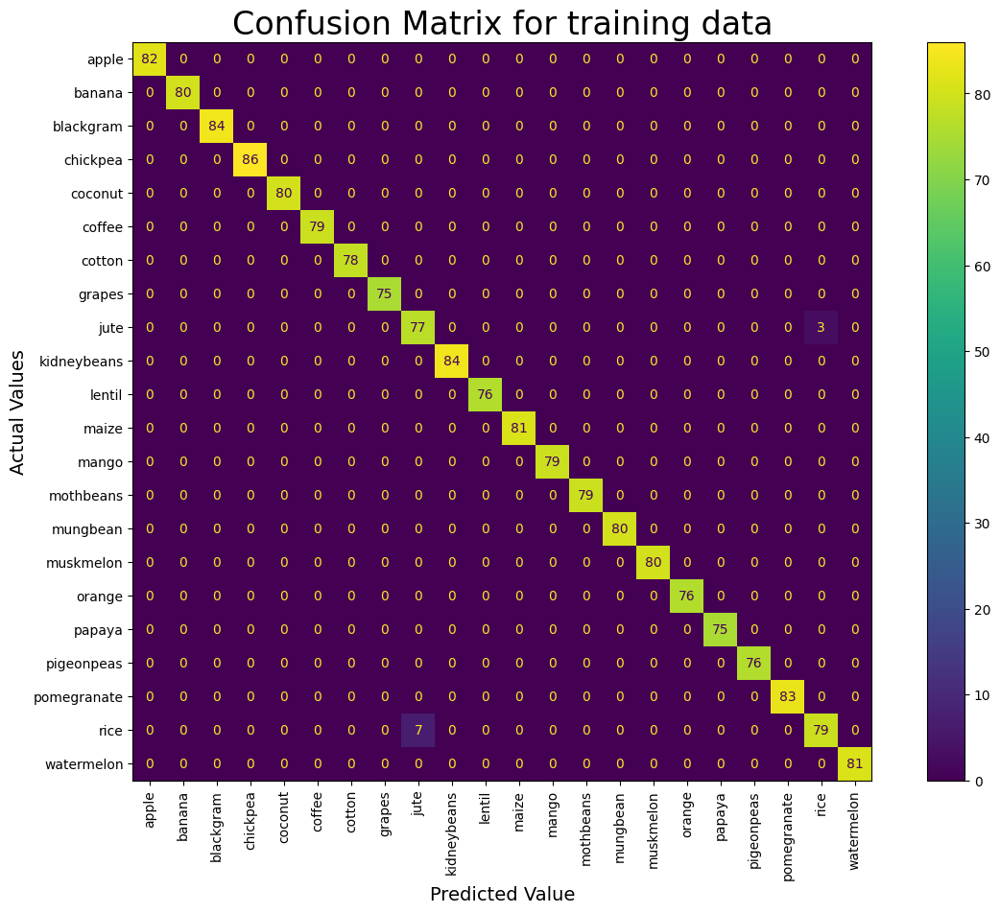

In [52]:
# Accuracy of Training Data
print("Accuracy on Training Data : {:.2f} %".format(accuracy_score( y_train, svm_predict_train) * 100) )
print("Precision on Training Data (Macro average): {:.2f} %".format(precision_score( y_train, svm_predict_train, average = "macro") * 100) )
print("Recall on Training Data (Macro average): {:.2f} %".format(recall_score( y_train, svm_predict_train, average = "macro") * 100) )
print("F1 score on Training Data (Macro average): {:.2f} %".format(f1_score(y_train,svm_predict_train,average = "macro")*100))
# Visualising Confusion Matrix
cm = confusion_matrix(y_train, svm_predict_train)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in support_vector_classifier.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for training data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()


Accuracy on Test Data: 98.86 %
Precision on Test Data (Macro Average): 98.80 %
Recall on Test Data (Macro Average): 98.57 %
F1 score on Test Data (Macro Average): 98.66 %


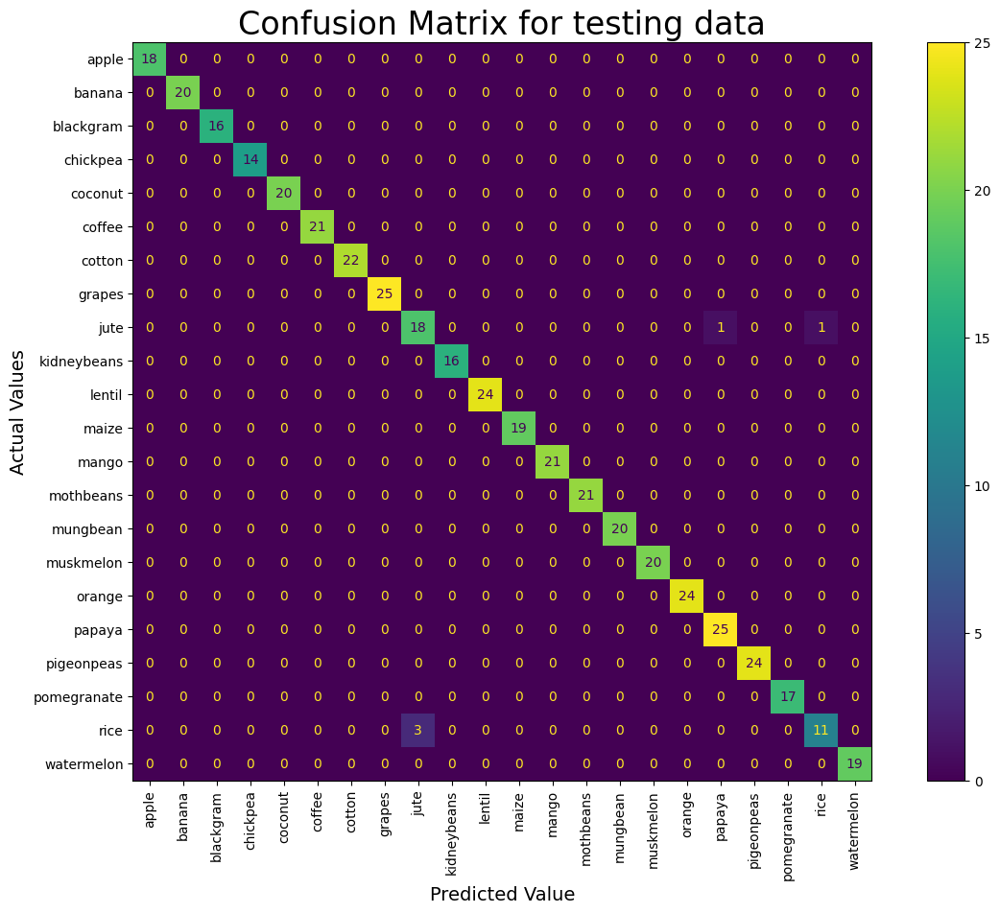

In [53]:
# Accuracy on Test Data
svm_accuracy = accuracy_score(y_test, svm_predict_test)
print("Accuracy on Test Data: {:.2f} %".format(svm_accuracy * 100))

# Precision on Testing Dataset
svm_precision = precision_score(y_test, svm_predict_test, average="macro")
print("Precision on Test Data (Macro Average): {:.2f} %".format(svm_precision * 100))

# Recall on Testing Dataset
svm_recall = recall_score(y_test, svm_predict_test, average="macro")
print("Recall on Test Data (Macro Average): {:.2f} %".format(svm_recall * 100))

# F1 score
svm_f1 = f1_score(y_test, svm_predict_test, average="macro")
print("F1 score on Test Data (Macro Average): {:.2f} %".format(svm_f1 * 100))


# Confusion Matrix
cm = confusion_matrix(y_test, svm_predict_test)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in support_vector_classifier.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for testing data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

#### FOR POLYNOMIAL KERNEL 

In [87]:
polysvm_classifier = SVC(kernel="poly",degree=5)
polysvm_classifier.fit(X_train, y_train)

SVC(degree=5, kernel='poly')

In [88]:
polysvm_predict_train = polysvm_classifier.predict(X_train)
polysvm_predict_test = polysvm_classifier.predict(X_test)

Accuracy on Training Data : 99.03 %
Precision on Training Data (Macro average): 99.01 %
Recall on Training Data (Macro average): 99.01 %
F1 score on Training Data (Macro average): 98.99 %


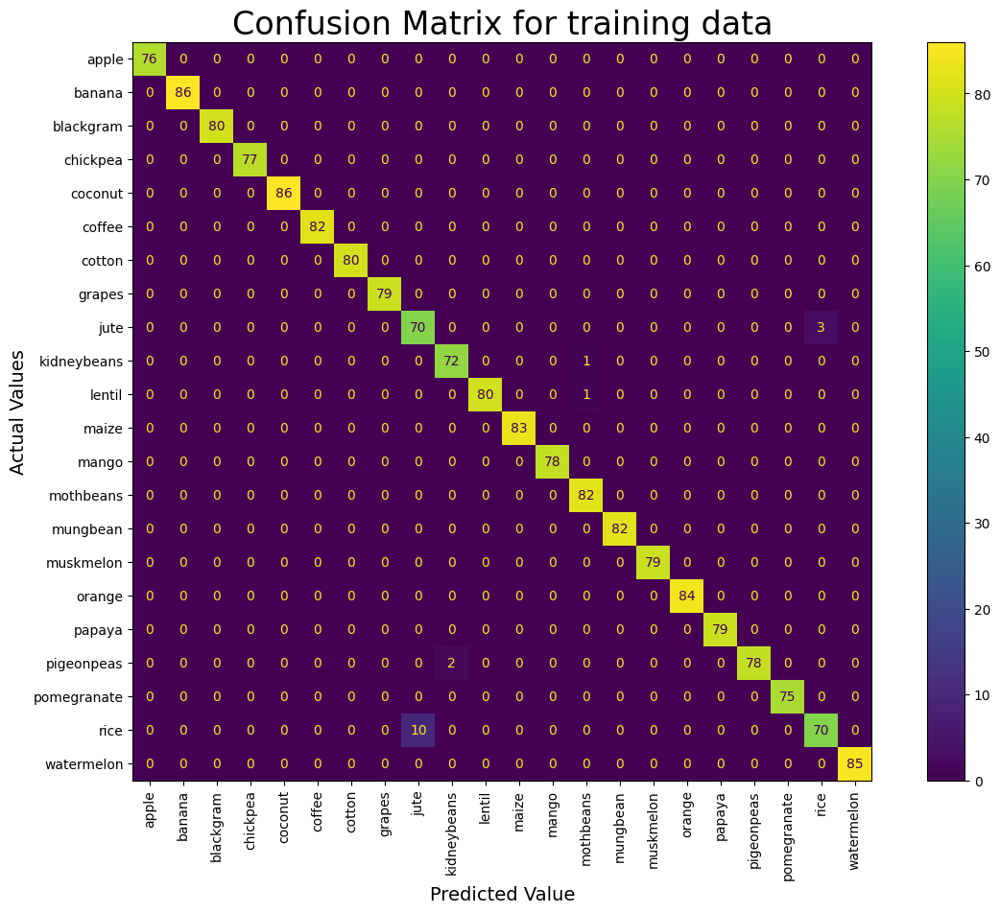

In [89]:
# Accuracy of Training Data
print("Accuracy on Training Data : {:.2f} %".format(accuracy_score( y_train, polysvm_predict_train) * 100) )
print("Precision on Training Data (Macro average): {:.2f} %".format(precision_score( y_train, polysvm_predict_train, average = "macro") * 100) )
print("Recall on Training Data (Macro average): {:.2f} %".format(recall_score( y_train, polysvm_predict_train, average = "macro") * 100) )
print("F1 score on Training Data (Macro average): {:.2f} %".format(f1_score(y_train,polysvm_predict_train,average = "macro") * 100))
# Visualising Confusion Matrix
cm = confusion_matrix(y_train, polysvm_predict_train)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in polysvm_classifier.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for training data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()


Accuracy on Test Data: 98.18 %
Precision on Test Data (Macro Average): 98.28 %
Recall on Test Data (Macro Average): 98.25 %
F1 score on Test Data (Macro Average): 98.24 %


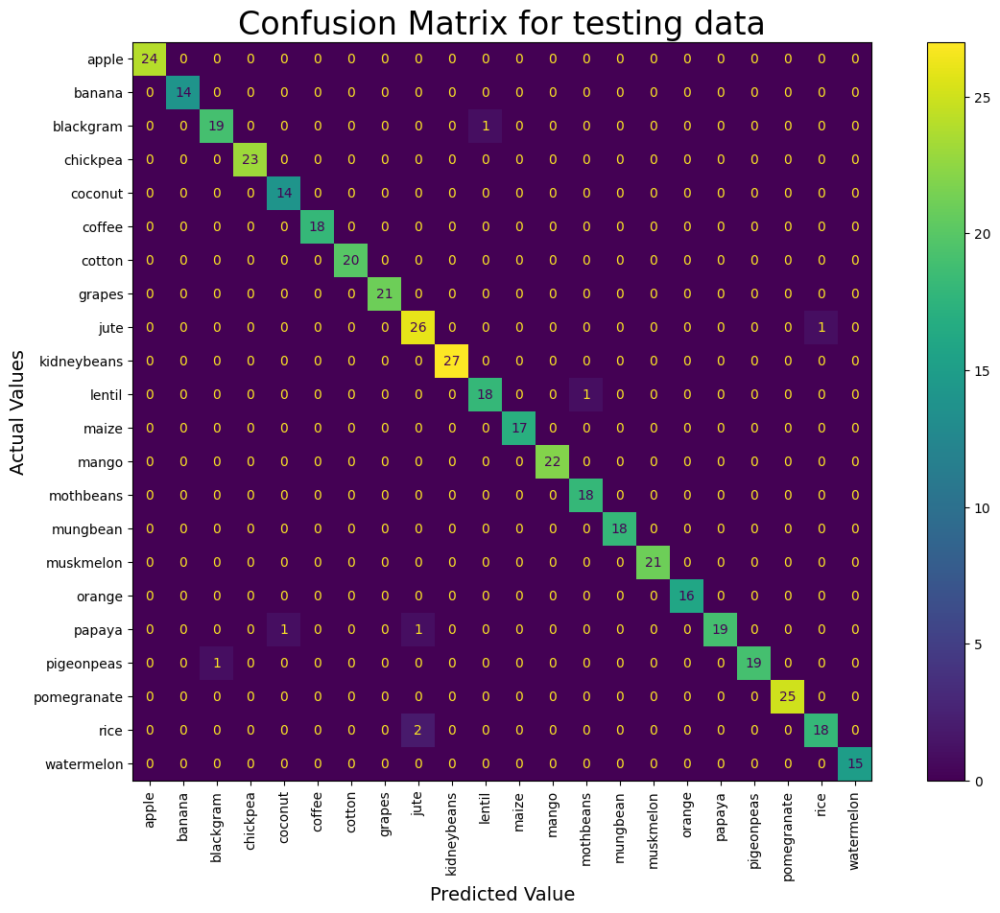

In [90]:
# Accuracy on Test Data
polysvm_accuracy = accuracy_score(y_test, polysvm_predict_test)
print("Accuracy on Test Data: {:.2f} %".format(polysvm_accuracy * 100))

# Precision on Testing Dataset
polysvm_precision = precision_score(y_test, polysvm_predict_test, average="macro")
print("Precision on Test Data (Macro Average): {:.2f} %".format(polysvm_precision * 100))

# Recall on Testing Dataset
polysvm_recall = recall_score(y_test, polysvm_predict_test, average="macro")
print("Recall on Test Data (Macro Average): {:.2f} %".format(polysvm_recall * 100))

# F1 score
polysvm_f1 = f1_score(y_test, polysvm_predict_test, average="macro")
print("F1 score on Test Data (Macro Average): {:.2f} %".format(polysvm_f1 * 100))

# Confusion Matrix
cm = confusion_matrix(y_test, polysvm_predict_test)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in polysvm_classifier.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for testing data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

#### FOR RADIAL BASIS FUNCTION KERNEL

In [91]:
rbf_classifier = SVC(kernel="rbf")
rbf_classifier.fit(X_train, y_train)

SVC()

In [92]:
rbf_predict_train = rbf_classifier.predict(X_train)
rbf_predict_test = rbf_classifier.predict(X_test)

Accuracy on Training Data : 98.01 %
Precision on Training Data (Macro average): 98.14 %
Recall on Training Data (Macro average): 98.03 %
F1 score on Training Data (Macro average): 97.96 %


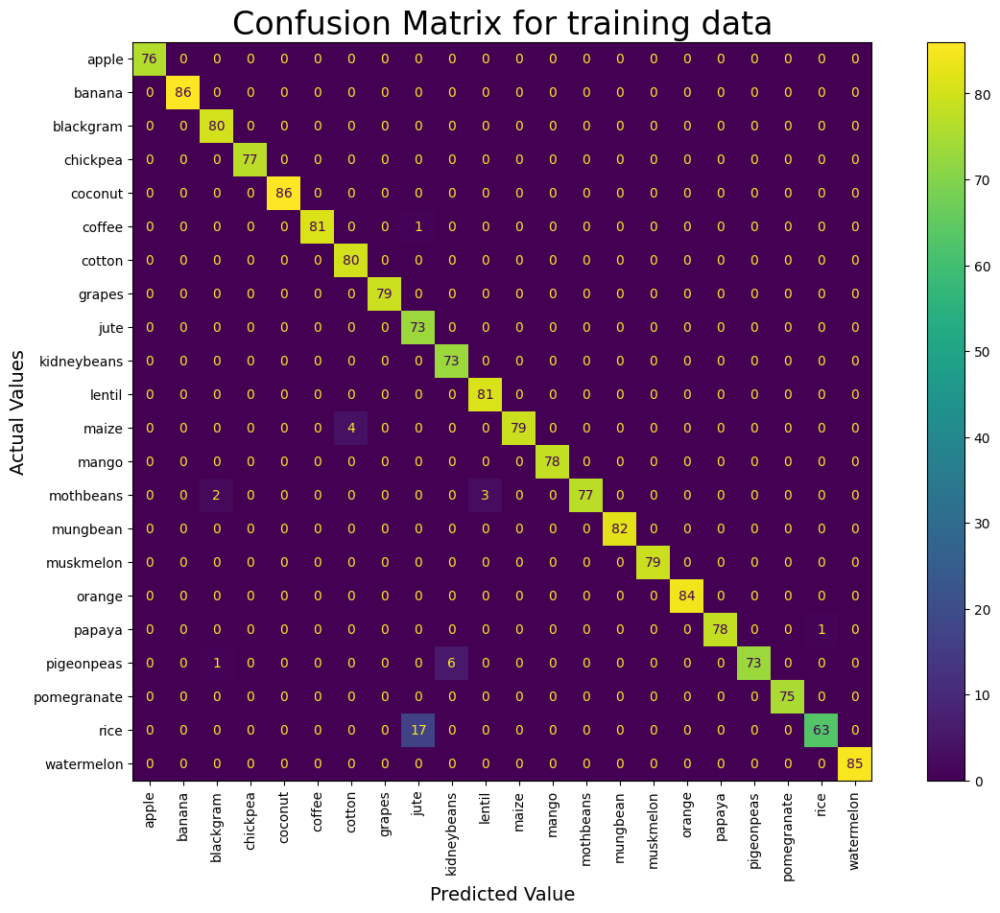

In [93]:
# Accuracy of Training Data
print("Accuracy on Training Data : {:.2f} %".format(accuracy_score( y_train, rbf_predict_train) * 100) )
print("Precision on Training Data (Macro average): {:.2f} %".format(precision_score( y_train, rbf_predict_train, average = "macro") * 100) )
print("Recall on Training Data (Macro average): {:.2f} %".format(recall_score( y_train, rbf_predict_train, average = "macro") * 100) )
print("F1 score on Training Data (Macro average): {:.2f} %".format(f1_score(y_train, rbf_predict_train, average = "macro")*100))
# Visualising Confusion Matrix
cm = confusion_matrix(y_train, rbf_predict_train)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in rbf_classifier.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for training data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()


Accuracy on Test Data: 97.95 %
Precision on Test Data (Macro Average): 98.31 %
Recall on Test Data (Macro Average): 97.89 %
F1 score on Test Data (Macro Average): 98.01 %


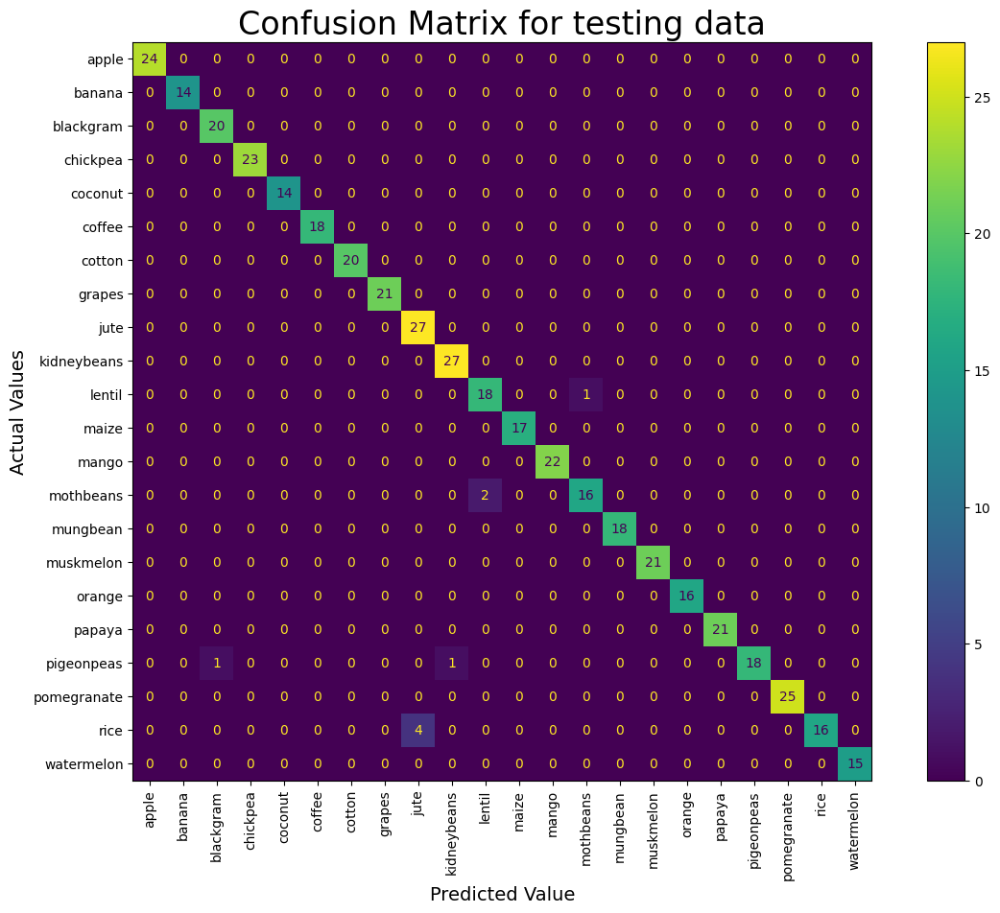

In [94]:
# Accuracy on Test Data
rbf_accuracy = accuracy_score(y_test, rbf_predict_test)
print("Accuracy on Test Data: {:.2f} %".format(rbf_accuracy * 100))

# Precision on Testing Dataset
rbf_precision = precision_score(y_test, rbf_predict_test, average="macro")
print("Precision on Test Data (Macro Average): {:.2f} %".format(rbf_precision * 100))

# Recall on Testing Dataset
rbf_recall = recall_score(y_test, rbf_predict_test, average="macro")
print("Recall on Test Data (Macro Average): {:.2f} %".format(rbf_recall * 100))

# F1 score
rbf_f1 = f1_score(y_test, rbf_predict_test, average="macro")
print("F1 score on Test Data (Macro Average): {:.2f} %".format(rbf_f1 * 100))


# Confusion Matrix
cm = confusion_matrix(y_test, rbf_predict_test)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in rbf_classifier.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for testing data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

#### 5. K-NEAREST NEIGHBOUR

In [95]:
from sklearn.neighbors import KNeighborsClassifier

In [96]:
knn_classifier = KNeighborsClassifier(n_neighbors = 3) # K = 3
knn_classifier.fit(X_train, y_train)

KNeighborsClassifier(n_neighbors=3)

In [97]:
knn_train = knn_classifier.predict(X_train)
knn_test = knn_classifier.predict(X_test)

Accuracy on Training Data : 98.75 %
Precision on Training Data (Macro average): 98.81 %
Recall on Training Data (Macro average): 98.77 %
F1 score on Training Data (Macro average): 98.78 %


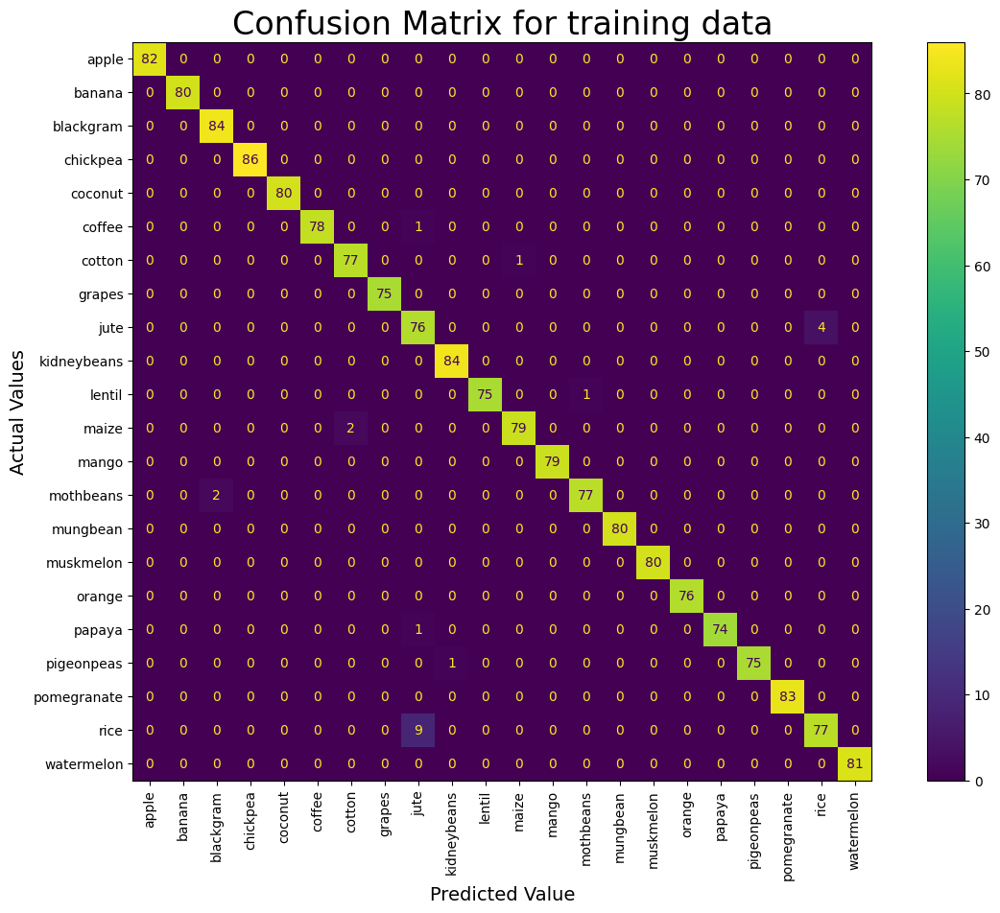

In [65]:
# Accuracy of Training Data
print("Accuracy on Training Data : {:.2f} %".format(accuracy_score( y_train, knn_train) * 100) )
print("Precision on Training Data (Macro average): {:.2f} %".format(precision_score( y_train, knn_train, average = "macro") * 100) )
print("Recall on Training Data (Macro average): {:.2f} %".format(recall_score( y_train, knn_train, average = "macro") * 100) )
print("F1 score on Training Data (Macro average): {:.2f} %".format(f1_score(y_train,knn_train,average = "macro")*100))
# Visualising Confusion Matrix
cm = confusion_matrix(y_train, knn_train)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in knn_classifier.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for training data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()


Accuracy on Test Data: 97.95 %
Precision on Test Data (Macro Average): 97.84 %
Recall on Test Data (Macro Average): 97.90 %
F1 score on Test Data (Macro Average): 97.80 %


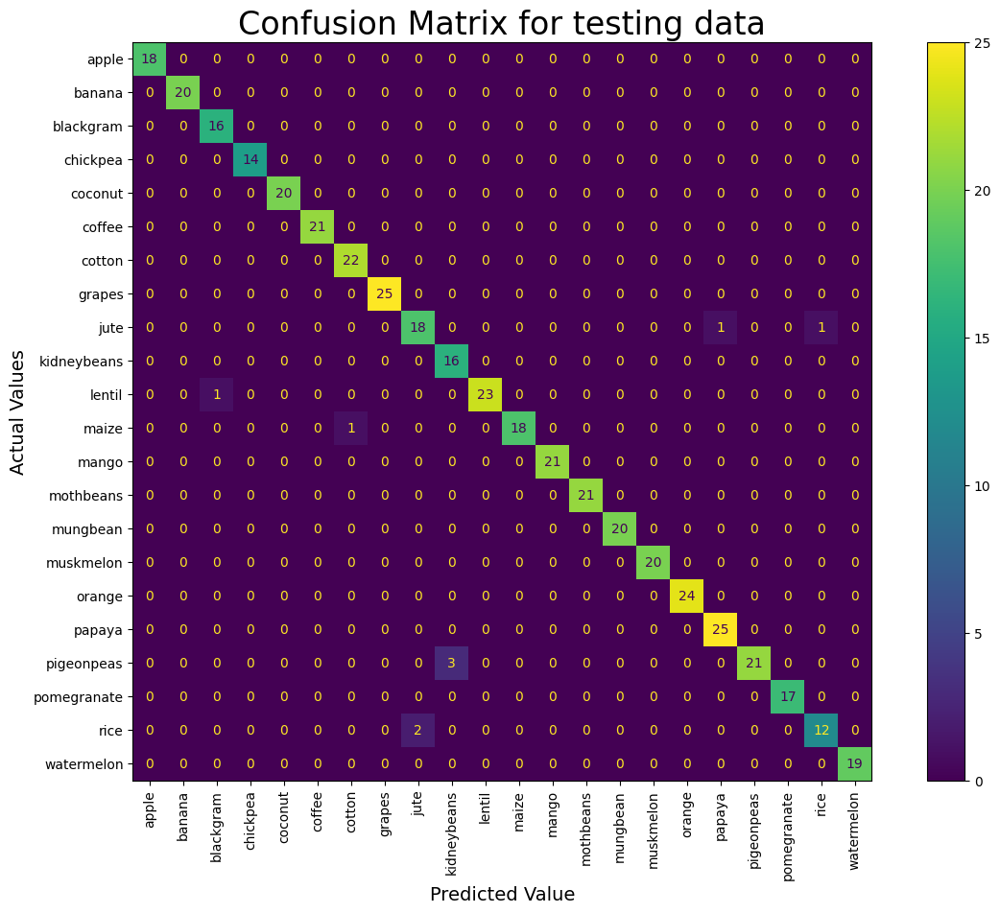

In [66]:
# Accuracy on Test Data
knn_accuracy = accuracy_score(y_test, knn_test)
print("Accuracy on Test Data: {:.2f} %".format(knn_accuracy * 100))

# Precision on Testing Dataset
knn_precision = precision_score(y_test, knn_test, average="macro")
print("Precision on Test Data (Macro Average): {:.2f} %".format(knn_precision * 100))

# Recall on Testing Dataset
knn_recall = recall_score(y_test, knn_test, average="macro")
print("Recall on Test Data (Macro Average): {:.2f} %".format(knn_recall * 100))

# F1 score
knn_f1 = f1_score(y_test, knn_test, average="macro")
print("F1 score on Test Data (Macro Average): {:.2f} %".format(knn_f1 * 100))


# Confusion Matrix
cm = confusion_matrix(y_test, knn_test)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in knn_classifier.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for testing data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

#### 6. CATEGORICAL NAIVE BAYES CLASSIFIER

In [98]:
from sklearn.preprocessing import KBinsDiscretizer
from sklearn.naive_bayes import CategoricalNB

In [99]:
# Specifying the columns to discretize
columns_to_discretize = ['N', 'P', 'K', 'temperature', 'humidity', 'ph', 'rainfall']

# Creating a KBinsDiscretizer to discretize the features
kbins_discretizer = KBinsDiscretizer(n_bins=30, encode='ordinal', strategy='kmeans')
X_discretized = kbins_discretizer.fit_transform(X[columns_to_discretize])
X_discretized

array([[19.,  8., 14., ..., 22., 13., 19.],
       [18., 13., 14., ..., 22., 15., 22.],
       [12., 12., 14., ..., 22., 19., 26.],
       ...,
       [25.,  6., 10., ..., 17., 12., 16.],
       [25.,  6., 11., ..., 12., 14., 11.],
       [22.,  2., 10., ..., 15., 14., 13.]])

In [100]:
# Splitting the discretized dataset
X1_train, X1_test, y1_train, y1_test = train_test_split(X_discretized, y, test_size=0.2)
print(X1_train.shape)
print(X1_test.shape)

(1760, 7)
(440, 7)


In [101]:
# Create and train the Categorical Naive Bayes classifier
catnb = CategoricalNB()
catnb.fit(X1_train, y1_train)

CategoricalNB()

In [102]:
catnb_train = catnb.predict(X1_train)
catnb_test = catnb.predict(X1_test)

Accuracy on Training Data : 99.60 %
Precision on Training Data (Macro average): 99.62 %
Recall on Training Data (Macro average): 99.61 %
F1 score on Training Data (Macro average): 99.61 %


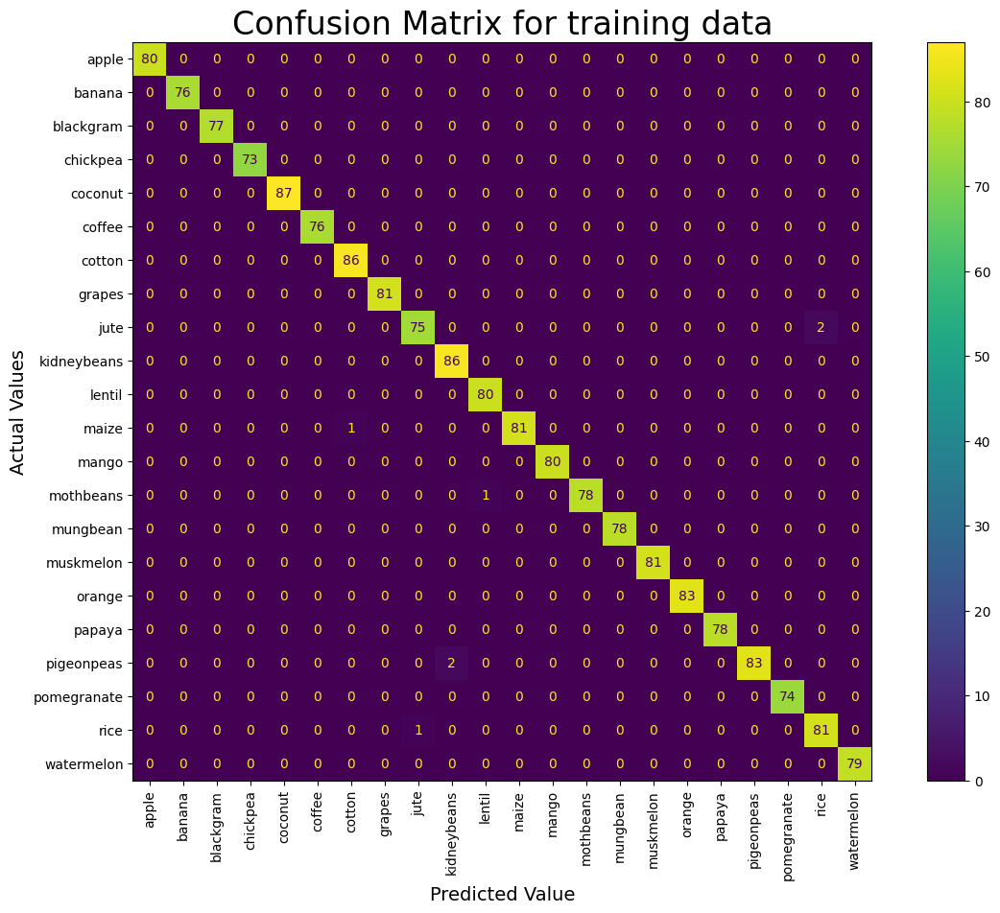

In [103]:
# Accuracy of Training Data
print("Accuracy on Training Data : {:.2f} %".format(accuracy_score( y1_train, catnb_train) * 100) )
print("Precision on Training Data (Macro average): {:.2f} %".format(precision_score( y1_train, catnb_train, average = "macro") * 100) )
print("Recall on Training Data (Macro average): {:.2f} %".format(recall_score( y1_train, catnb_train, average = "macro") * 100) )
print("F1 score on Training Data (Macro average): {:.2f} %".format(f1_score(y1_train,catnb_train, average = "macro")*100))
# Visualising Confusion Matrix
cm = confusion_matrix(y1_train, catnb_train)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in catnb.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for training data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

Accuracy on Test Data: 98.18 %
Precision on Test Data (Macro Average): 98.13 %
Recall on Test Data (Macro Average): 98.26 %
F1 score on Test Data (Macro Average): 98.14 %


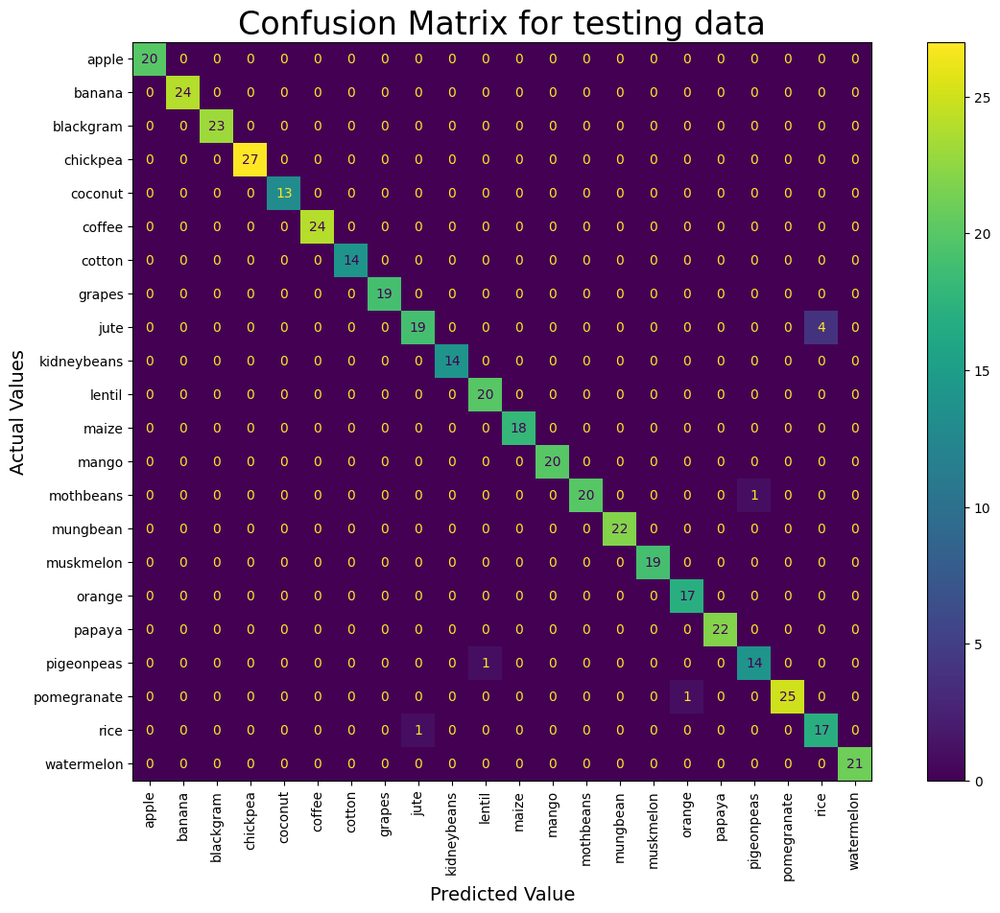

In [104]:
# Accuracy on Test Data
catnb_accuracy = accuracy_score(y1_test, catnb_test)
print("Accuracy on Test Data: {:.2f} %".format(catnb_accuracy * 100))

# Precision on Testing Dataset
catnb_precision = precision_score(y1_test, catnb_test, average="macro")
print("Precision on Test Data (Macro Average): {:.2f} %".format(catnb_precision * 100))

# Recall on Testing Dataset
catnb_recall = recall_score(y1_test, catnb_test, average="macro")
print("Recall on Test Data (Macro Average): {:.2f} %".format(catnb_recall * 100))

# F1 score
catnb_f1 = f1_score(y1_test, catnb_test, average="macro")
print("F1 score on Test Data (Macro Average): {:.2f} %".format(catnb_f1 * 100))


# Confusion Matrix
cm = confusion_matrix(y1_test, catnb_test)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in catnb.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for testing data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

#### 7. EXTREME GRADIENT BOOSTING (XGBoost)

In [105]:
# Import Library
import xgboost
from xgboost import XGBClassifier

xgb_pipeline = make_pipeline( StandardScaler(), XGBClassifier(random_state = 18) )
xgb_pipeline.fit(X_train, y_train) # Fit Data

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('xgbclassifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None, device=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, grow_policy=None,
                               importance_type=None,
                               interaction_constraints=None, learning_rate=None,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=None, max_leaves=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, multi_strategy=None,
                               n_estimators=None, n_jobs=None,
                               num_parallel_tree=None,
                               objective='multi:softprob', ...))])

Accuracy on Train Data: 100.0%
Precision on Training Data (Macro average): 100.00 %
Recall on Training Data (Macro average): 100.00 %
F1 score on Training Data (Macro average): 100.00 %


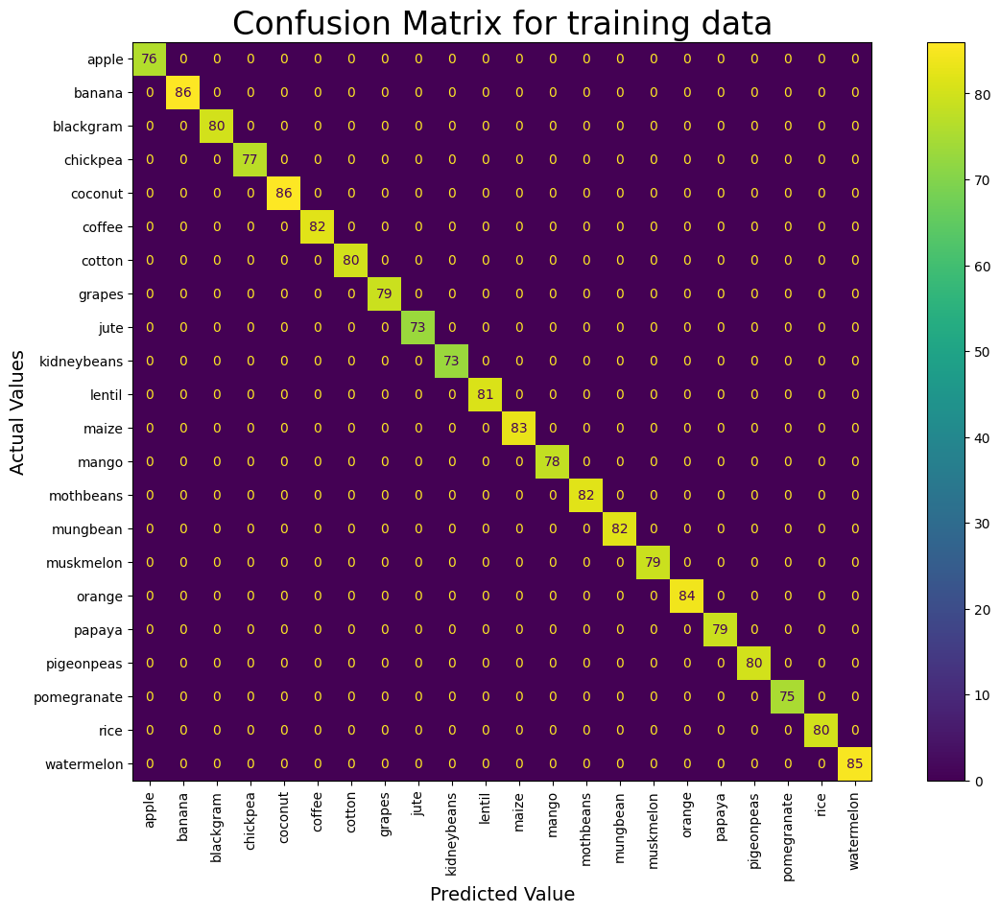

In [106]:
# Accuray On Test Data
xgb_predict_train = xgb_pipeline.predict(X_train)
xgb_accuracy_train = accuracy_score( y_train, xgb_predict_train )
print(f"Accuracy on Train Data: {xgb_accuracy_train * 100}%")
print("Precision on Training Data (Macro average): {:.2f} %".format(precision_score( y_train, xgb_predict_train, average = "macro") * 100) )
print("Recall on Training Data (Macro average): {:.2f} %".format(recall_score( y_train, xgb_predict_train, average = "macro") * 100) )
print("F1 score on Training Data (Macro average): {:.2f} %".format(f1_score(y_train,xgb_predict_train, average = "macro")*100))

# Visualising Confusion Matrix
cm = confusion_matrix(y_train, xgb_predict_train)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in xgb_pipeline.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for training data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

Accuracy on Test Data: 99.32 %
Precision on Test Data (Macro Average): 99.39 %
Recall on Test Data (Macro Average): 99.38 %
F1 score on Test Data (Macro Average): 99.38 %


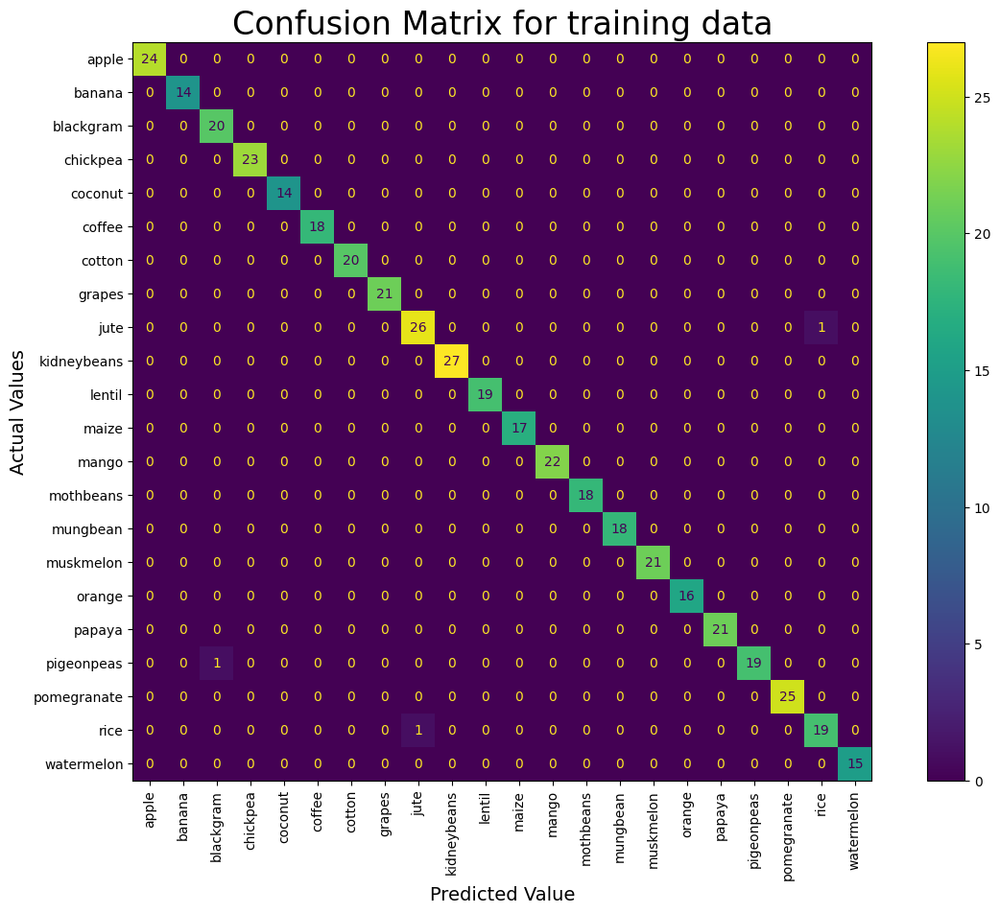

In [107]:
# Accuray On Test Data
xgb_predict_test = xgb_pipeline.predict(X_test)
xgb_accuracy = accuracy_score(y_test, xgb_predict_test)

print("Accuracy on Test Data: {:.2f} %".format(xgb_accuracy * 100))

# Precision on Testing Dataset
xgb_precision = precision_score(y_test, xgb_predict_test, average="macro")
print("Precision on Test Data (Macro Average): {:.2f} %".format(xgb_precision * 100))

# Recall on Testing Dataset
xgb_recall = recall_score(y_test, xgb_predict_test, average="macro")
print("Recall on Test Data (Macro Average): {:.2f} %".format(xgb_recall * 100))

# F1 score
xgb_f1 = f1_score(y_test, xgb_predict_test, average="macro")
print("F1 score on Test Data (Macro Average): {:.2f} %".format(xgb_f1 * 100))


# Visualising Confusion Matrix
cm = confusion_matrix(y_test, xgb_predict_test)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in xgb_pipeline.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for training data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()


### STORING ALL METRICS IN RESPECTIVE LISTS

In [108]:
accuracy = []
precision = []
recall = []
F1 = []
model_name = ["DECISION TREE","RANDOM FOREST","MULTINOMIAL LOGISTIC REGRESSION","SUPPORT VECTOR MACHINE(LINEAR KERNEL)","SUPPORT VECTOR MACHINE(POLYNOMIAL KERNEL)","SUPPORT VECTOR MACHINE(RBF KERNEL)","K-NEAREST NEIGHBOUR","CATEGORICAL NAIVE BAYES","XGBOOST"]
list1 = [decision_accuracy_test,random_accuracy,softmax_accuracy,svm_accuracy,polysvm_accuracy,rbf_accuracy,knn_accuracy,catnb_accuracy,xgb_accuracy]
list2 = [decision_precision,random_precision,softmax_precision,svm_precision,polysvm_precision,rbf_precision,knn_precision,catnb_precision,xgb_precision]
list3 = [decision_recall,random_recall,softmax_recall,svm_recall,polysvm_recall,rbf_recall,knn_recall,catnb_recall,xgb_recall]
list4 = [decision_f1,random_f1,softmax_f1,svm_f1,polysvm_f1,rbf_f1,knn_f1,catnb_f1,xgb_f1]

for i in list1:
    accuracy.append("{:.2f}".format(i * 100))
for i in list2:
    precision.append("{:.2f}".format(i * 100))
for i in list3:
    recall.append("{:.2f}".format(i * 100))
for i in list4:
    F1.append("{:.2f}".format(i * 100))


### COMPARISON BETWEEN ALL THE ALGORITHMS 

In [109]:
dftable = pd.DataFrame(columns=['ACCURACY', 'PRECISION','RECALL','F1-SCORE','MODEL'])
dftable['ACCURACY'] = accuracy
dftable['MODEL'] = model_name
dftable['PRECISION'] = precision
dftable['RECALL'] = recall
dftable['F1-SCORE'] = F1
dftable = dftable[['MODEL', 'ACCURACY','PRECISION','RECALL','F1-SCORE']]
dftable

,MODEL,ACCURACY,PRECISION,RECALL,F1-SCORE
0,DECISION TREE,91.82,94.29,93.16,91.93
1,RANDOM FOREST,99.77,99.78,99.68,99.72
2,MULTINOMIAL LOGISTIC REGRESSION,95.23,95.56,95.32,95.40
3,SUPPORT VECTOR MACHINE(LINEAR KERNEL),98.86,98.80,98.57,98.66
4,SUPPORT VECTOR MACHINE(POLYNOMIAL KERNEL),98.18,98.28,98.25,98.24
5,SUPPORT VECTOR MACHINE(RBF KERNEL),97.95,98.31,97.89,98.01
6,K-NEAREST NEIGHBOUR,97.95,97.84,97.90,97.80
7,CATEGORICAL NAIVE BAYES,98.18,98.13,98.26,98.14
8,XGBOOST,99.32,99.39,99.38,99.38


### VISUALISING THE RELATIONSHIP OF THE ALGORITHMS WITH ACCURACY, PRECISION AND RECALL VALUES

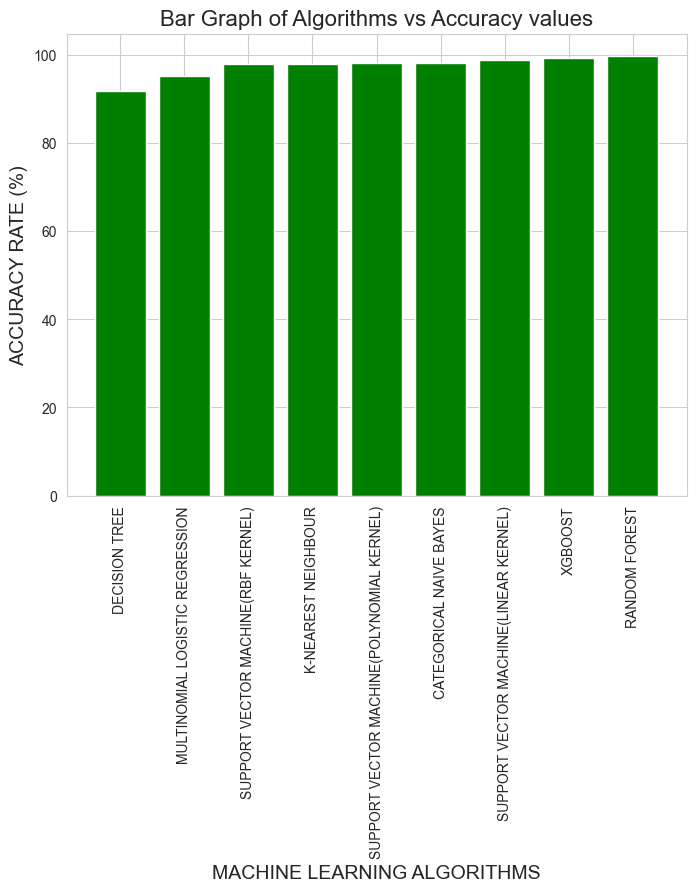

In [123]:
dftable = dftable.sort_values(by='ACCURACY', ascending=True)
plt.figure(figsize=(8, 6))
ax = sns.set_style('whitegrid')
plt.bar(dftable['MODEL'],dftable['ACCURACY'], color='green')
plt.xlabel('MACHINE LEARNING ALGORITHMS', fontsize=14)
plt.ylabel('ACCURACY RATE (%)', fontsize=14)
plt.title('Bar Graph of Algorithms vs Accuracy values', fontsize=16)

# Rotate x-axis labels for better readability
plt.xticks(rotation=90)

plt.show()

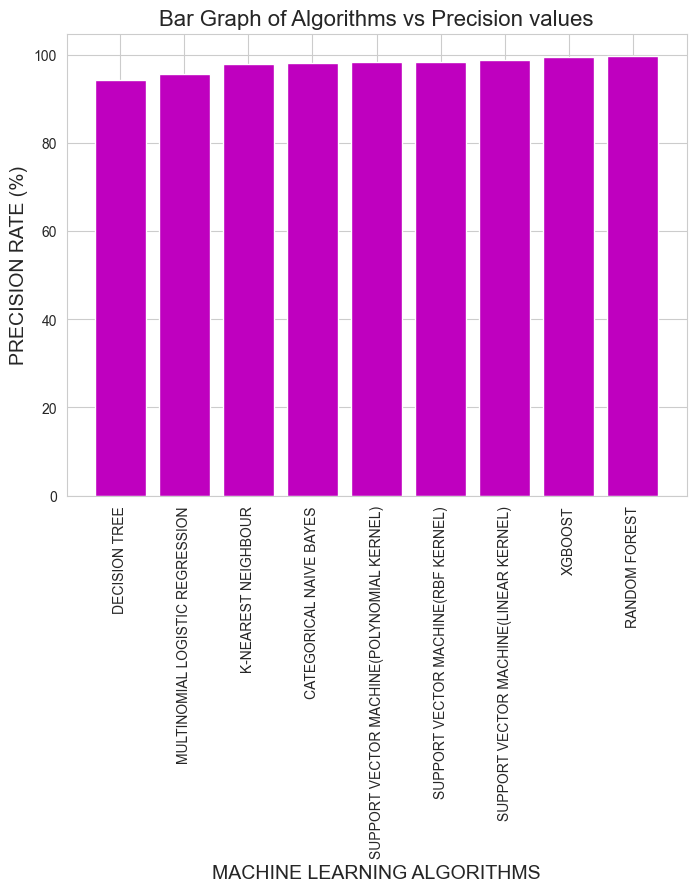

In [124]:
dftable = dftable.sort_values(by='PRECISION', ascending=True)
plt.figure(figsize=(8, 6))
ax = sns.set_style('whitegrid')
plt.bar(dftable['MODEL'],dftable['PRECISION'], color='m')
plt.xlabel('MACHINE LEARNING ALGORITHMS', fontsize=14)
plt.ylabel('PRECISION RATE (%)', fontsize=14)
plt.title('Bar Graph of Algorithms vs Precision values', fontsize=16)

# Rotate x-axis labels for better readability
plt.xticks(rotation=90)

plt.show()

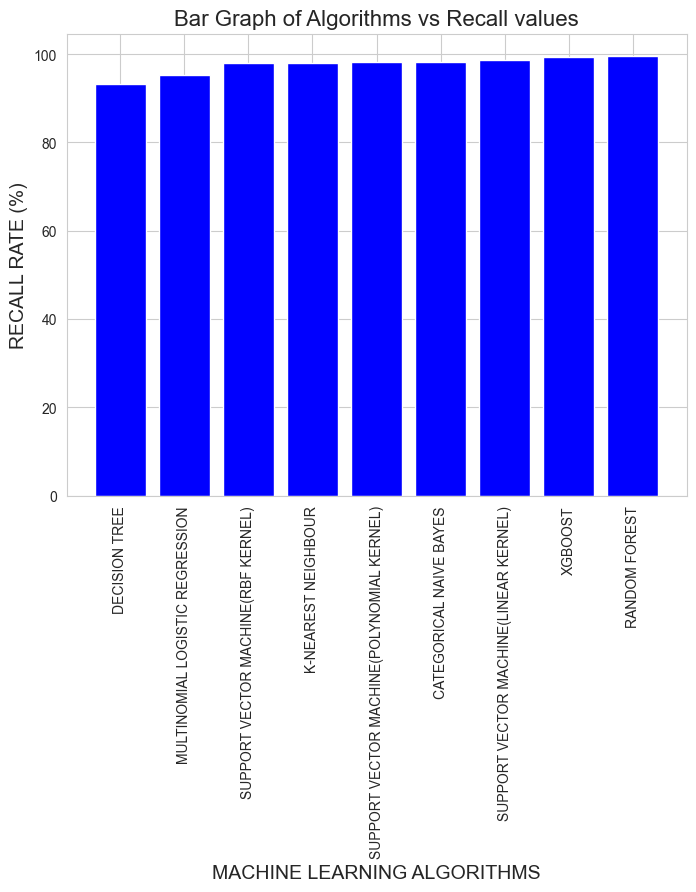

In [125]:
dftable = dftable.sort_values(by='RECALL', ascending=True)
plt.figure(figsize=(8, 6))
ax = sns.set_style('whitegrid')
plt.bar(dftable['MODEL'],dftable['RECALL'], color='blue')
plt.xlabel('MACHINE LEARNING ALGORITHMS', fontsize=14)
plt.ylabel('RECALL RATE (%)', fontsize=14)
plt.title('Bar Graph of Algorithms vs Recall values', fontsize=16)

# Rotate x-axis labels for better readability
plt.xticks(rotation=90)

plt.show()

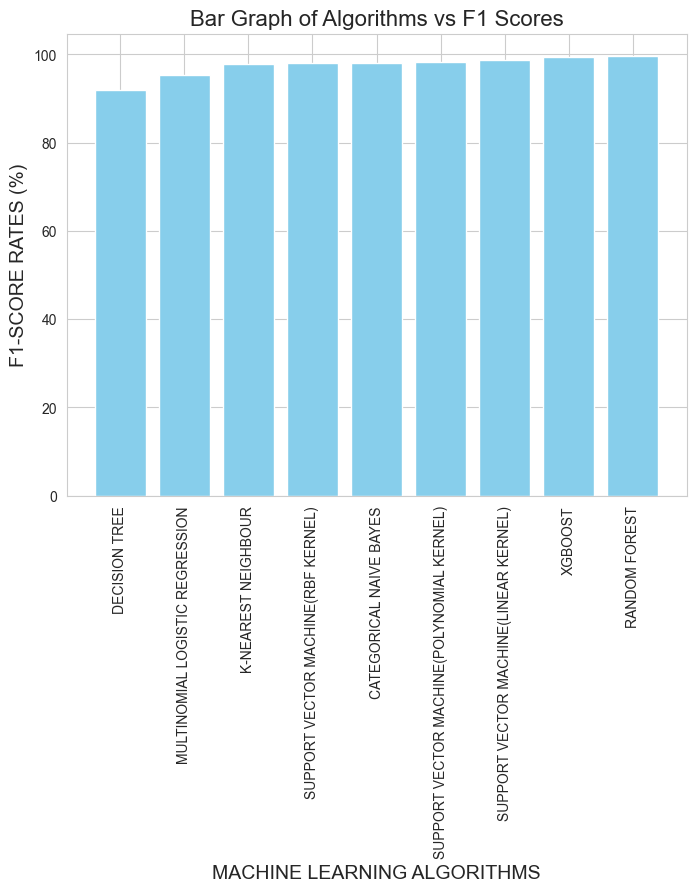

In [126]:
dftable = dftable.sort_values(by='F1-SCORE', ascending=True)
plt.figure(figsize=(8, 6))
ax = sns.set_style('whitegrid')
plt.bar(dftable['MODEL'],dftable['F1-SCORE'], color='skyblue')
plt.xlabel('MACHINE LEARNING ALGORITHMS', fontsize=14)
plt.ylabel('F1-SCORE RATES (%)', fontsize=14)
plt.title('Bar Graph of Algorithms vs F1 Scores', fontsize=16)

# Rotate x-axis labels for better readability
plt.xticks(rotation=90)

plt.show()

## SINCE RANDOM FOREST GIVES A HIGH SCORE IN ALL THE FOUR METRICS (ACCURACY, PRECISION, RECALL AND F1-SCORE) SO LET US USE RANDOM FOREST TO PREDICT THE CROP TYPE FOR NEW INSTANCES OF DATA


In [116]:
#### Taking user input
crop_num = int(input("ENTER THE NUMBER OF CROPS YOU WANT TO PREDICT:"))
columns = ['N', 'P', 'K', 'temperature', 'humidity', 'ph', 'rainfall']
data = []

for i in range(crop_num):
    user_input = [float(input(f"Enter the value for {col} for crop {i + 1}: ")) for col in columns]
    data.append(user_input)

# Creating a DataFrame from the collected data
df_user = pd.DataFrame(data, columns=columns)

ENTER THE NUMBER OF CROPS YOU WANT TO PREDICT: 10
Enter the value for N for crop 1:  90
Enter the value for P for crop 1:  88
Enter the value for K for crop 1:  95
Enter the value for temperature for crop 1:  25
Enter the value for humidity for crop 1:  89
Enter the value for ph for crop 1:  7
Enter the value for rainfall for crop 1:  126
Enter the value for N for crop 2:  2
Enter the value for P for crop 2:  99
Enter the value for K for crop 2:  65
Enter the value for temperature for crop 2:  19
Enter the value for humidity for crop 2:  99.6
Enter the value for ph for crop 2:  4
Enter the value for rainfall for crop 2:  230
Enter the value for N for crop 3:  99.6
Enter the value for P for crop 3:  65
Enter the value for K for crop 3:  3
Enter the value for temperature for crop 3:  12
Enter the value for humidity for crop 3:  99.99
Enter the value for ph for crop 3:  8
Enter the value for rainfall for crop 3:  100
Enter the value for N for crop 4:  45
Enter the value for P for crop 4: 

In [117]:
print("USER INPUT DATAFRAME")
df_user

USER INPUT DATAFRAME


,N,P,K,temperature,humidity,ph,rainfall
0,90.00,88.00,95.00,25.0,89.00,7.0,126.0
1,2.00,99.00,65.00,19.0,99.60,4.0,230.0
2,99.60,65.00,3.00,12.0,99.99,8.0,100.0
3,45.00,32.00,30.00,22.0,94.00,6.0,199.0
4,8.00,9.00,2.00,28.0,24.00,8.0,45.0
5,99.99,99.99,99.99,33.0,99.80,7.0,215.0
6,10.00,20.00,30.00,10.0,88.00,6.0,90.0
7,90.00,9.00,10.00,29.0,65.00,5.0,165.0
8,66.00,66.00,66.00,23.0,55.00,8.0,45.0
9,34.00,36.00,38.00,22.0,58.00,7.0,210.0


In [118]:
# PREDICTING THE CROP TYPES FOR EACH INSTANCE
predicted_labels = rf.predict(df_user)

# Decoding the predicted labels back to original labels
decoded_labels = labelencoder.inverse_transform(predicted_labels)

In [119]:
## SHOWING THE PREDICTIONS AS AN ADDITIONAL COLUMN IN THE DATAFRAME
df_user['predicted_crop'] = decoded_labels
df_user

,N,P,K,temperature,humidity,ph,rainfall,predicted_crop
0,90.00,88.00,95.00,25.0,89.00,7.0,126.0,banana
1,2.00,99.00,65.00,19.0,99.60,4.0,230.0,papaya
2,99.60,65.00,3.00,12.0,99.99,8.0,100.0,cotton
3,45.00,32.00,30.00,22.0,94.00,6.0,199.0,coconut
4,8.00,9.00,2.00,28.0,24.00,8.0,45.0,kidneybeans
5,99.99,99.99,99.99,33.0,99.80,7.0,215.0,papaya
6,10.00,20.00,30.00,10.0,88.00,6.0,90.0,pomegranate
7,90.00,9.00,10.00,29.0,65.00,5.0,165.0,coffee
8,66.00,66.00,66.00,23.0,55.00,8.0,45.0,chickpea
9,34.00,36.00,38.00,22.0,58.00,7.0,210.0,pigeonpeas
